In [13]:
# import sys
# print(sys.executable)
# print(sys.version)

# for Basemap to work in Python 3.8
import os
os.environ['PROJ_LIB'] = '/home/jlee/.conda/envs/mmc_sgp/share/proj'
# os.environ['PROJ_LIB'] = 'C:/Utilities/Python/Anaconda/Library/share'

import wrf
from netCDF4 import Dataset
import matplotlib.pyplot as plt
from matplotlib.cm import get_cmap
# from inspect import cleandoc as dedent
from mpl_toolkits.basemap import Basemap
import numpy as np
import pandas as pd
import xarray as xr
from numba import njit

from sklearn.decomposition import PCA

wrf_runs_dir = '/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/'
# wrf_runs_dir = '/Users/leec813/OneDrive - PNNL/Documents/mmc/sgp/data/0805_0901/a1_0805m_30s/'
nb_dir = !pwd
data_dir_df = pd.read_csv(nb_dir[0]+'/data-dir-j3leswrf.csv', index_col=0)
# plots_dir = nb_dir[0]+'/plots_06a'

# get specific dates associated w/ wrf runs
data_dir_df = pd.read_csv(nb_dir[0]+'/data-dir-j3leswrf.csv', index_col=0)

runs_list = list(data_dir_df.index)[:-1]

## WS PCA

In [3]:
def load_ws_ds(eval_date, run):

    date_col = data_dir_df[eval_date]

    # start and end UTC
    for ind, hr in enumerate(np.arange(14, 24, 1)): 

        for minute in np.arange(0, 60, 10):

            if minute == 0:
                minute = '00'
            else:
                minute = str(minute)

            file = wrf_runs_dir+date_col[run]+'/auxout/mmc_d04_'+eval_date+'_'+str(hr)+':'+minute+':00'
            wrf_single = Dataset(file, 'r')

            print(file)

            var = wrf.getvar(wrf_single, 'wspd_wdir', timeidx=wrf.ALL_TIMES)
            wspd = var['wspd_wdir' == 'wspd']

            if ind == 0 and minute == '00':
                var_all = wspd
                height = wrf.getvar(wrf_single, 'height_agl').mean(dim=['south_north', 'west_east'])
            else: 
                var_all = xr.concat([var_all, wspd], dim='Time')
    
    return var_all, height

In [35]:
def plot_pcline_5maps(eval_date, run, var_all, height):
    
    def plot_pc_map(i, ax, mode, pca_evr):

        bm = wrf.get_basemap(var_1time, ax=ax)

        if i == 0:
            bm.drawparallels(np.arange(36, 37, 0.05), labels=[1, 0, 0, 0])
        else:
            bm.drawparallels(np.arange(36, 37, 0.05), labels=[0, 0, 0, 0])

        bm.drawmeridians(np.arange(-98, -97, 0.05), labels=[0, 0, 0, 1])

        x, y = bm(wrf.to_np(lons), wrf.to_np(lats))

        p = bm.contourf(x, y, pcs[mode].reshape((var_at1h.sizes['south_north'], var_at1h.sizes['west_east'])), 
                        10, cmap=get_cmap('coolwarm'), vmin=v_min, vmax=v_max)

        evr = np.round((pca_evr * 100), 2)
#         print(evr)
        ax.set_title('PC'+str(mode+1)+': '+str(evr)+'%')

        c1x, c1y = bm(wrf.to_np(-97.487643), wrf.to_np(36.607322))
        bm.scatter(c1x, c1y, s=80, marker='x', color='black', linewidth=3, ax=ax)

    #     c1x, c1y = bm(wrf.to_np(-97.493), wrf.to_np(36.613))
    #     ax.annotate('C1', xy=(c1x, c1y), size=15, color='white')

    mode_list = [0, 3, 7, 11, 19]
#     mode_list = [0, 20]

    for hr in np.arange(14, 24, 1):

        hr = str(hr)

        for hgt_i in [3, 16, 25, 45]:

            height_str = str(int(height[hgt_i].values))

            var_1hrah = var_all.sel(Time=slice(eval_date+'T'+hr, eval_date+'T'+hr))

            var_at1h = var_1hrah[:, hgt_i, :, :]

            var_at1h_df = var_at1h.drop_vars('wspd_wdir').to_dataframe()

            timeloc_df = pd.pivot_table(var_at1h_df, values='wspd_wdir', 
                                        index=['Time'], columns=['south_north', 'west_east'])

            pca = PCA()
            pca.fit(timeloc_df)
            pcs = pca.components_
            
            pca_evr = pca.explained_variance_ratio_
#             print(pca_evr)

            plt.plot(pca_evr)
            plt.ylabel('% of variance explained')
            plt.xlabel('PC or POD mode')
            plt.title(run+': '+hr+' UTC - PCA of wind speed at '+height_str+' m agl')
            plt.show()

            lats, lons = wrf.latlon_coords(var_all)

            fig, ax = plt.subplots(1, 5, figsize=(12, 6))

            time_list = var_at1h['Time'].values
            time = time_list[0]
            var_1time = var_at1h.sel(Time=time)

            v_min = pca.components_[mode_list].min()
            v_max = pca.components_[mode_list].max()

            for i, _ in enumerate(mode_list): 
                plot_pc_map(i, ax[i], mode_list[i], pca_evr[mode_list[i]])

            cax = plt.axes([0.25, 0.18, 0.5, 0.04])
            sm = plt.cm.ScalarMappable(cmap='coolwarm', norm=plt.Normalize(vmin=v_min, vmax=v_max))
            cb = plt.colorbar(sm, cax=cax, orientation='horizontal', label='PC')

            plt.suptitle(run+': '+hr+' UTC - PCA of wind speed at '+height_str+' m agl', y=0.8)

            plt.show()

In [33]:
eval_date = '2018-08-05'
run = 'mynn'
ws_all_mynn, height_mynn = load_ws_ds(eval_date, run)

/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/a1_0805m_30s/auxout/mmc_d04_2018-08-05_14:00:00
/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/a1_0805m_30s/auxout/mmc_d04_2018-08-05_14:10:00
/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/a1_0805m_30s/auxout/mmc_d04_2018-08-05_14:20:00
/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/a1_0805m_30s/auxout/mmc_d04_2018-08-05_14:30:00
/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/a1_0805m_30s/auxout/mmc_d04_2018-08-05_14:40:00
/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/a1_0805m_30s/auxout/mmc_d04_2018-08-05_14:50:00
/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/a1_0805m_30s/auxout/mmc_d04_2018-08-05_15:00:00
/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/a1_0805m_30s/auxout/mmc_d04_2018-08-05_15:10:00
/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/a1_0805m_30s/auxout/mmc_d04_2018-08-05_15:20:00
/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/a1_0805m_30s/auxout/mmc_d04_2018-08-05_15:30:00
/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/a1_0805m_30s/auxout/mmc_d04_2018-08-05_15:40:00
/projects/mmc/jlee/sgp/wrf-mmc/w

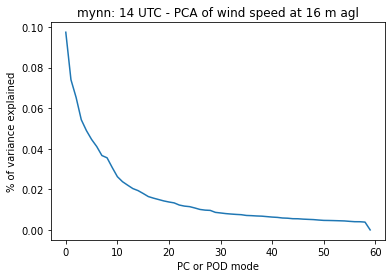

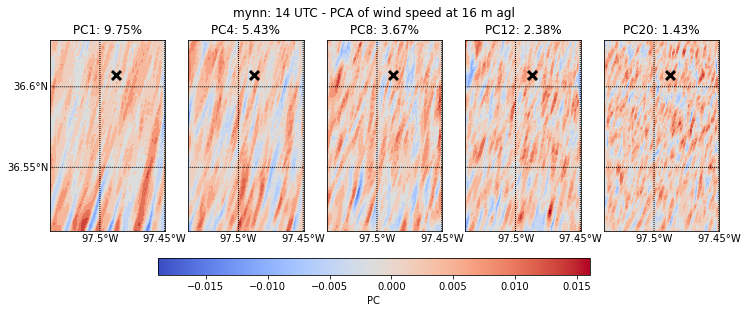

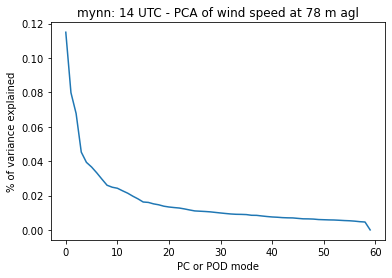

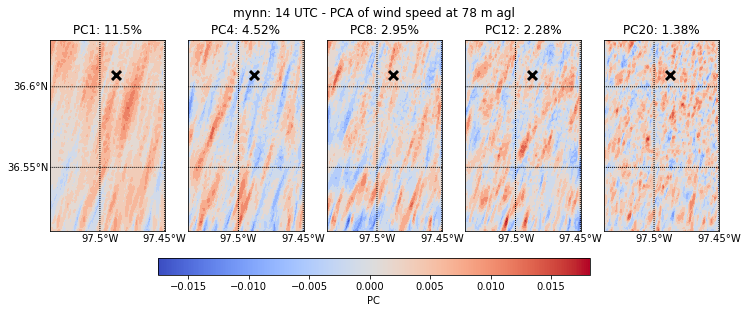

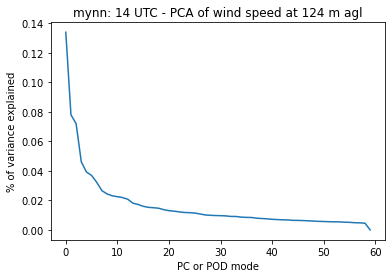

...

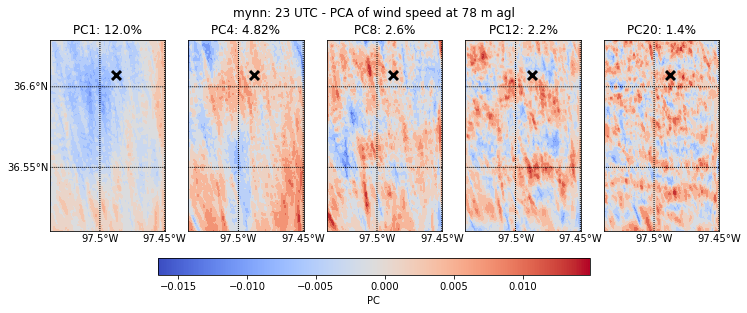

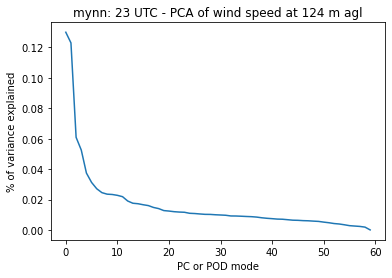

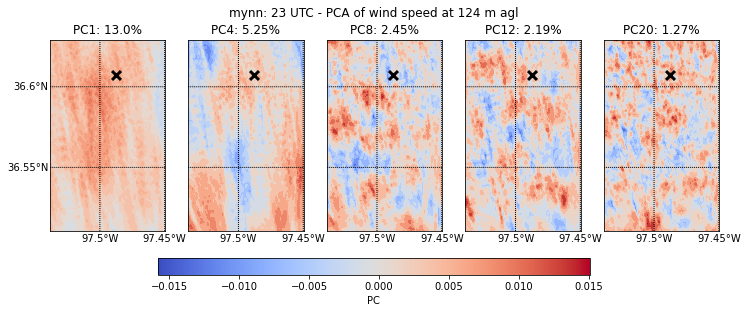

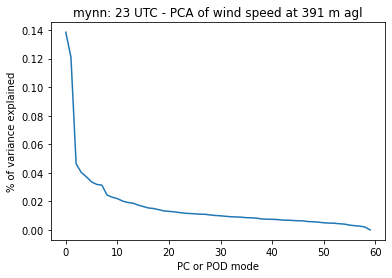

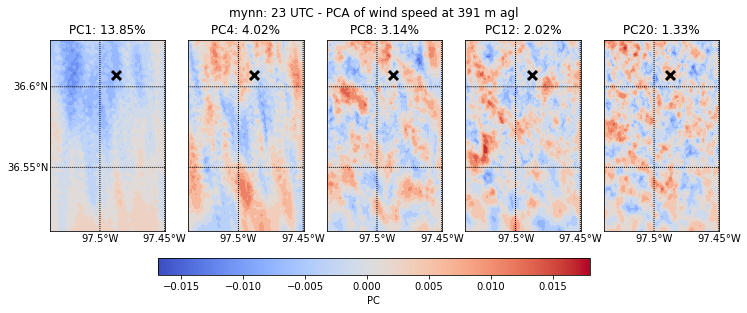

In [36]:
plot_pcline_5maps(eval_date, run, ws_all_mynn, height_mynn)

In [6]:
eval_date = '2018-08-05'
run = 'edmf'
ws_all_edmf, height_edmf = load_ws_ds(eval_date, run)

/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/a2_0805e_30s/auxout/mmc_d04_2018-08-05_14:00:00
/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/a2_0805e_30s/auxout/mmc_d04_2018-08-05_14:10:00
/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/a2_0805e_30s/auxout/mmc_d04_2018-08-05_14:20:00
/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/a2_0805e_30s/auxout/mmc_d04_2018-08-05_14:30:00
/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/a2_0805e_30s/auxout/mmc_d04_2018-08-05_14:40:00
/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/a2_0805e_30s/auxout/mmc_d04_2018-08-05_14:50:00
/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/a2_0805e_30s/auxout/mmc_d04_2018-08-05_15:00:00
/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/a2_0805e_30s/auxout/mmc_d04_2018-08-05_15:10:00
/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/a2_0805e_30s/auxout/mmc_d04_2018-08-05_15:20:00
/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/a2_0805e_30s/auxout/mmc_d04_2018-08-05_15:30:00
/projects/mmc/jlee/sgp/wrf-mmc/wrf-runs/a2_0805e_30s/auxout/mmc_d04_2018-08-05_15:40:00
/projects/mmc/jlee/sgp/wrf-mmc/w

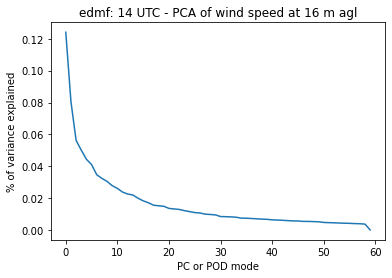

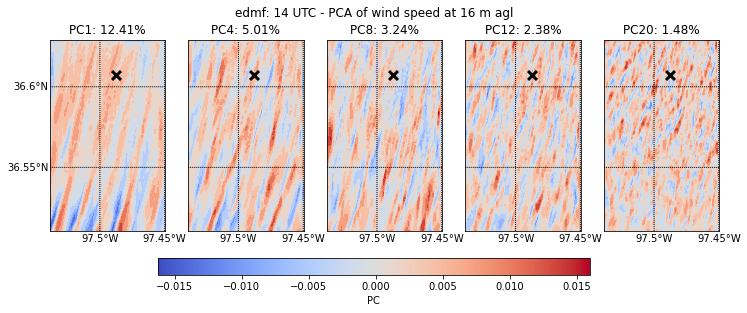

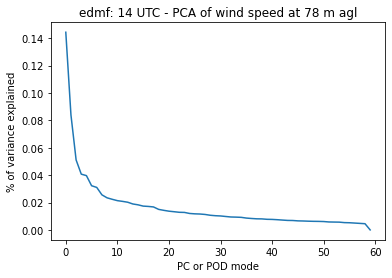

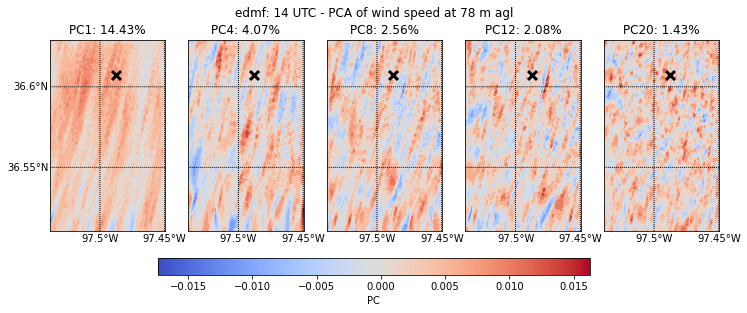

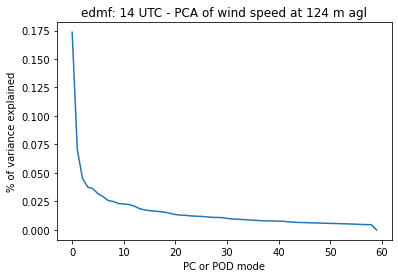

...

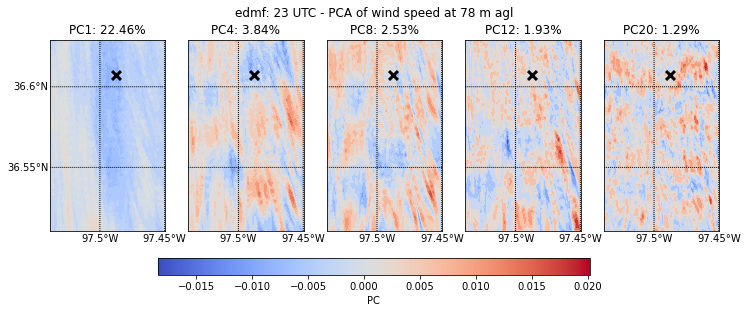

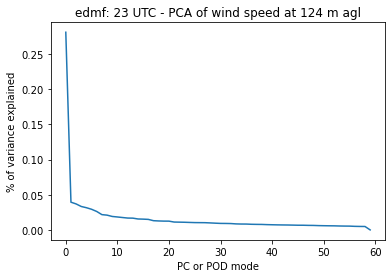

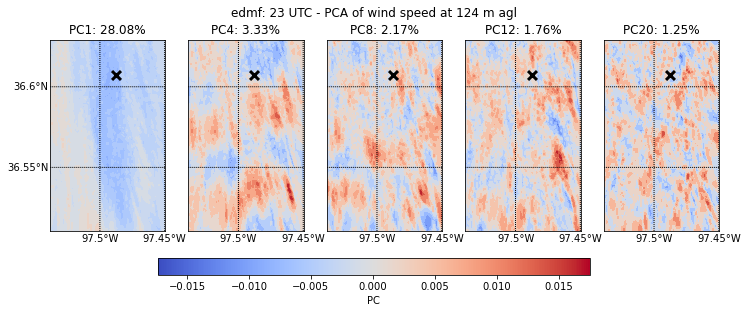

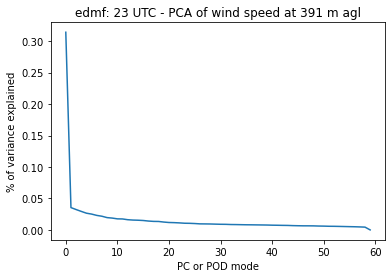

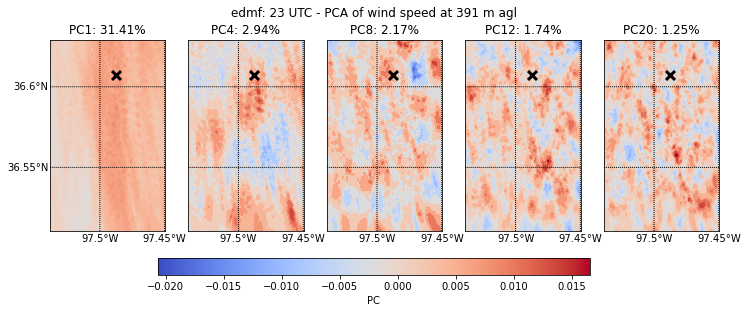

In [38]:
run = 'edmf'
plot_pcline_5maps(eval_date, run, ws_all_edmf, height_edmf)

In [66]:
def plot_pcline_5maps_allt(eval_date, run, var_all, height):
    
    def plot_pc_map(i, ax, mode, pca_evr):

        bm = wrf.get_basemap(var_1time, ax=ax)

        if i == 0:
            bm.drawparallels(np.arange(36, 37, 0.05), labels=[1, 0, 0, 0])
        else:
            bm.drawparallels(np.arange(36, 37, 0.05), labels=[0, 0, 0, 0])

        bm.drawmeridians(np.arange(-98, -97, 0.05), labels=[0, 0, 0, 1])

        x, y = bm(wrf.to_np(lons), wrf.to_np(lats))

        p = bm.contourf(x, y, pcs[mode].reshape((var_at1h.sizes['south_north'], var_at1h.sizes['west_east'])), 
                        10, cmap=get_cmap('coolwarm'), vmin=v_min, vmax=v_max)

        evr = np.round((pca_evr * 100), 2)
#         print(evr)
        ax.set_title('PC'+str(mode+1)+': '+str(evr)+'%')

        c1x, c1y = bm(wrf.to_np(-97.487643), wrf.to_np(36.607322))
        bm.scatter(c1x, c1y, s=80, marker='x', color='black', linewidth=3, ax=ax)

    #     c1x, c1y = bm(wrf.to_np(-97.493), wrf.to_np(36.613))
    #     ax.annotate('C1', xy=(c1x, c1y), size=15, color='white')

    mode_list = [0, 3, 7, 11, 19]
#     mode_list = [0, 3]
    
    evr_df = pd.DataFrame()

    for hgt_i in [3, 16, 25, 45]:
#     for hgt_i in [3, 16]:

        height_str = str(int(height[hgt_i].values))

#             var_1hrah = var_all.sel(Time=slice(eval_date+'T'+hr, eval_date+'T'+hr))
#             var_at1h = var_1hrah[:, hgt_i, :, :]

        var_at1h = var_all[:, hgt_i, :, :]

        var_at1h_df = var_at1h.drop_vars('wspd_wdir').to_dataframe()

        timeloc_df = pd.pivot_table(var_at1h_df, values='wspd_wdir', 
                                    index=['Time'], columns=['south_north', 'west_east'])

        pca = PCA()
        pca.fit(timeloc_df)
        pcs = pca.components_

        pca_evr = pca.explained_variance_ratio_
#             print(pca_evr)

        evr_df[height_str] = pca_evr
#         print(evr_df)

        plt.plot(pca_evr)
        plt.ylabel('% of variance explained')
        plt.xlabel('PC or POD mode')
        plt.title(run+': 14 to 23 UTC - PCA of wind speed at '+height_str+' m agl')
        plt.show()

        lats, lons = wrf.latlon_coords(var_all)

        fig, ax = plt.subplots(1, 5, figsize=(12, 6))

        time_list = var_at1h['Time'].values
        time = time_list[0]
        var_1time = var_at1h.sel(Time=time)

        v_min = pca.components_[mode_list].min()
        v_max = pca.components_[mode_list].max()

        for i, _ in enumerate(mode_list): 
            plot_pc_map(i, ax[i], mode_list[i], pca_evr[mode_list[i]])

        cax = plt.axes([0.25, 0.18, 0.5, 0.04])
        sm = plt.cm.ScalarMappable(cmap='coolwarm', norm=plt.Normalize(vmin=v_min, vmax=v_max))
        cb = plt.colorbar(sm, cax=cax, orientation='horizontal', label='PC')

        plt.suptitle(run+': 14 to 23 UTC - PCA of wind speed at '+height_str+' m agl', y=0.8)

        plt.show()
        
    return evr_df

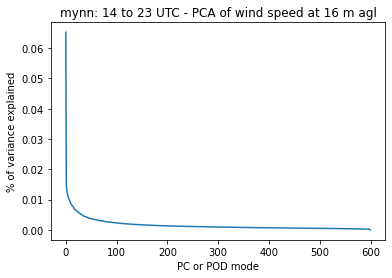

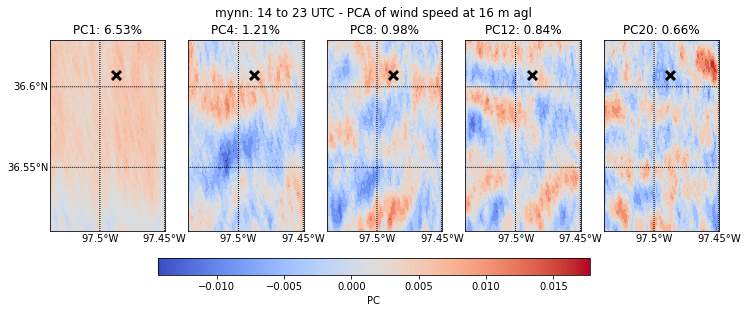

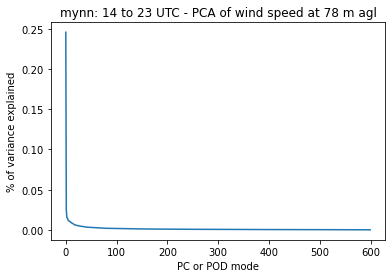

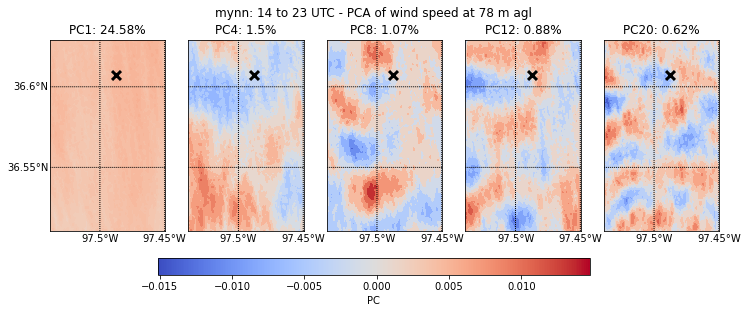

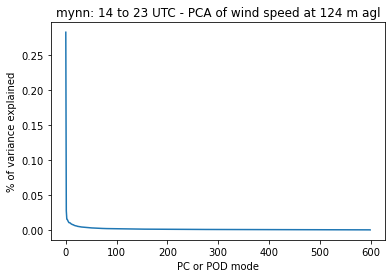

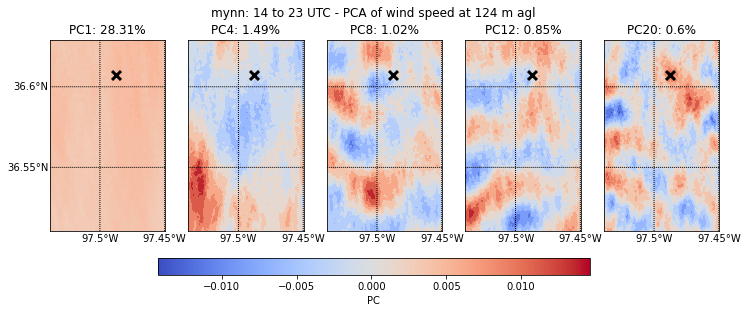

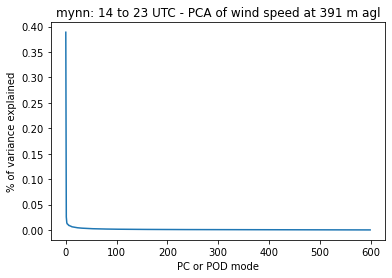

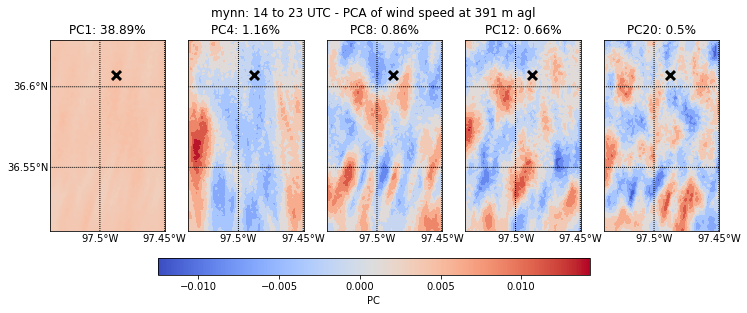

In [67]:
evr_df_mynn = plot_pcline_5maps_allt(eval_date, 'mynn', ws_all_mynn, height_mynn)

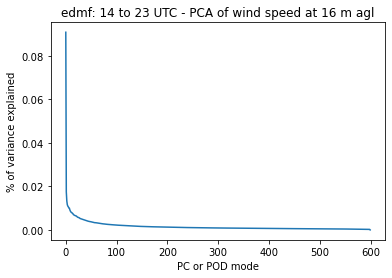

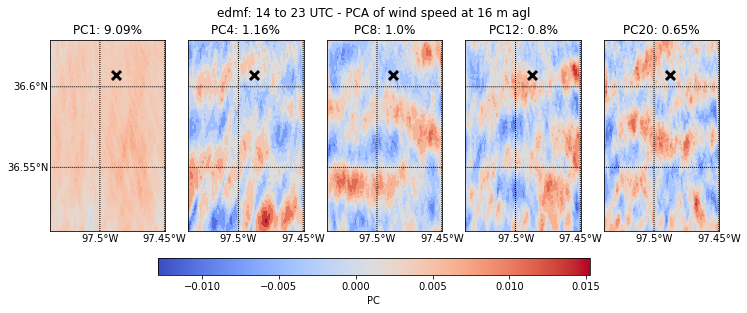

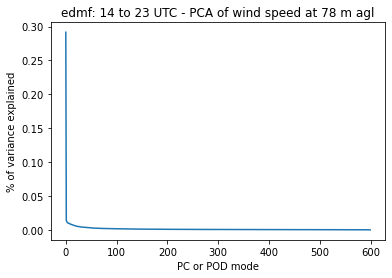

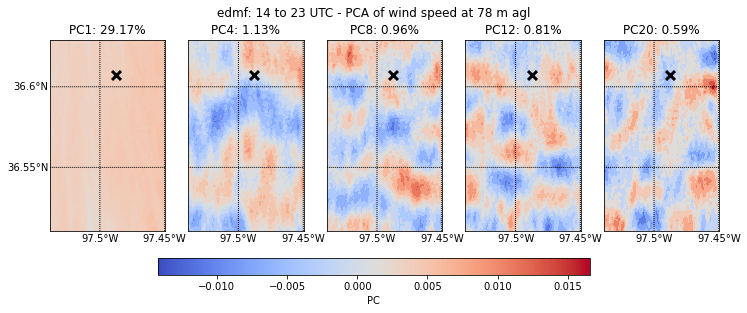

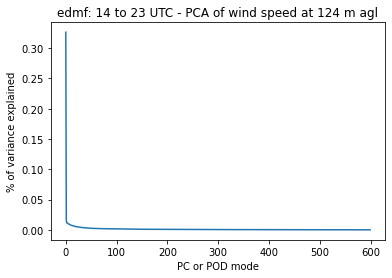

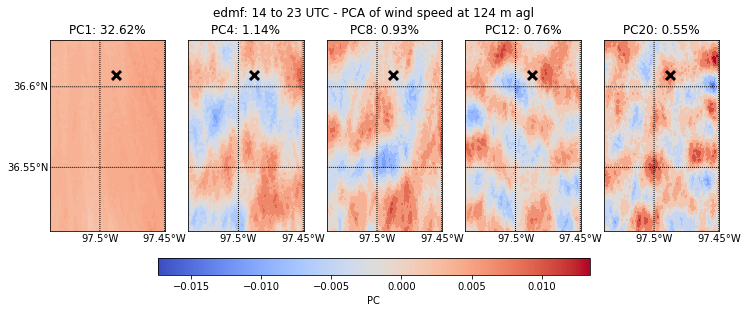

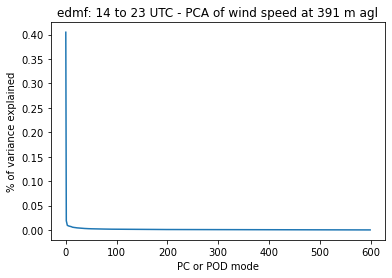

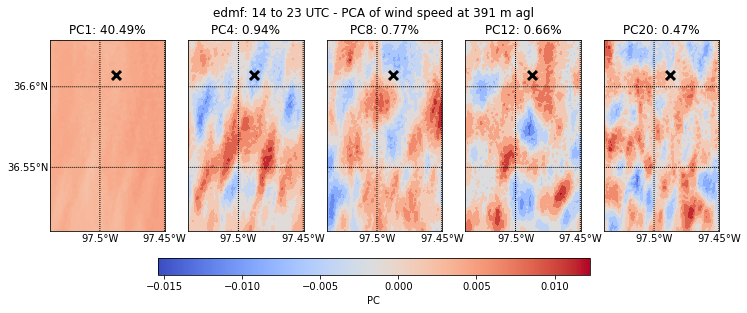

In [68]:
evr_df_edmf = plot_pcline_5maps_allt(eval_date, 'edmf', ws_all_edmf, height_edmf)

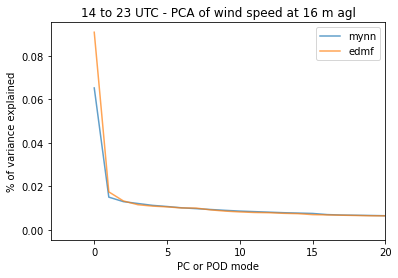

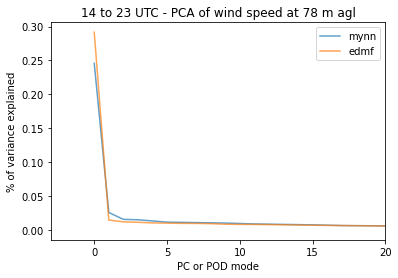

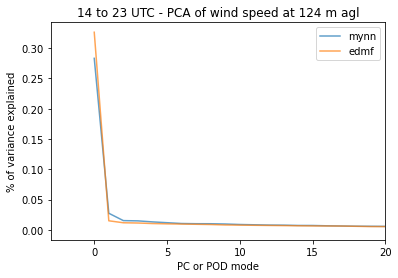

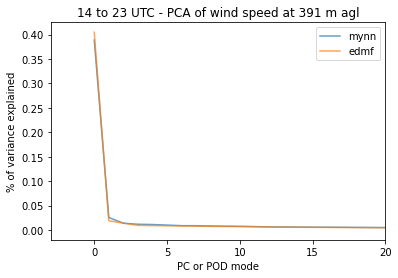

In [80]:
for hgt in evr_df_mynn.columns:

    al_pha = 0.7
    
    plt.plot(evr_df_mynn[hgt], label='mynn', alpha=al_pha)
    plt.plot(evr_df_edmf[hgt], label='edmf', alpha=al_pha)
    
    plt.ylabel('% of variance explained')
    plt.xlabel('PC or POD mode')
    plt.title('14 to 23 UTC - PCA of wind speed at '+hgt+' m agl')

    plt.xlim(-3, 20)
    #     plt.xscale('log')
    #     plt.yscale('log')

    plt.legend()
    
    plt.show()

In [85]:
def plot_pcline_5maps_selectt(eval_date, run, var_all, height):
    
    def plot_pc_map(i, ax, mode, pca_evr):

        bm = wrf.get_basemap(var_1time, ax=ax)

        if i == 0:
            bm.drawparallels(np.arange(36, 37, 0.05), labels=[1, 0, 0, 0])
        else:
            bm.drawparallels(np.arange(36, 37, 0.05), labels=[0, 0, 0, 0])

        bm.drawmeridians(np.arange(-98, -97, 0.05), labels=[0, 0, 0, 1])

        x, y = bm(wrf.to_np(lons), wrf.to_np(lats))

        p = bm.contourf(x, y, pcs[mode].reshape((var_at1h.sizes['south_north'], var_at1h.sizes['west_east'])), 
                        10, cmap=get_cmap('coolwarm'), vmin=v_min, vmax=v_max)

        evr = np.round((pca_evr * 100), 2)
#         print(evr)
        ax.set_title('PC'+str(mode+1)+': '+str(evr)+'%')

        c1x, c1y = bm(wrf.to_np(-97.487643), wrf.to_np(36.607322))
        bm.scatter(c1x, c1y, s=80, marker='x', color='black', linewidth=3, ax=ax)

    #     c1x, c1y = bm(wrf.to_np(-97.493), wrf.to_np(36.613))
    #     ax.annotate('C1', xy=(c1x, c1y), size=15, color='white')

    mode_list = [0, 3, 7, 11, 19]
#     mode_list = [0, 3]
    
    evr_df = pd.DataFrame()

    for hgt_i in [3, 16, 25, 45]:
#     for hgt_i in [3, 16]:

        height_str = str(int(height[hgt_i].values))

        var_1hrah = var_all.sel(Time=slice(eval_date+'T16', eval_date+'T20'))
#         print(var_1hrah.Time)
        var_at1h = var_1hrah[:, hgt_i, :, :]

        var_at1h_df = var_at1h.drop_vars('wspd_wdir').to_dataframe()

        timeloc_df = pd.pivot_table(var_at1h_df, values='wspd_wdir', 
                                    index=['Time'], columns=['south_north', 'west_east'])

        pca = PCA()
        pca.fit(timeloc_df)
        pcs = pca.components_

        pca_evr = pca.explained_variance_ratio_
#             print(pca_evr)

        evr_df[height_str] = pca_evr
#         print(evr_df)

        plt.plot(pca_evr)
        plt.ylabel('% of variance explained')
        plt.xlabel('PC or POD mode')
        plt.title(run+': 16 to 21 UTC - PCA of wind speed at '+height_str+' m agl')
        plt.show()

        lats, lons = wrf.latlon_coords(var_all)

        fig, ax = plt.subplots(1, 5, figsize=(12, 6))

        time_list = var_at1h['Time'].values
        time = time_list[0]
        var_1time = var_at1h.sel(Time=time)

        v_min = pca.components_[mode_list].min()
        v_max = pca.components_[mode_list].max()

        for i, _ in enumerate(mode_list): 
            plot_pc_map(i, ax[i], mode_list[i], pca_evr[mode_list[i]])

        cax = plt.axes([0.25, 0.18, 0.5, 0.04])
        sm = plt.cm.ScalarMappable(cmap='coolwarm', norm=plt.Normalize(vmin=v_min, vmax=v_max))
        cb = plt.colorbar(sm, cax=cax, orientation='horizontal', label='PC')

        plt.suptitle(run+': 16 to 21 UTC - PCA of wind speed at '+height_str+' m agl', y=0.8)

        plt.show()
        
    return evr_df

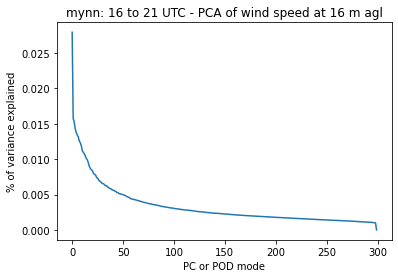

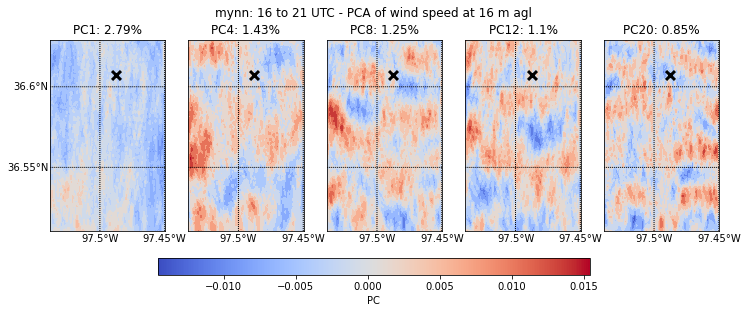

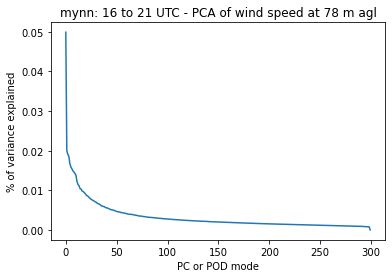

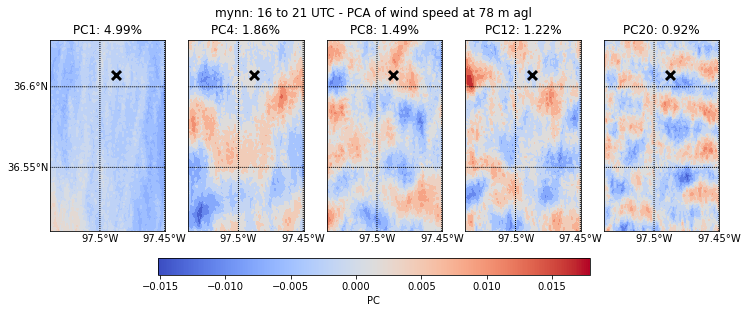

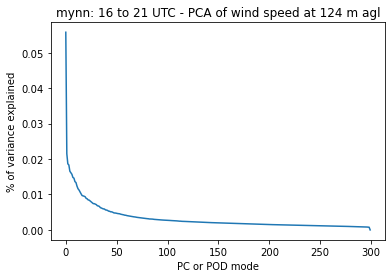

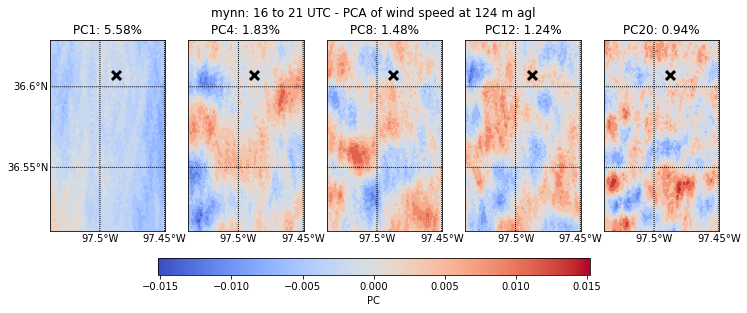

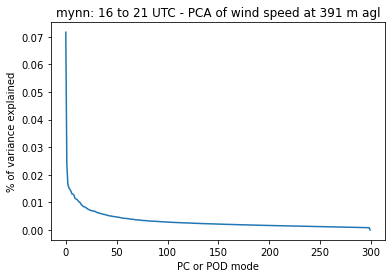

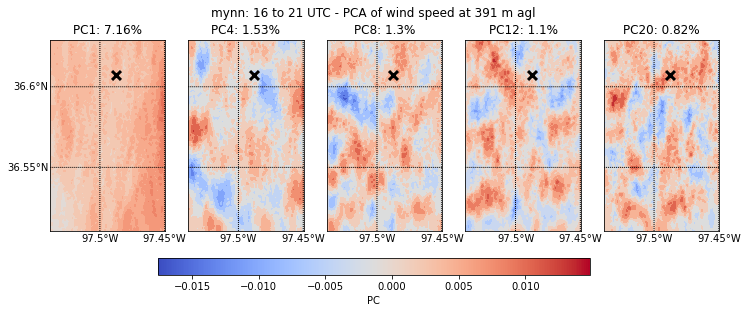

In [86]:
evr_df_selt_mynn = plot_pcline_5maps_selectt(eval_date, 'mynn', ws_all_mynn, height_mynn)

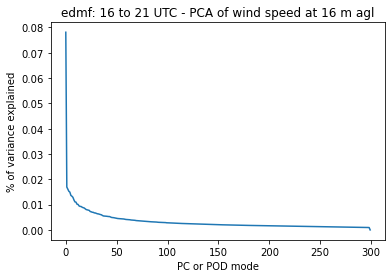

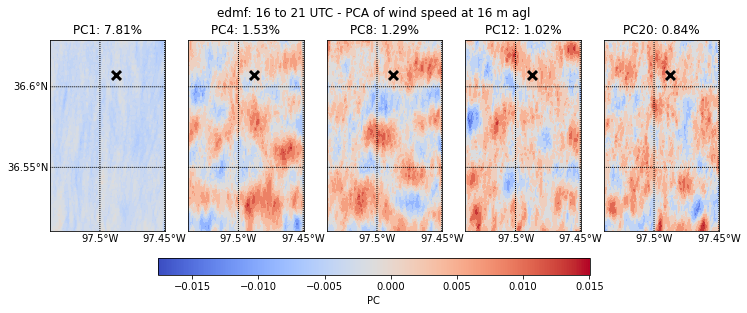

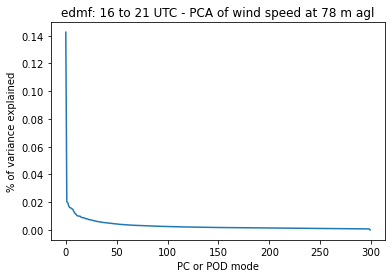

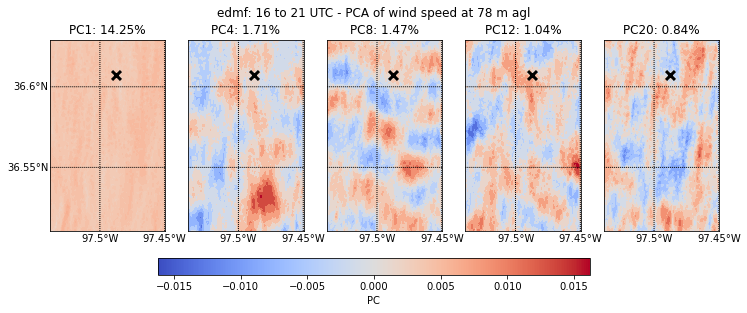

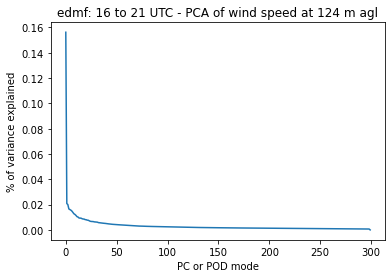

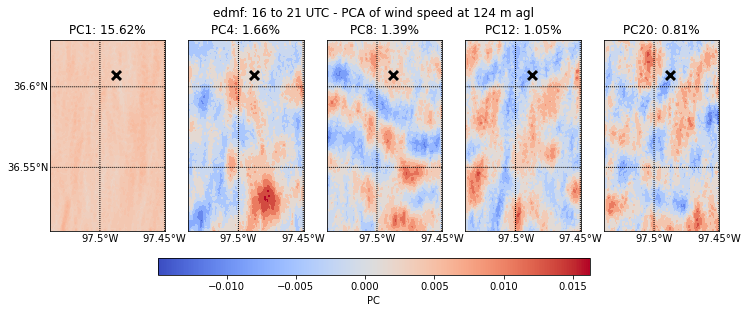

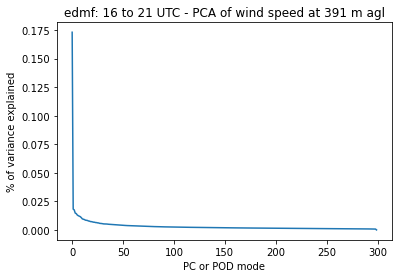

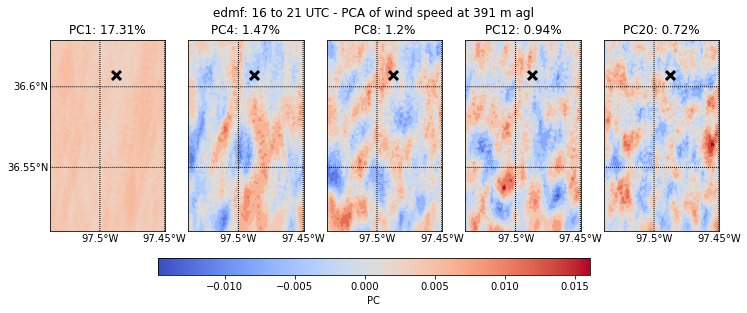

In [87]:
evr_df_selt_edmf = plot_pcline_5maps_selectt(eval_date, 'edmf', ws_all_edmf, height_edmf)

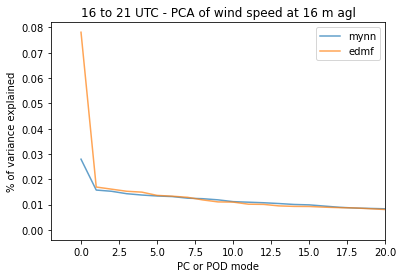

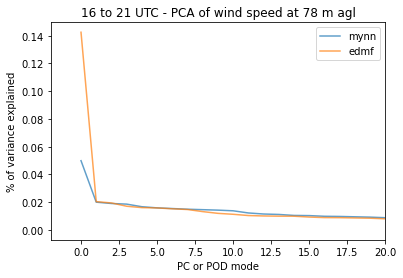

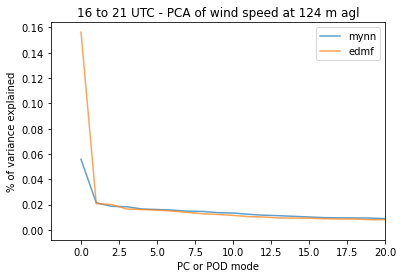

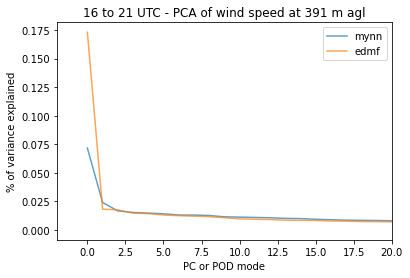

In [90]:
for hgt in evr_df_mynn.columns:

    al_pha = 0.7
    
    plt.plot(evr_df_selt_mynn[hgt], label='mynn', alpha=al_pha)
    plt.plot(evr_df_selt_edmf[hgt], label='edmf', alpha=al_pha)
    
    plt.ylabel('% of variance explained')
    plt.xlabel('PC or POD mode')
    plt.title('16 to 21 UTC - PCA of wind speed at '+hgt+' m agl')

    plt.xlim(-2, 20)
    #     plt.xscale('log')
    #     plt.yscale('log')

    plt.legend()
    
    plt.show()

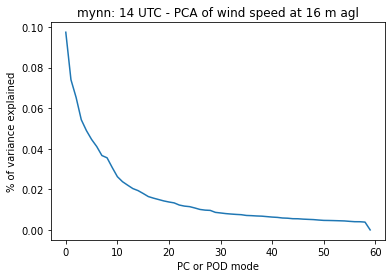

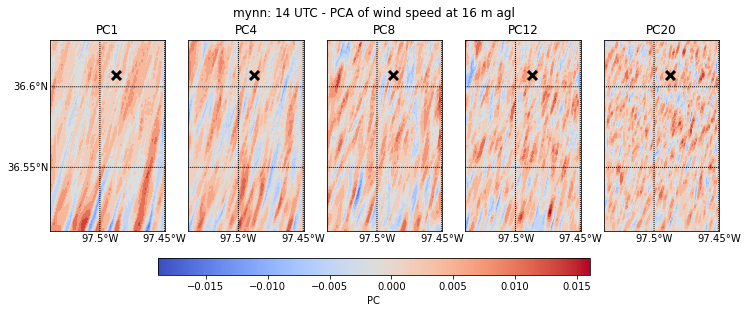

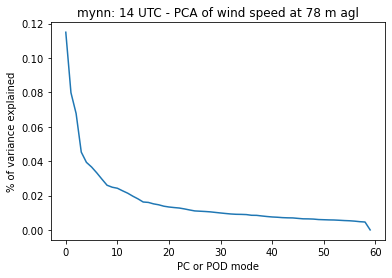

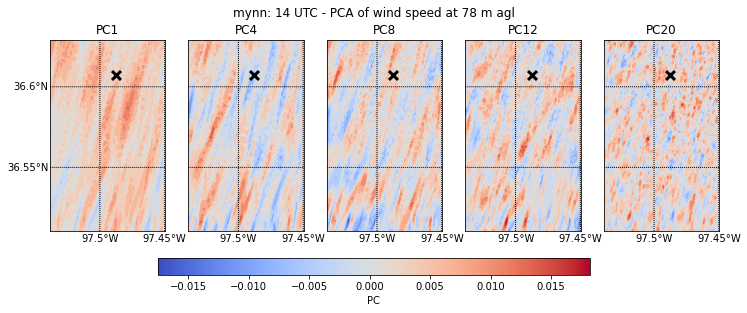

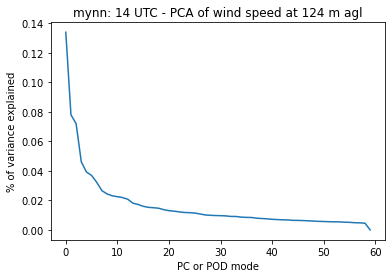

...

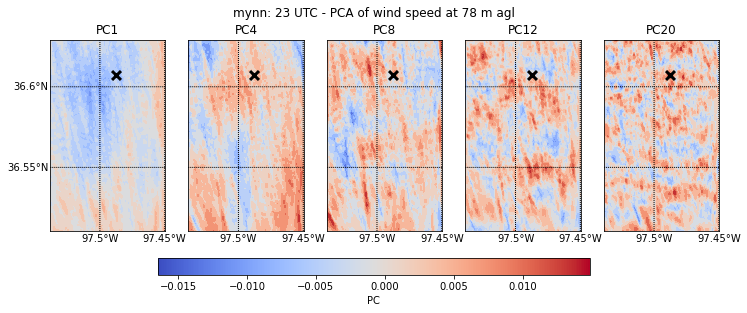

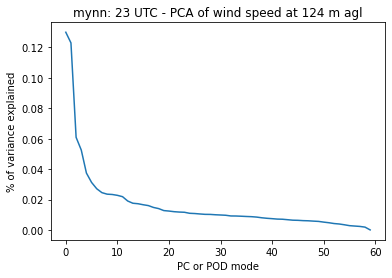

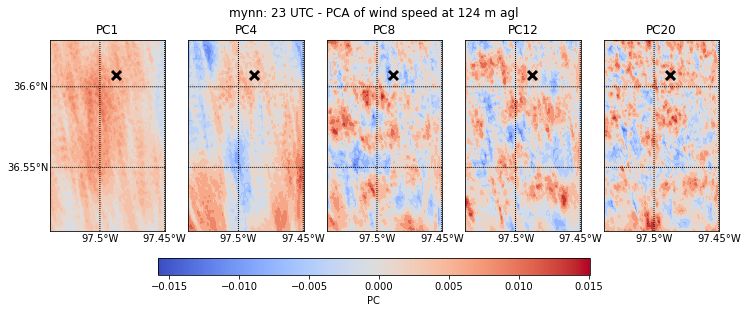

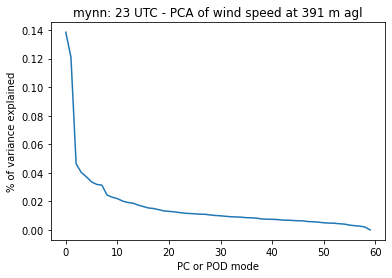

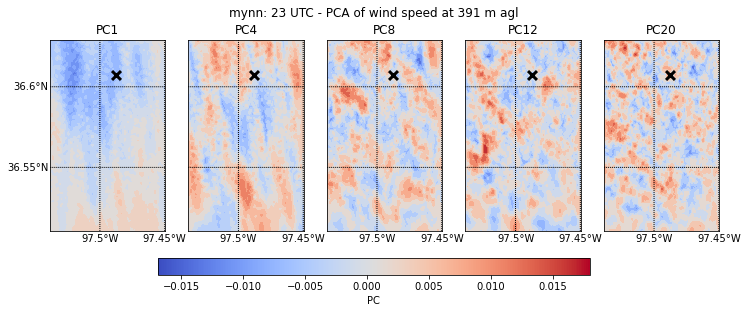

In [11]:
mode_list = [0, 3, 7, 11, 19]
# mode_list = [0, 20]

for hr in np.arange(14, 24, 1):

    hr = str(hr)

    for hgt_i in [3, 16, 25, 45]:

        height_str = str(int(height[hgt_i].values))
    
        var_1hrah = var_all.sel(Time=slice(eval_date+'T'+hr, eval_date+'T'+hr))

        var_at1h = var_1hrah[:, hgt_i, :, :]

        var_at1h_df = var_at1h.drop_vars('wspd_wdir').to_dataframe()

        timeloc_df = pd.pivot_table(var_at1h_df, values='wspd_wdir', 
                                    index=['Time'], columns=['south_north', 'west_east'])

        pca = PCA()
        pca.fit(timeloc_df)
        pcs = pca.components_

        plt.plot(pca.explained_variance_ratio_)
        plt.ylabel('% of variance explained')
        plt.xlabel('PC or POD mode')
        plt.title(run+': '+hr+' UTC - PCA of wind speed at '+height_str+' m agl')
        plt.show()

        lats, lons = wrf.latlon_coords(var)

        fig, ax = plt.subplots(1, 5, figsize=(12, 6))

        time_list = var_at1h['Time'].values
        time = time_list[0]
        var_1time = var_at1h.sel(Time=time)

        v_min = pca.components_[mode_list].min()
        v_max = pca.components_[mode_list].max()

        for i, _ in enumerate(mode_list): 
            plot_pc_map(i, ax[i], mode_list[i])

        cax = plt.axes([0.25, 0.18, 0.5, 0.04])
        sm = plt.cm.ScalarMappable(cmap='coolwarm', norm=plt.Normalize(vmin=v_min, vmax=v_max))
        cb = plt.colorbar(sm, cax=cax, orientation='horizontal', label='PC')

        plt.suptitle(run+': '+hr+' UTC - PCA of wind speed at '+height_str+' m agl', y=0.8)

        plt.show()

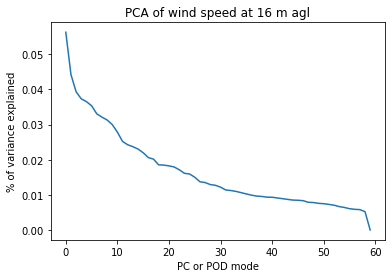

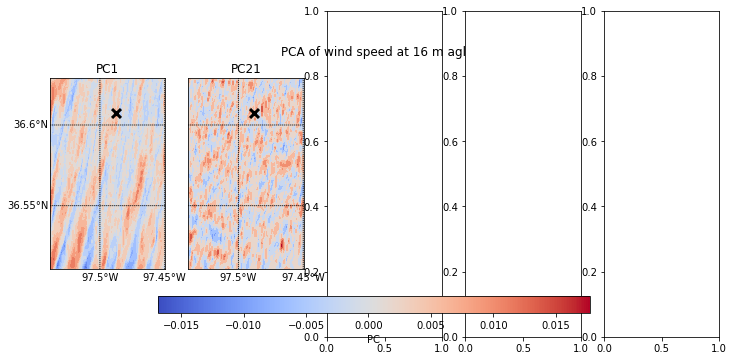

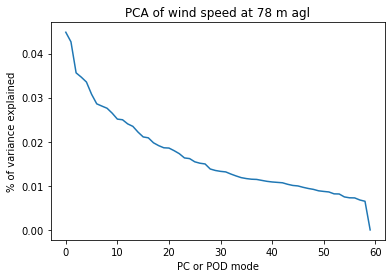

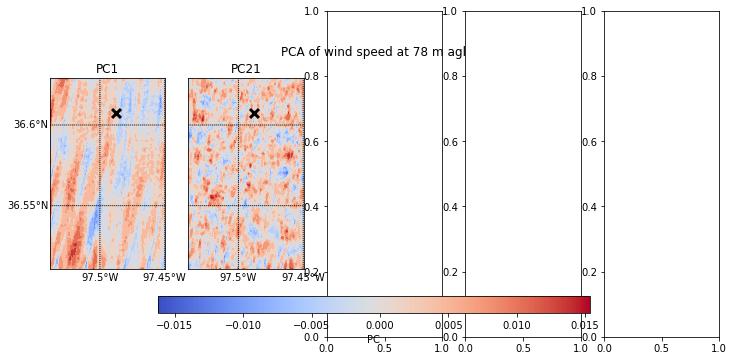

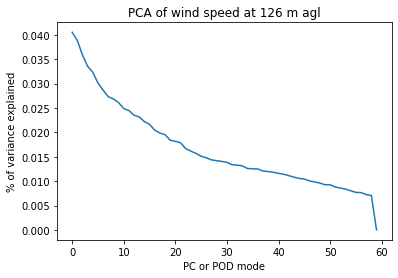

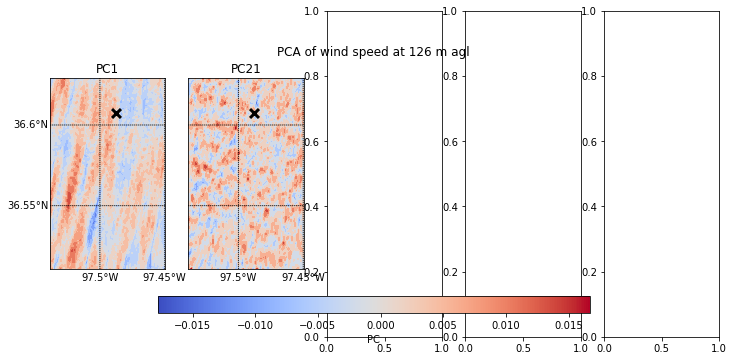

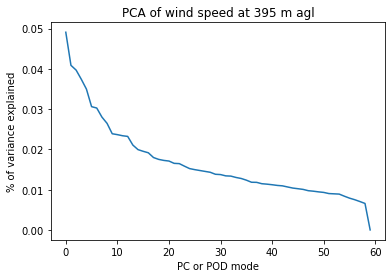

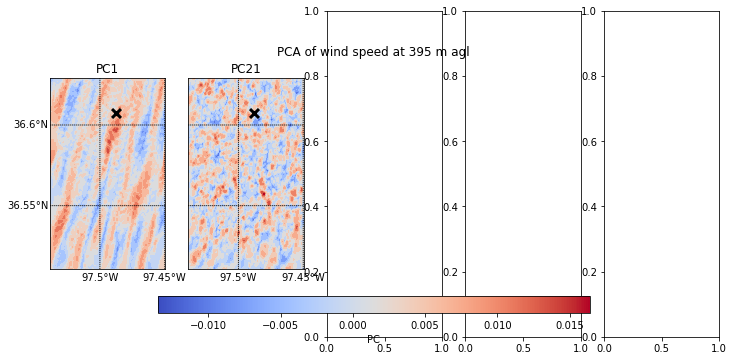

In [24]:
# mode_list = [0, 3, 7, 11, 19]
mode_list = [0, 20]

for hgt_i in [3, 16, 25, 45]:
    
    height_str = str(int(height[hgt_i].values))

    var_at1h = var_all[:, hgt_i, :, :]

    var_at1h_df = var_at1h.drop_vars('wspd_wdir').to_dataframe()

    timeloc_df = pd.pivot_table(var_at1h_df, values='wspd_wdir', 
                                index=['Time'], columns=['south_north', 'west_east'])

    pca = PCA()
    pca.fit(timeloc_df)
    pcs = pca.components_

    plt.plot(pca.explained_variance_ratio_)
    plt.ylabel('% of variance explained')
    plt.xlabel('PC or POD mode')
    plt.title('PCA of wind speed at '+height_str+' m agl')
    plt.show()

    lats, lons = wrf.latlon_coords(var)

    fig, ax = plt.subplots(1, 5, figsize=(12, 6))

    time_list = var_at1h['Time'].values
    time = time_list[0]
    var_1time = var_at1h.sel(Time=time)

    v_min = pca.components_[mode_list].min()
    v_max = pca.components_[mode_list].max()

    for i, _ in enumerate(mode_list): 
        plot_pc_map(i, ax[i], mode_list[i])

    cax = plt.axes([0.25, 0.18, 0.5, 0.04])
    sm = plt.cm.ScalarMappable(cmap='coolwarm', norm=plt.Normalize(vmin=v_min, vmax=v_max))
    cb = plt.colorbar(sm, cax=cax, orientation='horizontal', label='PC')

    plt.suptitle('PCA of wind speed at '+height_str+' m agl', y=0.8)

    plt.show()

2018-08-05T17:30:00.000000000


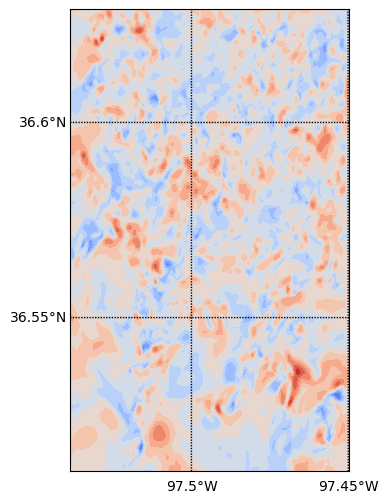

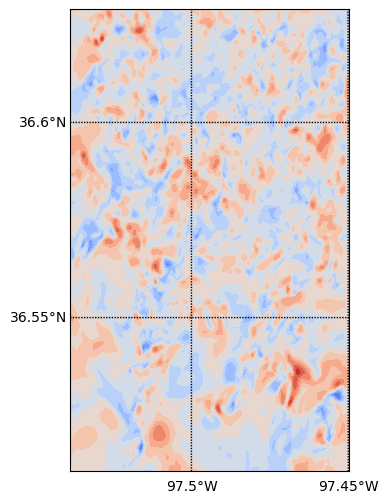

In [14]:
# the two plots should be the same - sanity check

### rotate back to xy plane

lats, lons = wrf.latlon_coords(var)

fig, ax = plt.subplots(figsize=(6, 6))

t_i = 15

time_list = var_at1h['Time'].values
time = time_list[t_i]

print(time)
var_1time = var_at1h.sel(Time=time)

bm = wrf.get_basemap(var_1time, ax=ax)

bm.drawparallels(np.arange(36, 37, 0.05), labels=[1, 0, 0, 0])
bm.drawmeridians(np.arange(-98, -97, 0.05), labels=[0, 0, 0, 1])

x, y = bm(wrf.to_np(lons), wrf.to_np(lats))

p = bm.contourf(x, y, 
                timeloc_df.iloc[t_i].values.reshape((var_at1h.sizes['south_north'], var_at1h.sizes['west_east'])), 
                10, cmap=get_cmap('coolwarm'), )
#                     vmin=v_min, vmax=v_max)

plt.show()

### from wrf

lats, lons = wrf.latlon_coords(var)

fig, ax = plt.subplots(figsize=(6, 6))

bm = wrf.get_basemap(var_1time, ax=ax)

bm.drawparallels(np.arange(36, 37, 0.05), labels=[1, 0, 0, 0])
bm.drawmeridians(np.arange(-98, -97, 0.05), labels=[0, 0, 0, 1])

x, y = bm(wrf.to_np(lons), wrf.to_np(lats))

p = bm.contourf(x, y, wrf.to_np(var_1time), 10, cmap=get_cmap('coolwarm'), )
#                     vmin=v_min, vmax=v_max)

plt.show()

## w PCA

In [20]:
eval_date = '2018-08-05'
run = 'mynn'
hr = 15
hgt_i = 16

# date_col = data_dir_df[eval_date]

# for ind, hr in enumerate(np.arange(16, 24, 1)): 

# file = wrf_runs_dir+date_col[run]+'/auxout/mmc_d04_'+eval_date+'_'+str(hr)+':00:00'
file = wrf_runs_dir+'auxout/mmc_d04_'+eval_date+'_'+str(hr)+'0000'
wrf_single = Dataset(file, 'r')

var = wrf.getvar(wrf_single, 'W', timeidx=wrf.ALL_TIMES)
w = wrf.destagger(var, 1, meta=True)
w = w.assign_coords(var.coords)

height = wrf.getvar(wrf_single, 'height_agl').mean(dim=['south_north', 'west_east'])

var_1t1h = w[0, hgt_i, :, :]
var_at1h = w[:, hgt_i, :, :]

In [2]:
eval_date = '2018-08-05'
run = 'mynn'
hr = 15
hgt_i = 16

for ind, hr in enumerate(np.arange(15, 19, 1)): 

    file = wrf_runs_dir+'auxout/mmc_d04_'+eval_date+'_'+str(hr)+'0000'
    wrf_single = Dataset(file, 'r')

    var = wrf.getvar(wrf_single, 'W', timeidx=wrf.ALL_TIMES)
    w = wrf.destagger(var, 1, meta=True)
    w = w.assign_coords(var.coords)

    if ind == 0: 
        var_all = w
    else: 
        var_all = xr.concat([var_all, w], dim='Time')
        
    height = wrf.getvar(wrf_single, 'height_agl').mean(dim=['south_north', 'west_east'])
        
#     height = wrf.getvar(wrf_single, 'height_agl').mean(dim=['south_north', 'west_east'])[hgt_i]
#     height_str = str(int(height.values))
    
# var_1t1h = var_all[0, hgt_i, :, :]
# var_at1h = var_all[:, hgt_i, :, :]

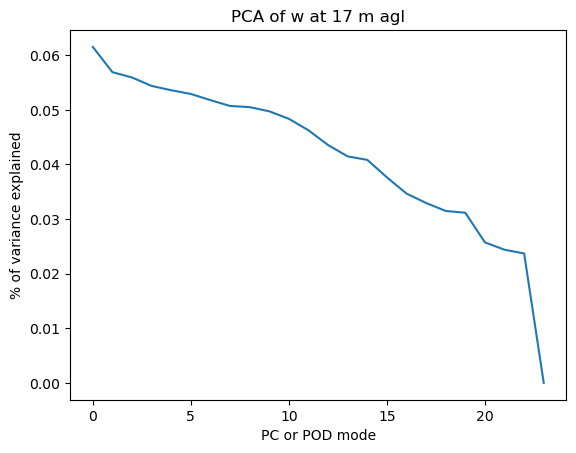

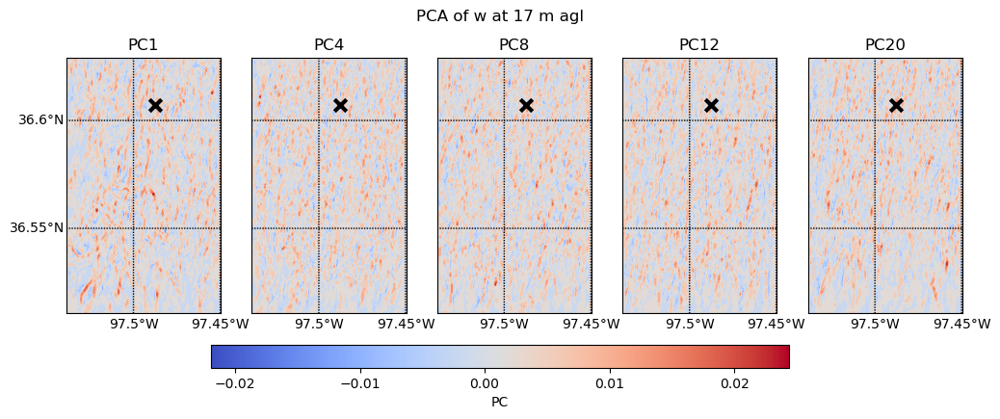

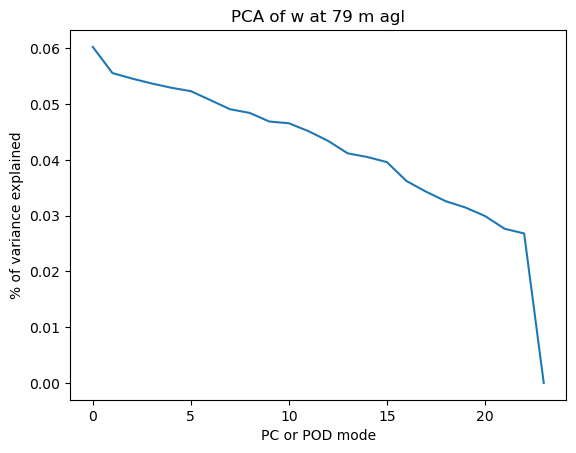

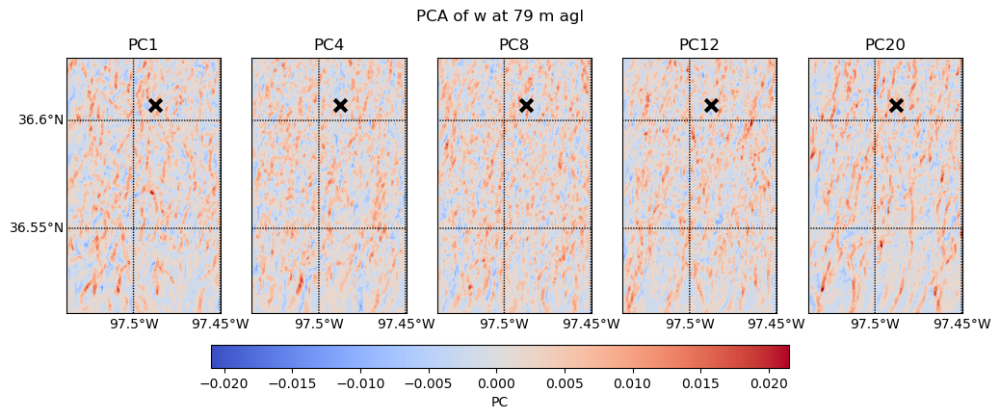

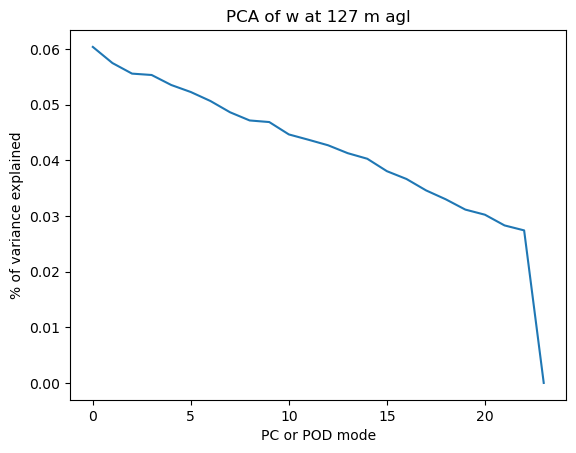

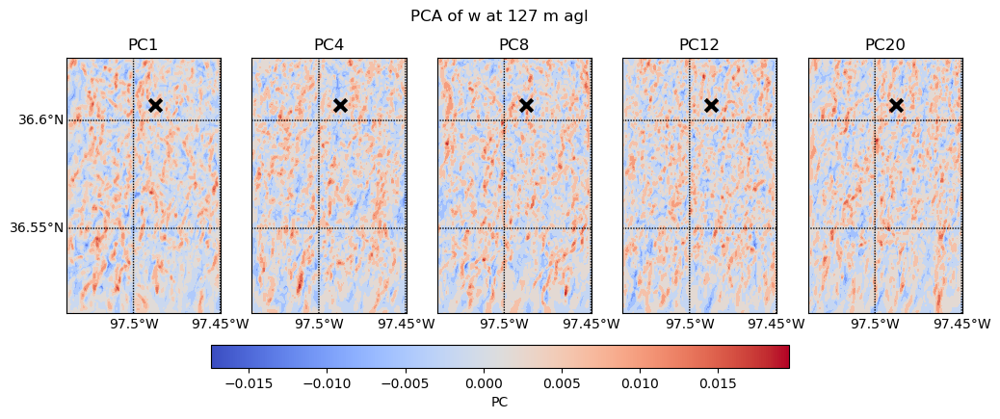

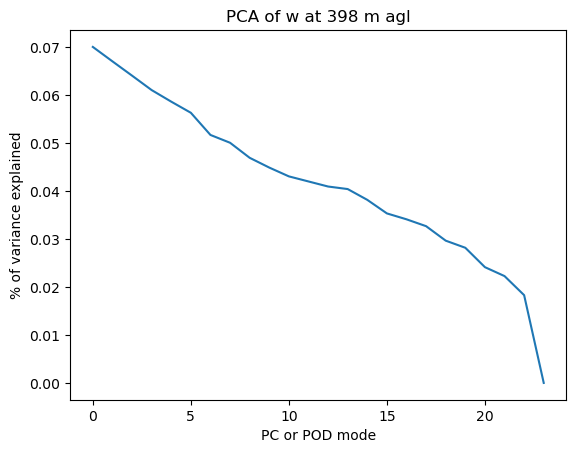

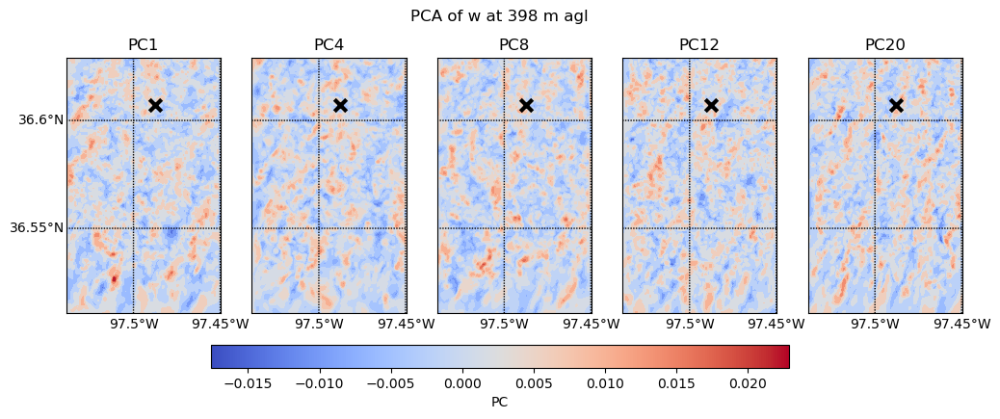

In [15]:
# hgt_i = 16
for hgt_i in [3, 16, 25, 45]:
    
    height_str = str(int(height[hgt_i].values))

    var_at1h = var_all[:, hgt_i, :, :]

    var_at1h_df = var_at1h.to_dataframe()

    timeloc_df = pd.pivot_table(var_at1h_df, values='destag_W', 
                                index=['Time'], columns=['south_north', 'west_east'])

    pca = PCA()
    pca.fit(timeloc_df)
    pcs = pca.components_

    plt.plot(pca.explained_variance_ratio_)
    plt.ylabel('% of variance explained')
    plt.xlabel('PC or POD mode')
    plt.title('PCA of w at '+height_str+' m agl')
    plt.show()

    lats, lons = wrf.latlon_coords(var)

    fig, ax = plt.subplots(1, 5, figsize=(12, 6))

    time_list = var_at1h['Time'].values
    time = time_list[0]
    var_1time = var_at1h.sel(Time=time)

    mode_list = [0, 3, 7, 11, 19]

    v_min = pca.components_[mode_list].min()
    v_max = pca.components_[mode_list].max()

    for i, _ in enumerate(mode_list): 
        plot_pc_map(i, ax[i], mode_list[i])

    cax = plt.axes([0.25, 0.18, 0.5, 0.04])
    sm = plt.cm.ScalarMappable(cmap='coolwarm', norm=plt.Normalize(vmin=v_min, vmax=v_max))
    cb = plt.colorbar(sm, cax=cax, orientation='horizontal', label='PC')

    plt.suptitle('PCA of w at '+height_str+' m agl', y=0.8)

    plt.show()

2018-08-05T17:30:00.000000000


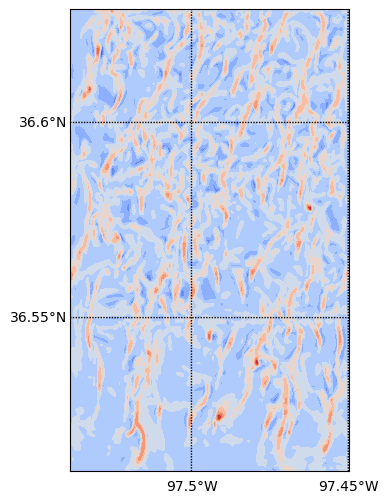

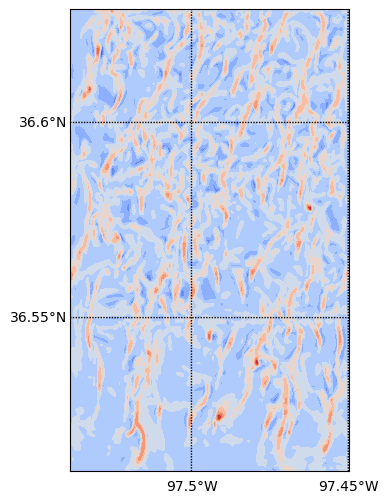

In [14]:
# the two plots should be the same - sanity check

### rotate back to xy plane

lats, lons = wrf.latlon_coords(var)

fig, ax = plt.subplots(figsize=(6, 6))

t_i = 15

time_list = var_at1h['Time'].values
time = time_list[t_i]

print(time)
var_1time = var_at1h.sel(Time=time)

bm = wrf.get_basemap(var_1time, ax=ax)

bm.drawparallels(np.arange(36, 37, 0.05), labels=[1, 0, 0, 0])
bm.drawmeridians(np.arange(-98, -97, 0.05), labels=[0, 0, 0, 1])

x, y = bm(wrf.to_np(lons), wrf.to_np(lats))

p = bm.contourf(x, y, 
                timeloc_df.iloc[t_i].values.reshape((var_at1h.sizes['south_north'], var_at1h.sizes['west_east'])), 
                10, cmap=get_cmap('coolwarm'), )
#                     vmin=v_min, vmax=v_max)

plt.show()

### from wrf

lats, lons = wrf.latlon_coords(var)

fig, ax = plt.subplots(figsize=(6, 6))

bm = wrf.get_basemap(var_1time, ax=ax)

bm.drawparallels(np.arange(36, 37, 0.05), labels=[1, 0, 0, 0])
bm.drawmeridians(np.arange(-98, -97, 0.05), labels=[0, 0, 0, 1])

x, y = bm(wrf.to_np(lons), wrf.to_np(lats))

p = bm.contourf(x, y, wrf.to_np(var_1time), 10, cmap=get_cmap('coolwarm'), )
#                     vmin=v_min, vmax=v_max)

plt.show()

In [8]:
var_at1h_df = var_at1h.drop_vars('wspd_wdir').to_dataframe()

timeloc_df = pd.pivot_table(var_at1h_df, values='wspd_wdir', index=['Time'], columns=['south_north', 'west_east'])

pca = PCA()
pca.fit(timeloc_df)
pcs = pca.components_

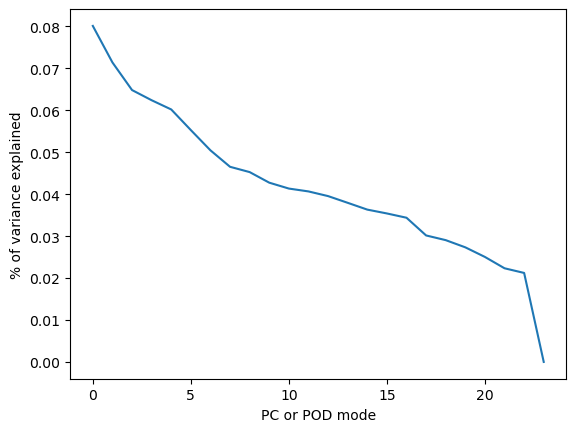

In [143]:
plt.plot(pca.explained_variance_ratio_)
plt.ylabel('% of variance explained')
plt.xlabel('PC or POD mode')
plt.show()

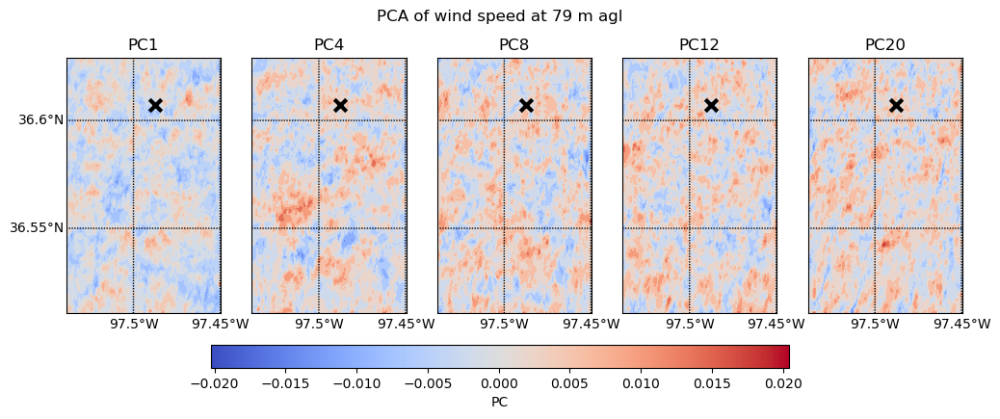

In [141]:
lats, lons = wrf.latlon_coords(var)

fig, ax = plt.subplots(1, 5, figsize=(12, 6))

time_list = var_at1h['Time'].values
time = time_list[0]
var_1time = var_at1h.sel(Time=time)

mode_list = [0, 3, 7, 11, 19]

v_min = pca.components_[mode_list].min()
v_max = pca.components_[mode_list].max()

def plot_pc_map(i, ax, mode):

    bm = wrf.get_basemap(var_1time, ax=ax)
    
    if i == 0:
        bm.drawparallels(np.arange(36, 37, 0.05), labels=[1, 0, 0, 0])
    else:
        bm.drawparallels(np.arange(36, 37, 0.05), labels=[0, 0, 0, 0])
        
    bm.drawmeridians(np.arange(-98, -97, 0.05), labels=[0, 0, 0, 1])

    x, y = bm(wrf.to_np(lons), wrf.to_np(lats))

    p = bm.contourf(x, y, pcs[mode].reshape((var_at1h.sizes['south_north'], var_at1h.sizes['west_east'])), 
                    10, cmap=get_cmap('coolwarm'), vmin=v_min, vmax=v_max)
    
    ax.set_title('PC'+str(mode+1))

    c1x, c1y = bm(wrf.to_np(-97.487643), wrf.to_np(36.607322))
    bm.scatter(c1x, c1y, s=80, marker='x', color='black', linewidth=3, ax=ax)

#     c1x, c1y = bm(wrf.to_np(-97.493), wrf.to_np(36.613))
#     ax.annotate('C1', xy=(c1x, c1y), size=15, color='white')

for i, _ in enumerate(mode_list): 
    plot_pc_map(i, ax[i], mode_list[i])

cax = plt.axes([0.25, 0.18, 0.5, 0.04])
sm = plt.cm.ScalarMappable(cmap='coolwarm', norm=plt.Normalize(vmin=v_min, vmax=v_max))
cb = plt.colorbar(sm, cax=cax, orientation='horizontal', label='PC')

plt.suptitle('PCA of wind speed at '+height_str+' m agl', y=0.8)

plt.show()

In [82]:
x

array([[-1.81898940e-12,  3.81781341e+01,  7.90832778e+01, ...,
         7.87833147e+03,  7.91923662e+03,  7.96014176e+03],
       [ 2.12059753e-02,  3.81991628e+01,  7.91041166e+01, ...,
         7.87831561e+03,  7.91922056e+03,  7.96012551e+03],
       [ 4.26375458e-02,  3.82204152e+01,  7.91251770e+01, ...,
         7.87830039e+03,  7.91920516e+03,  7.96010992e+03],
       ...,
       [-1.21075628e+00,  3.96320693e+01,  7.77520399e+01, ...,
         7.87873254e+03,  7.91957537e+03,  7.95769534e+03],
       [-1.18973834e+00,  3.96528993e+01,  7.77726946e+01, ...,
         7.87871697e+03,  7.91955961e+03,  7.95767940e+03],
       [-1.16804241e+00,  3.96744013e+01,  7.77940155e+01, ...,
         7.87870157e+03,  7.91954402e+03,  7.95766364e+03]])

In [92]:
timeloc_df.iloc[0].values.reshape((var_at1h.sizes['south_north'], var_at1h.sizes['west_east']))

array([[ 9.617658 ,  9.551989 ,  9.94309  , ...,  7.2470207,  9.053477 ,
         8.6584425],
       [ 9.695818 ,  9.660105 , 10.074662 , ...,  6.502791 ,  9.1577   ,
         8.578039 ],
       [ 9.718216 ,  9.916403 , 10.138894 , ...,  7.5616703,  8.668982 ,
         8.450819 ],
       ...,
       [ 6.0862308,  5.745424 ,  5.5399666, ...,  8.027919 ,  8.358811 ,
         8.704029 ],
       [ 6.03297  ,  5.472009 ,  5.246586 , ...,  8.559608 ,  8.134964 ,
         8.574688 ],
       [ 6.052552 ,  5.4789224,  5.2374573, ...,  8.555768 ,  8.093197 ,
         8.524784 ]], dtype=float32)

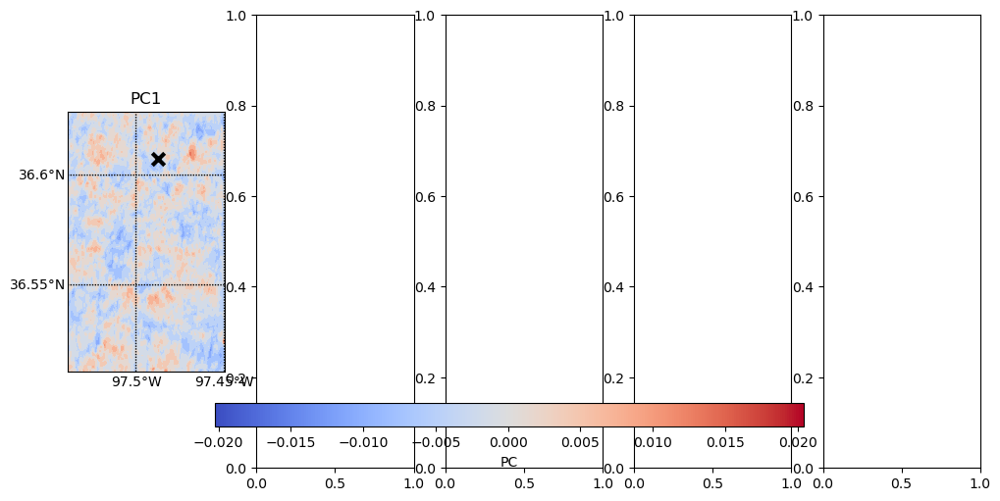

In [117]:
lats, lons = wrf.latlon_coords(var)

fig, ax = plt.subplots(1, 5, figsize=(12, 6))

time_list = var_at1h['Time'].values
time = time_list[0]
var_1time = var_at1h.sel(Time=time)

mode_list = [0, 3, 7, 11, 19]

v_min = pca.components_[mode_list].min()
v_max = pca.components_[mode_list].max()

ax = ax[0]
mode = mode_list[0]

# def plot_pc_map(ax, mode):

bm = wrf.get_basemap(var_1time, ax=ax) # suppress_ticks=True

bm.drawparallels(np.arange(36, 37, 0.05), labels=[1, 0, 0, 0])
bm.drawmeridians(np.arange(-98, -97, 0.05), labels=[0, 0, 0, 1])

x, y = bm(wrf.to_np(lons), wrf.to_np(lats))

p = bm.contourf(x, y, pcs[mode].reshape((var_at1h.sizes['south_north'], var_at1h.sizes['west_east'])), 
                10, cmap=get_cmap('coolwarm'), vmin=v_min, vmax=v_max)

ax.set_title('PC'+str(mode+1))
# ax.set_yticks(False)
# p.ax.get_yaxis().set_ticks([])
# p.ax.get_yaxis().set_visible(False)
# p.set_yticklabels([''])
# bm.ax.set_xticklabels(['ax'])
# ax.set_xticklabels(['ax'])

c1x, c1y = bm(wrf.to_np(-97.487643), wrf.to_np(36.607322))
bm.scatter(c1x, c1y, s=80, marker='x', color='black', linewidth=3, ax=ax)
    
#     ax.set_yticks(False)
#     ax.get_yaxis().set_ticks([])
#     ax.get_yaxis().set_visible(False)
#     p.set_yticklabels([''])

#     c1x, c1y = bm(wrf.to_np(-97.493), wrf.to_np(36.613))
#     ax.annotate('C1', xy=(c1x, c1y), size=15, color='white')

# for i, _ in enumerate(mode_list[:2]): 
#     plot_pc_map(ax[i], mode_list[i])

cax = plt.axes([0.25, 0.18, 0.5, 0.04])
sm = plt.cm.ScalarMappable(cmap='coolwarm', norm=plt.Normalize(vmin=v_min, vmax=v_max))
cb = plt.colorbar(sm, cax=cax, orientation='horizontal', label='PC')

plt.show()

In [104]:
dir(bm.ax)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setstate__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_add_text',
 '_adjustable',
 '_agg_filter',
 '_alpha',
 '_anchor',
 '_animated',
 '_aspect',
 '_autoscaleXon',
 '_autoscaleYon',
 '_autotitlepos',
 '_axes',
 '_axes_class',
 '_axes_locator',
 '_axisbelow',
 '_clipon',
 '_clippath',
 '_contains',
 '_convert_dx',
 '_current_image',
 '_default_contains',
 '_facecolor',
 '_frameon',
 '_gci',
 '_gen_axes_patch',
 '_gen_axes_spines',
 '_get_axis_list',
 '_get_axis_map',
 '_get_clipping_extent_bbox',
 '_get_lines',
 '_get_patches_for_fill',
 '_get_view',
 '_gid',
 '_gridOn',
 '_in_layout',
 '_init_axis',
 '_label',
 '_layoutbox',
 '_left_title'

In [97]:
dir(p.ax)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setstate__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_add_text',
 '_adjustable',
 '_agg_filter',
 '_alpha',
 '_anchor',
 '_animated',
 '_aspect',
 '_autoscaleXon',
 '_autoscaleYon',
 '_autotitlepos',
 '_axes',
 '_axes_class',
 '_axes_locator',
 '_axisbelow',
 '_clipon',
 '_clippath',
 '_contains',
 '_convert_dx',
 '_current_image',
 '_default_contains',
 '_facecolor',
 '_frameon',
 '_gci',
 '_gen_axes_patch',
 '_gen_axes_spines',
 '_get_axis_list',
 '_get_axis_map',
 '_get_clipping_extent_bbox',
 '_get_lines',
 '_get_patches_for_fill',
 '_get_view',
 '_gid',
 '_gridOn',
 '_in_layout',
 '_init_axis',
 '_label',
 '_layoutbox',
 '_left_title'

In [64]:
pca.components_.shape

(6, 66000)

In [72]:
pca.components_[0]

array([ 0.00139763, -0.00319795,  0.00260614, ...,  0.00131231,
        0.00234863,  0.00180632], dtype=float32)

In [65]:
pca.explained_variance_ratio_

array([2.4130554e-01, 2.1675692e-01, 1.9553138e-01, 1.7413265e-01,
       1.7227353e-01, 2.5095087e-13], dtype=float32)

In [66]:
pca.explained_variance_

array([1.6217963e+04, 1.4568068e+04, 1.3141516e+04, 1.1703323e+04,
       1.1578373e+04, 1.6866219e-08], dtype=float32)

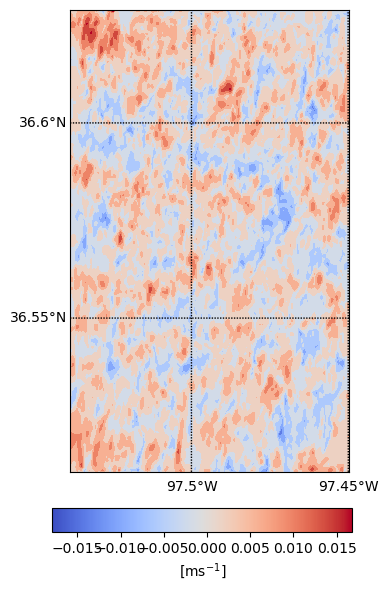

In [47]:
lats, lons = wrf.latlon_coords(var)

fig, ax = plt.subplots(figsize=(6, 6))

time_list = var_at1h['Time'].values
time = time_list[0]
var_1time = var_at1h.sel(Time=time)

mode = 10

v_min = pca.components_[mode].min()
v_max = pca.components_[mode].max()

bm = wrf.get_basemap(var_1time, ax=ax)

bm.drawparallels(np.arange(36, 37, 0.05), labels=[1, 0, 0, 0])
bm.drawmeridians(np.arange(-98, -97, 0.05), labels=[0, 0, 0, 1])

x, y = bm(wrf.to_np(lons), wrf.to_np(lats))

p = bm.contourf(x, y, pca.components_[mode].reshape((var_at1h.sizes['south_north'], var_at1h.sizes['west_east'])), 
                10, cmap=get_cmap('coolwarm'), vmin=v_min, vmax=v_max)

cax = plt.axes([0.25, 0.01, 0.5, 0.04])
sm = plt.cm.ScalarMappable(cmap='coolwarm', norm=plt.Normalize(vmin=v_min, vmax=v_max))
cb = plt.colorbar(sm, cax=cax, orientation='horizontal', label=r'[ms$^{-1}$]')

plt.show()

2018-08-05T16:40:00.000000000


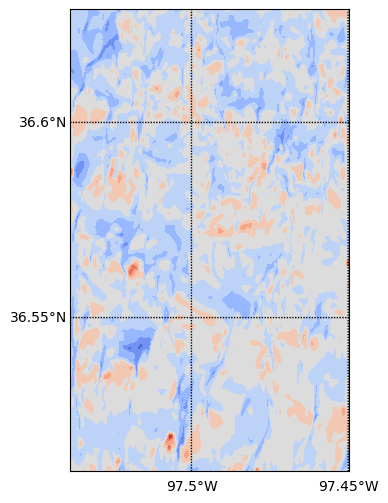

In [140]:
lats, lons = wrf.latlon_coords(var)

fig, ax = plt.subplots(figsize=(6, 6))

# time_list = pd.date_range(start=eval_date+'-15', end=eval_date+'-23', periods=8)

time = time_list[10]

print(time)
var_1time = var_at1h.sel(Time=time)

bm = wrf.get_basemap(var_1time, ax=ax)

bm.drawparallels(np.arange(36, 37, 0.05), labels=[1, 0, 0, 0])
bm.drawmeridians(np.arange(-98, -97, 0.05), labels=[0, 0, 0, 1])

x, y = bm(wrf.to_np(lons), wrf.to_np(lats))

p = bm.contourf(x, y, timeloc_df.iloc[10].values.reshape((var_at1h.sizes['south_north'], var_at1h.sizes['west_east'])), 10, cmap=get_cmap('coolwarm'), )
#                     vmin=v_min, vmax=v_max)

plt.show()

In [88]:
timeloc_df.loc['2018-08-05 15:00:00'].unstack().shape

(330, 200)

2018-08-05 15:00:00


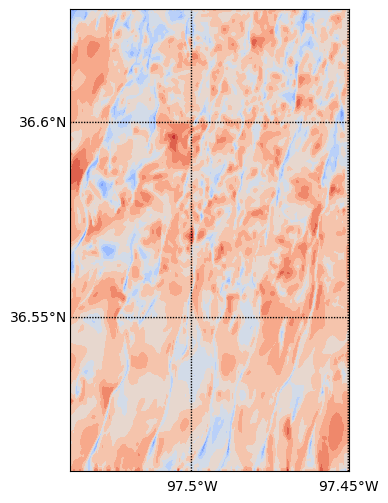

In [60]:
lats, lons = wrf.latlon_coords(var)

fig, ax = plt.subplots(figsize=(6, 6))

time_list = pd.date_range(start=eval_date+'-15', end=eval_date+'-23', periods=8)

time = time_list[0]

print(time)
var_1time = var_at1h.sel(Time=time)

bm = wrf.get_basemap(var_1time, ax=ax)

bm.drawparallels(np.arange(36, 37, 0.05), labels=[1, 0, 0, 0])
bm.drawmeridians(np.arange(-98, -97, 0.05), labels=[0, 0, 0, 1])

x, y = bm(wrf.to_np(lons), wrf.to_np(lats))

p = bm.contourf(x, y, timeloc_df.loc['2018-08-05 15:00:00'].unstack(), 10, cmap=get_cmap('coolwarm'), )
#                     vmin=v_min, vmax=v_max)

plt.show()

In [59]:
wrf.to_np(var_1time).shape

(330, 200)

In [2]:
data_dir_df

,2018-08-05,2018-09-01
mynn,l1_0805m,o1_0901m_30s
mynn_ck0.1,l7_0805m-ck,NaN
edmf,l2_0805e,o2_0901e_30s
mynn_all4d-1arcs-topo,l5_0805m,NaN
mynn_d12-9s_d34-1s,n1_d12-9s_d34-1s,o5_0901m_9s1s
mynn_d123-9s_d4-1s_lu,n2_d123-9s_d4-1s,NaN
mynn_all4d-9arcs_lu,n3_9s,NaN
edmf_d12-9s_d34-1s,NaN,o6_0901e_9s1s
wrf_start,8/4/18 12:00,8/31/18 12:00


In [68]:
eval_date = '2018-09-01'
run = 'mynn'
hgt_i = 16

def plot_w_8ps(eval_date, run, hgt_i):

    date_col = data_dir_df[eval_date]

    for ind, hr in enumerate(np.arange(16, 24, 1)): 

        file = wrf_runs_dir+date_col[run]+'/auxout/mmc_d04_'+eval_date+'_'+str(hr)+':00:00'
        wrf_single = Dataset(file, 'r')

        var = wrf.getvar(wrf_single, 'W', timeidx=wrf.ALL_TIMES)
        w = wrf.destagger(var, 1, meta=True)[:, hgt_i, :, :]
        w = w.assign_coords(var.coords)

        height = wrf.getvar(wrf_single, 'height_agl').mean(dim=['south_north', 'west_east'])[hgt_i]
        height_str = str(int(height.values))

        if ind == 0: 
            var_all = w
        else: 
            var_all = xr.concat([var_all, w], dim='Time')

    lats, lons = wrf.latlon_coords(var_all)

    fig, (axs1, axs2) = plt.subplots(2, 4, figsize=(15, 10))

    # time_list = pd.date_range(start=eval_date+'-16', end=eval_date+'-19', periods=4)
    time_list = pd.date_range(start=eval_date+'-16', end=eval_date+'-23', periods=8)

    var_subset = var_all.sel(Time=slice(time_list.min(), time_list.max()))
    v_min = -7 #var_subset.min()
    v_max = 7 #var_subset.max()

    for ind, time in enumerate(time_list):

    #     print(time)
        var_1time = var_subset.sel(Time=time)

        if ind <= 3: 
            axs = axs1
        else: 
            axs = axs2
            ind -= 4

        bm = wrf.get_basemap(var_1time, ax=axs[ind])

        bm.drawparallels(np.arange(36, 37, 0.05), labels=[1, 0, 0, 0])
        bm.drawmeridians(np.arange(-98, -97, 0.05), labels=[0, 0, 0, 1])

        x, y = bm(wrf.to_np(lons), wrf.to_np(lats))

        p = bm.contourf(x, y, wrf.to_np(var_1time), 10, cmap=get_cmap('coolwarm'), 
                        vmin=v_min, vmax=v_max)

    #         print(time.hour, time.minute)
        axs[ind].set_title(str(time.hour)+' UTC')

        c1x, c1y = bm(wrf.to_np(-97.487643), wrf.to_np(36.607322))
        bm.scatter(c1x, c1y, s=200, marker='x', color='white', linewidth=4, ax=axs[ind])

        c1x, c1y = bm(wrf.to_np(-97.493), wrf.to_np(36.613))
        axs[ind].annotate('C1', xy=(c1x, c1y), size=15, color='white')

    #     if ind == 3:
    #         sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=v_min, vmax=v_max))
    #         plt.colorbar(sm, ax=axs[0], orientation='horizontal', pad=0.1)

    #     fig.colorbar(p, ax=axs[0])

    # plt.subplots_adjust(bottom=0.1)
    cax = plt.axes([0.25, 0.01, 0.5, 0.04])
    sm = plt.cm.ScalarMappable(cmap='coolwarm', norm=plt.Normalize(vmin=v_min, vmax=v_max))
    cb = plt.colorbar(sm, cax=cax, orientation='horizontal', label=r'[ms$^{-1}$]')
    #     cb.title('m/s')

    plt.suptitle(run+'\n'+eval_date+'\n'+var_all.name+' @ '+height_str+' m agl')

    # plt.tight_layout()

    # plt.savefig(plots_dir+'/'+eval_date+'_'+plot_var+height_str+'_'+run+'.pdf')

    plt.show()

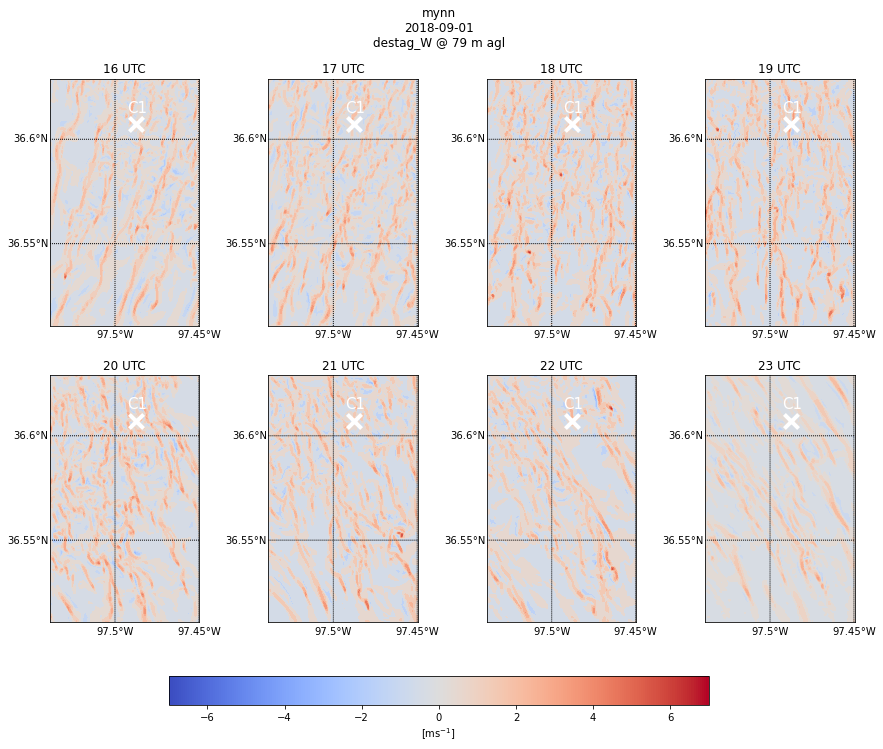

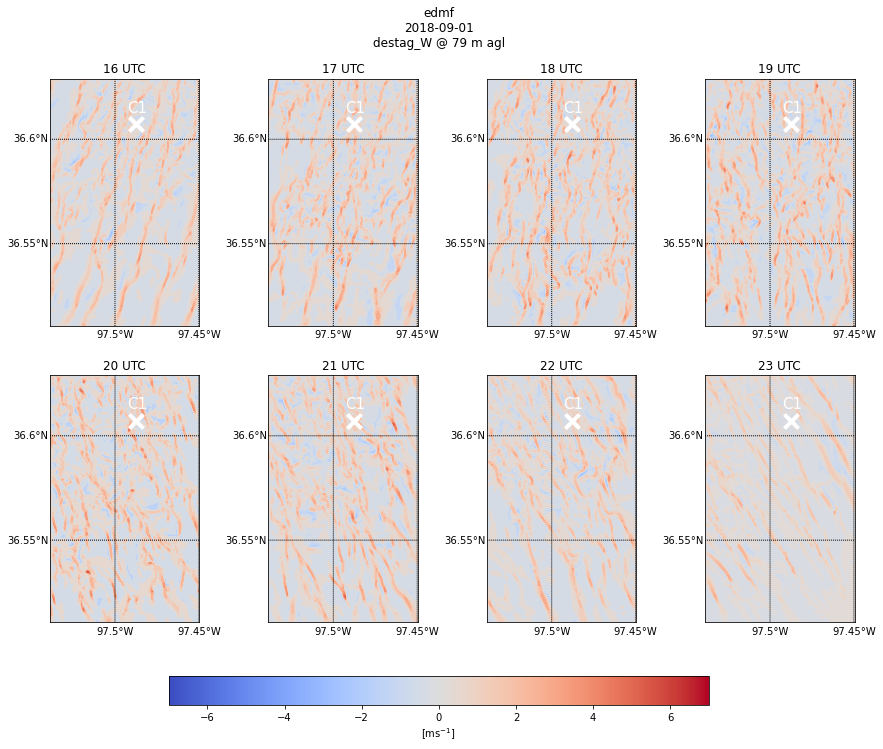

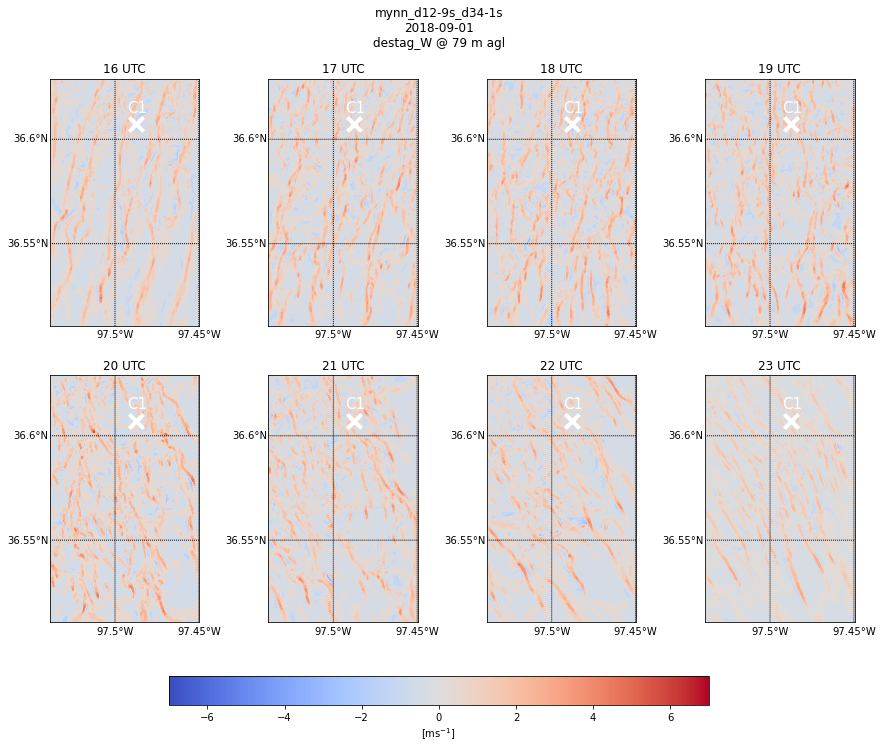

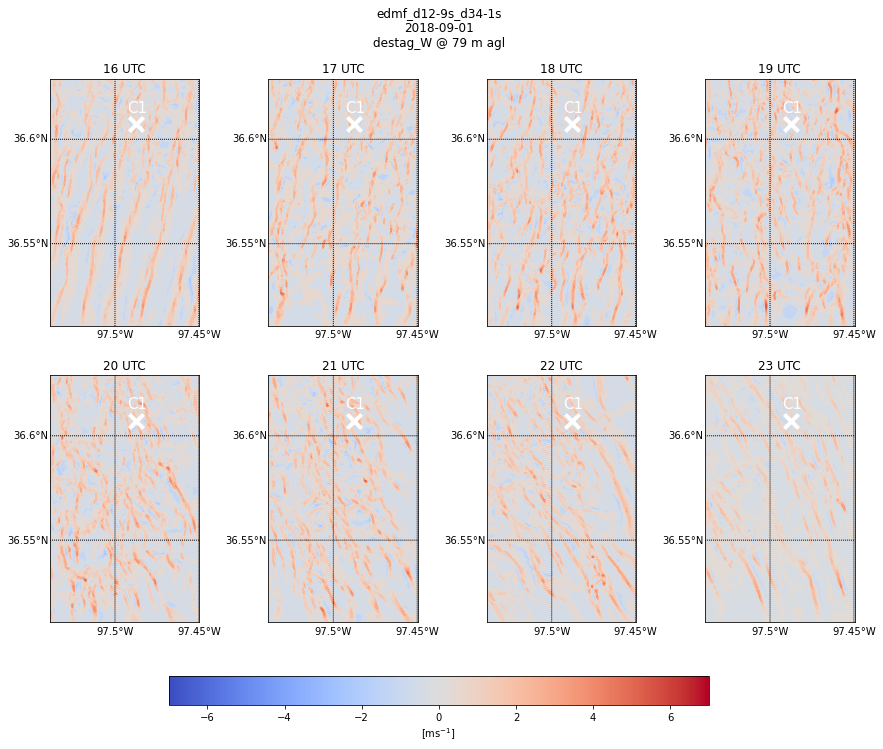

In [71]:
eval_date = '2018-09-01'
# run = 'mynn'
hgt_i = 16

for run in ['mynn', 'edmf', 'mynn_d12-9s_d34-1s', 'edmf_d12-9s_d34-1s']:
    plot_w_8ps(eval_date, run, hgt_i)

## ws wd 8 contours

In [2]:
def plot_8contour_wswd(run, wrf_var, plot_var):

    date_col = data_dir_df[eval_date]

    for ind, hr in enumerate(np.arange(16, 24, 1)): 

        file = wrf_runs_dir+date_col[run]+'/auxout/mmc_d04_'+eval_date+'_'+str(hr)+':00:00'
        wrf_single = Dataset(file, 'r')

        var = wrf.getvar(wrf_single, wrf_var, timeidx=wrf.ALL_TIMES)
        
        if wrf_var == 'wspd_wdir':
            # ~ hub height
            height = wrf.getvar(wrf_single, 'height_agl').mean(dim=['south_north', 'west_east'])[16]
            # missing QVAPOR -- cannot use this
            # wrf.vinterp(wrf_single, var_u, vert_coord='ght_agl', interp_levels=[80])
            height_str = str(int(height.values))
            var = var.isel(bottom_top=16)
        if wrf_var == 'wspd_wdir10':
            height_str = '10'

        if ind == 0: 
            var_all = var
        else: 
            var_all = xr.concat([var_all, var], dim='Time')

    lats, lons = wrf.latlon_coords(var_all)

    fig, (axs1, axs2) = plt.subplots(2, 4, figsize=(15, 10))

    # time_list = pd.date_range(start=eval_date+'-16', end=eval_date+'-19', periods=4)
    time_list = pd.date_range(start=eval_date+'-16', end=eval_date+'-23', periods=8)

    var_subset = var_all.sel(Time=slice(time_list.min(), time_list.max()), wspd_wdir=plot_var)
    v_min = var_subset.min()
    v_max = var_subset.max()

    for ind, time in enumerate(time_list):

    #     print(time)
        var_1time = var_subset.sel(Time=time)

        if ind <= 3: 
            axs = axs1
        else: 
            axs = axs2
            ind -= 4

        bm = wrf.get_basemap(var_1time, ax=axs[ind])

        bm.drawparallels(np.arange(36, 37, 0.05), labels=[1, 0, 0, 0])
        bm.drawmeridians(np.arange(-98, -97, 0.05), labels=[0, 0, 0, 1])

        x, y = bm(wrf.to_np(lons), wrf.to_np(lats))

        p = bm.contourf(x, y, wrf.to_np(var_1time), 10, cmap=get_cmap('viridis'), 
                        vmin=v_min, vmax=v_max)

#         print(time.hour, time.minute)
        axs[ind].set_title(str(time.hour)+' UTC')

        c1x, c1y = bm(wrf.to_np(-97.487643), wrf.to_np(36.607322))
        bm.scatter(c1x, c1y, s=200, marker='x', color='white', linewidth=4, ax=axs[ind])

        c1x, c1y = bm(wrf.to_np(-97.493), wrf.to_np(36.613))
        axs[ind].annotate('C1', xy=(c1x, c1y), size=15, color='white')

    #     if ind == 3:
    #         sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=v_min, vmax=v_max))
    #         plt.colorbar(sm, ax=axs[0], orientation='horizontal', pad=0.1)

    #     fig.colorbar(p, ax=axs[0])

    if plot_var == 'wspd':
        units = r'[m s$^{-1}$]'
    if plot_var == 'wdir':
        units = '[deg]'
    
    # plt.subplots_adjust(bottom=0.1)
    cax = plt.axes([0.25, 0.01, 0.5, 0.04])
    sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=v_min, vmax=v_max))
    cb = plt.colorbar(sm, cax=cax, orientation='horizontal', label=units)
#     cb.title('m/s')

    plt.suptitle(run+'\n'+eval_date+'\n'+plot_var+' @ '+height_str+' m agl')

    # plt.tight_layout()
    
    plt.savefig(plots_dir+'/'+eval_date+'_'+plot_var+height_str+'_'+run+'.pdf')

    plt.show()

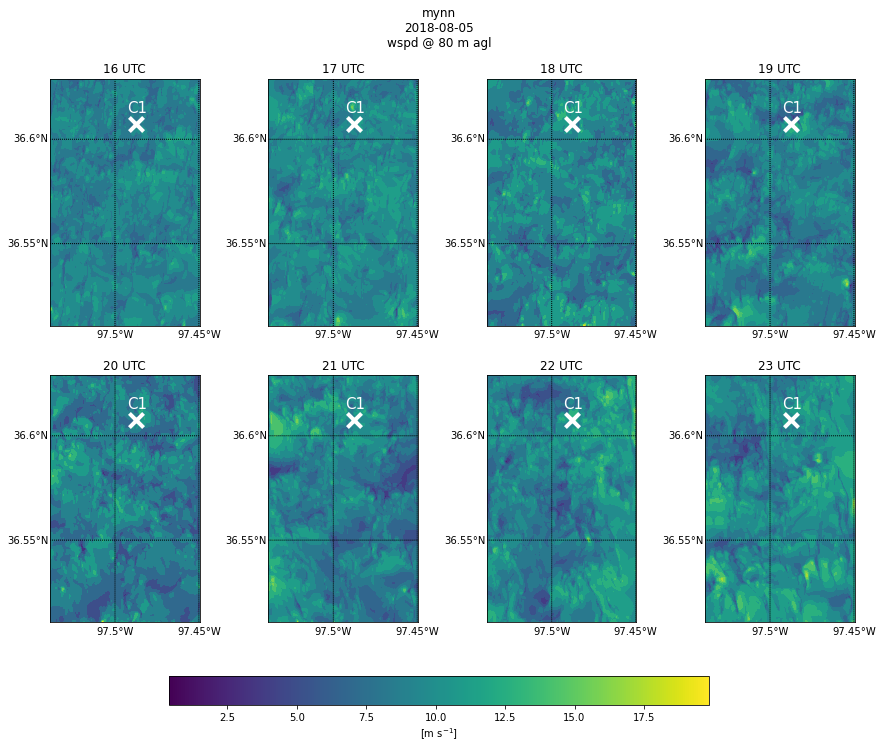

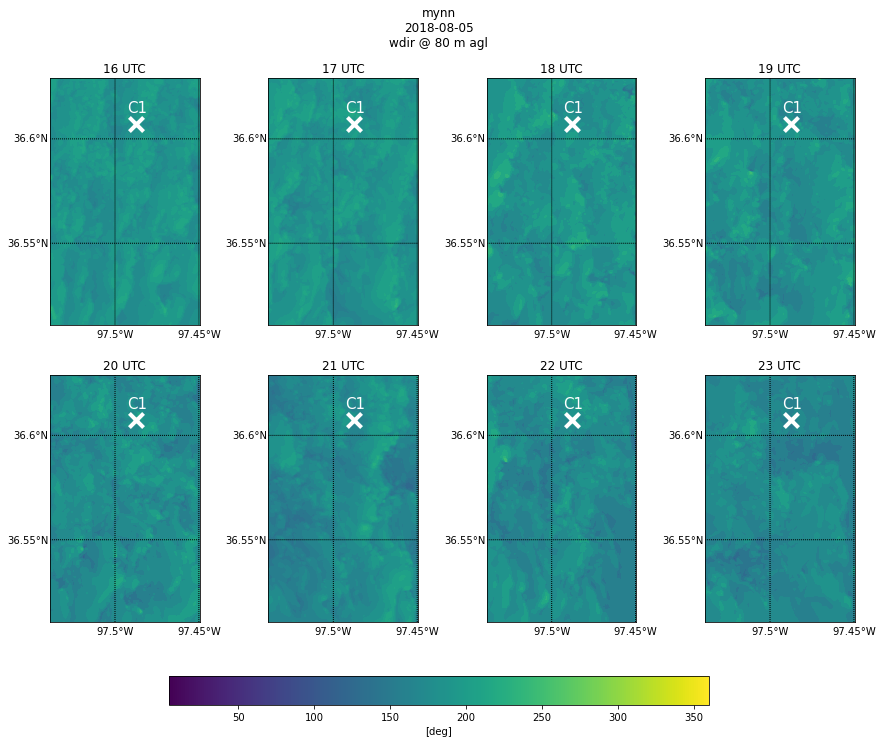

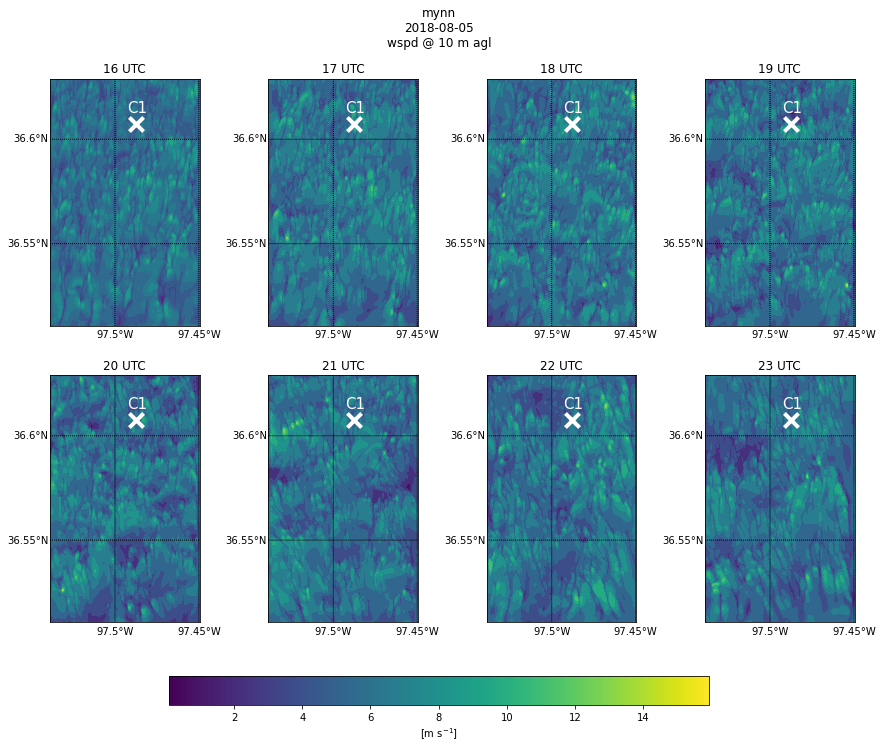

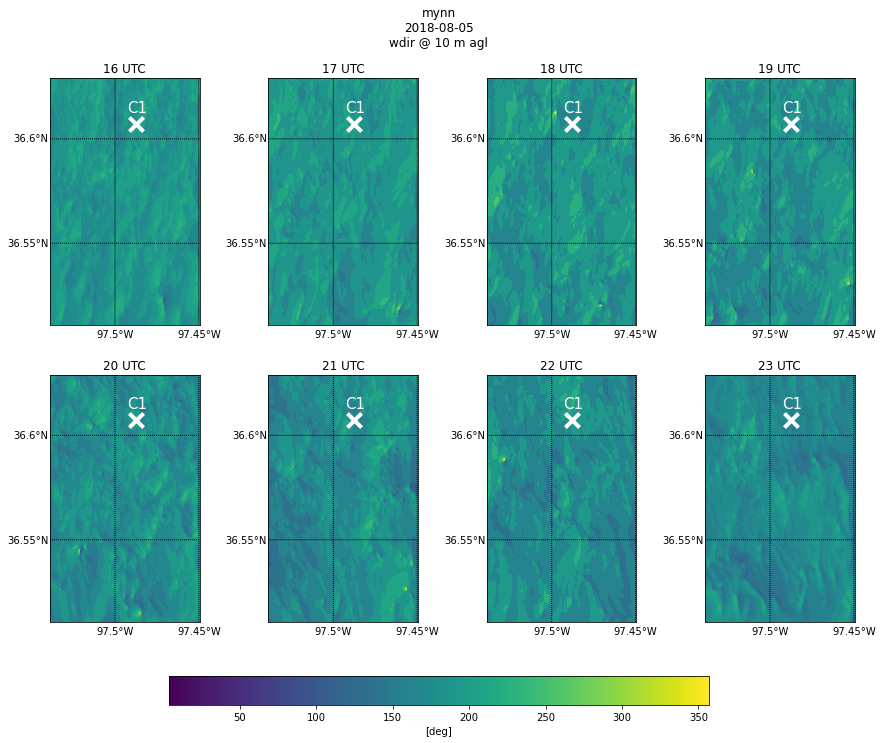

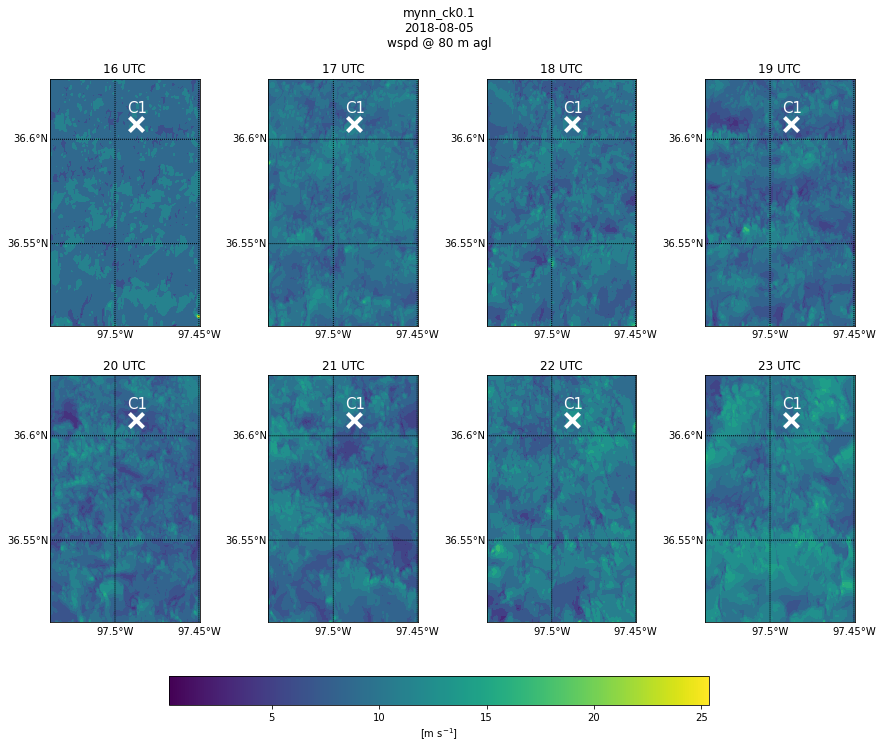

...

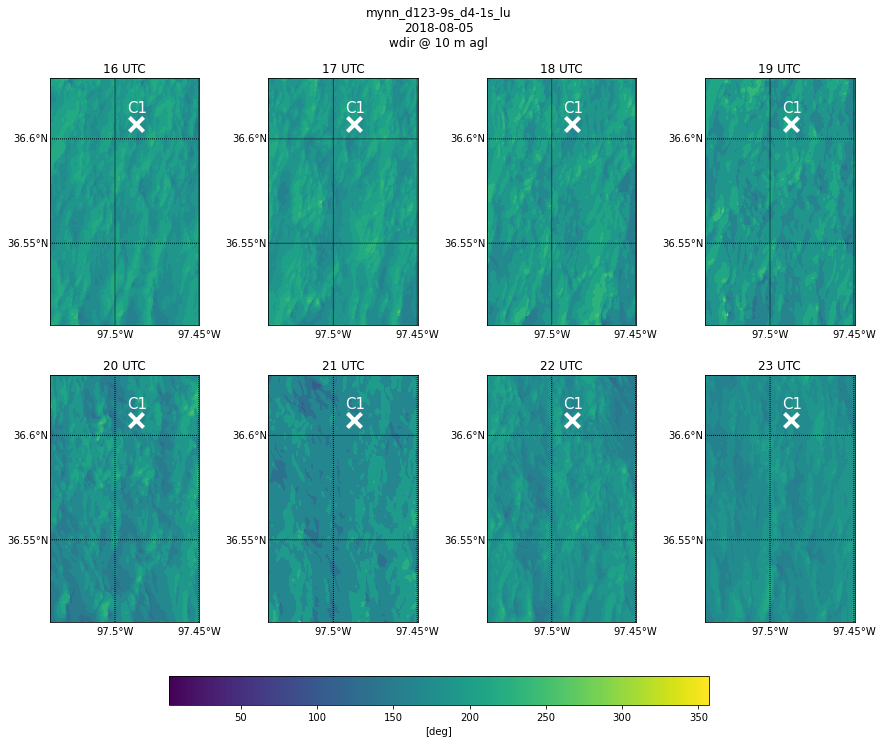

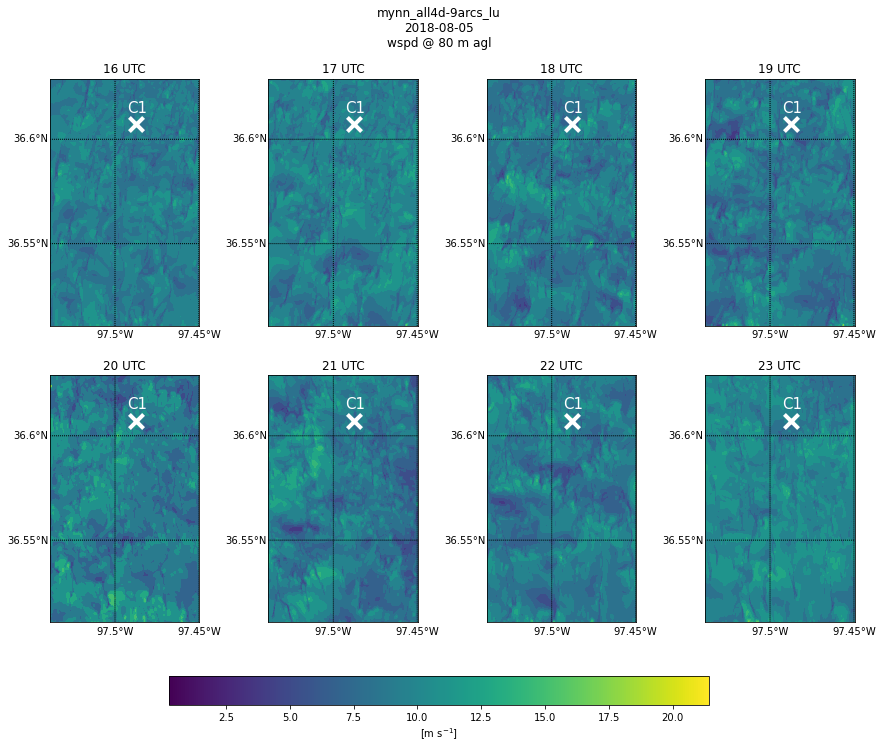

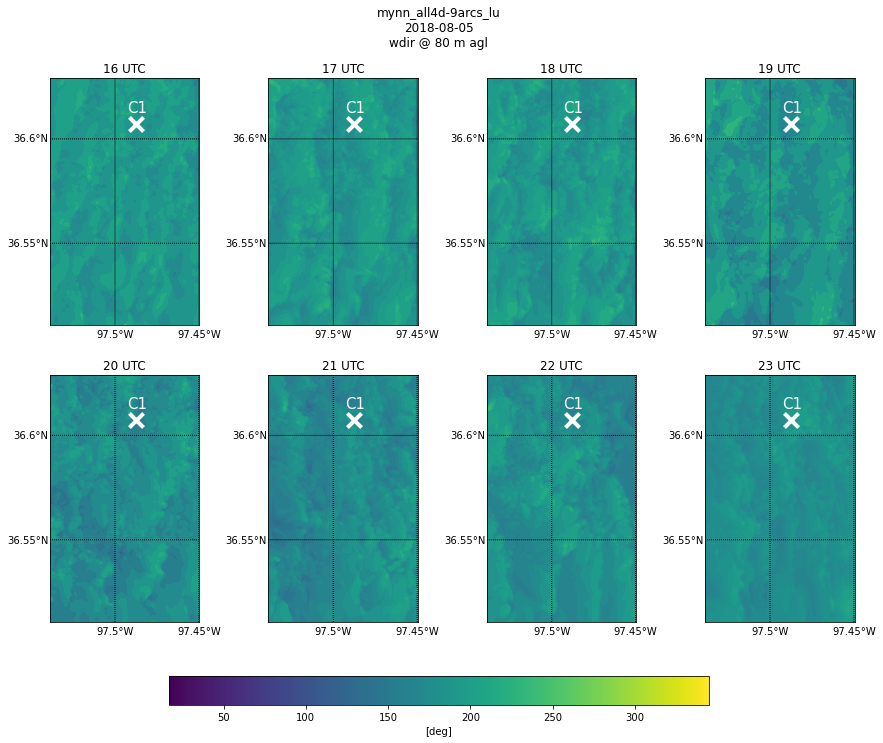

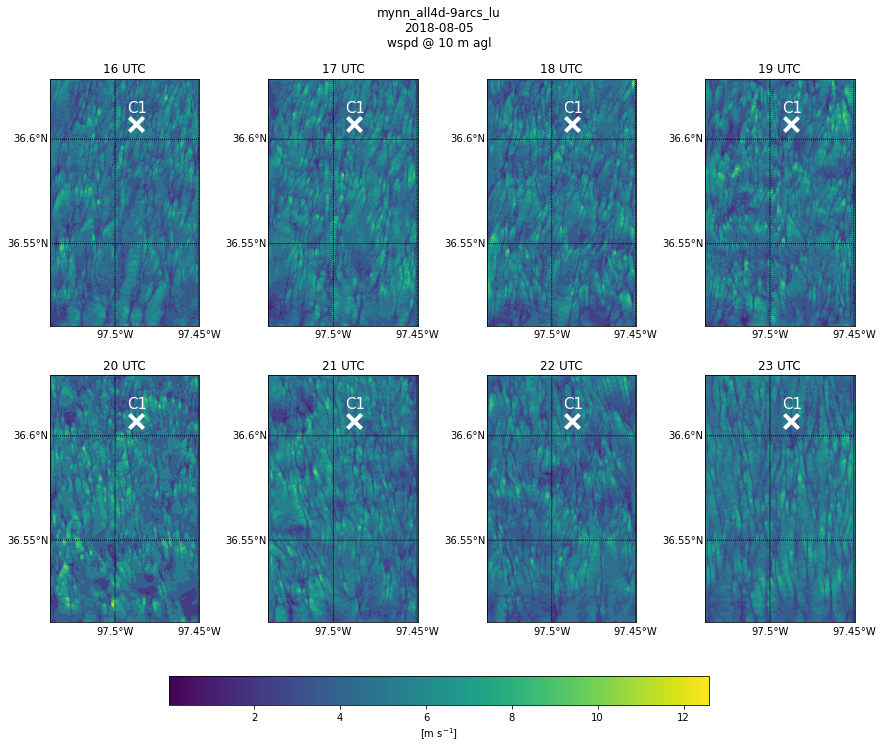

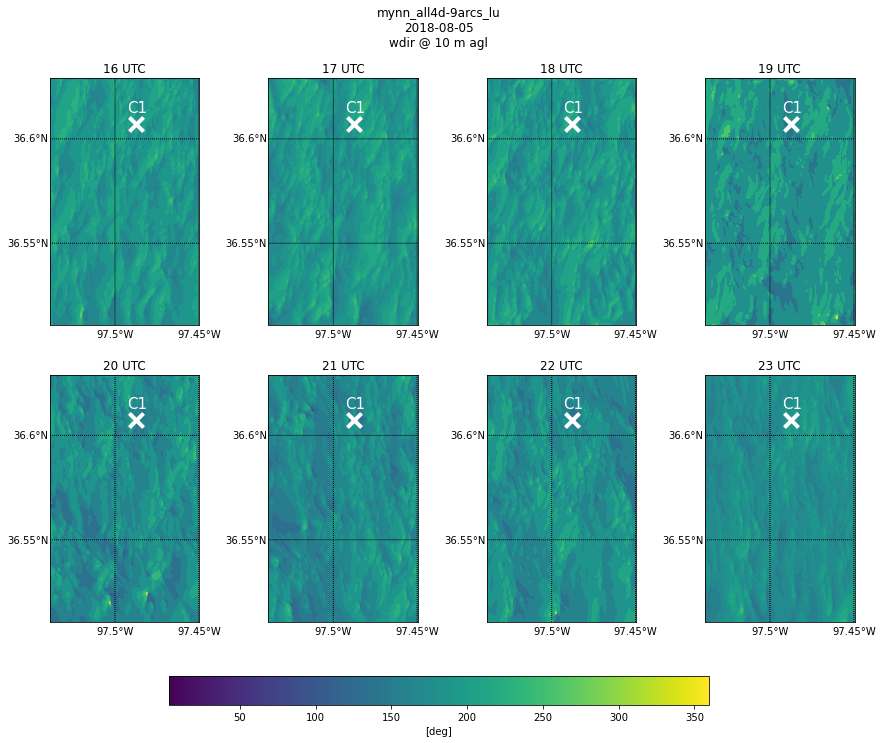

In [3]:
eval_date = '2018-08-05'
# run = 'mynn'
# wrf_var = 'wspd_wdir'
# plot_var = 'wspd'

for run in runs_list:
    for wrf_var in ['wspd_wdir', 'wspd_wdir10']:
        plot_8contour_wswd(run, wrf_var, 'wspd')
        plot_8contour_wswd(run, wrf_var, 'wdir')

## 1 lev contour 8 panels

In [2]:
def plot_1lev_contour(run, wrf_var):

    date_col = data_dir_df[eval_date]

    for ind, hr in enumerate(np.arange(16, 24, 1)): 

        file = wrf_runs_dir+date_col[run]+'/wrfout_d04_'+eval_date+'_'+str(hr)+':00:00'
        wrf_single = Dataset(file, 'r')

        var = wrf.getvar(wrf_single, wrf_var, timeidx=wrf.ALL_TIMES)

        if ind == 0: 
            var_all = var
        else: 
            var_all = xr.concat([var_all, var], dim='Time')

    lats, lons = wrf.latlon_coords(var_all)

    fig, (axs1, axs2) = plt.subplots(2, 4, figsize=(15, 10))

    time_list = pd.date_range(start=eval_date+'-16', end=eval_date+'-23', periods=8)

    var_subset = var_all.sel(Time=slice(time_list.min(), time_list.max()))
    v_min = var_subset.min()
    v_max = var_subset.max()

    for ind, time in enumerate(time_list):

        var_1time = var_subset.sel(Time=time)

        if ind <= 3: 
            axs = axs1
        else: 
            axs = axs2
            ind -= 4

        bm = wrf.get_basemap(var_1time, ax=axs[ind])

        bm.drawparallels(np.arange(36, 37, 0.05), labels=[1, 0, 0, 0])
        bm.drawmeridians(np.arange(-98, -97, 0.05), labels=[0, 0, 0, 1])

        x, y = bm(wrf.to_np(lons), wrf.to_np(lats))

        p = bm.contourf(x, y, wrf.to_np(var_1time), 10, cmap=get_cmap('viridis'), 
                        vmin=v_min, vmax=v_max)

        axs[ind].set_title(str(time.hour)+' UTC')

        c1x, c1y = bm(wrf.to_np(-97.487643), wrf.to_np(36.607322))
        bm.scatter(c1x, c1y, s=200, marker='x', color='white', linewidth=4, ax=axs[ind])

        c1x, c1y = bm(wrf.to_np(-97.493), wrf.to_np(36.613))
        axs[ind].annotate('C1', xy=(c1x, c1y), size=15, color='white')

    cax = plt.axes([0.25, 0.01, 0.5, 0.04])
    sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=v_min, vmax=v_max))
    cb = plt.colorbar(sm, cax=cax, orientation='horizontal', label='['+var_all.units+']')

    plt.suptitle(run+'\n'+eval_date+'\n'+var_all.description)

    plt.savefig(plots_dir+'/'+eval_date+'_'+wrf_var+'_'+run+'.pdf')

    plt.show()

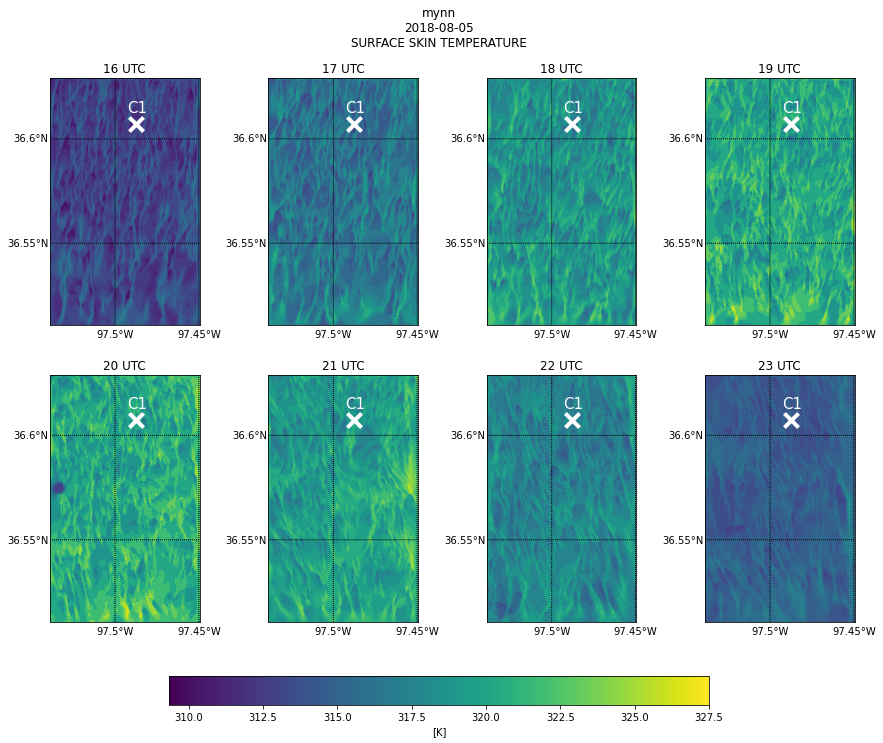

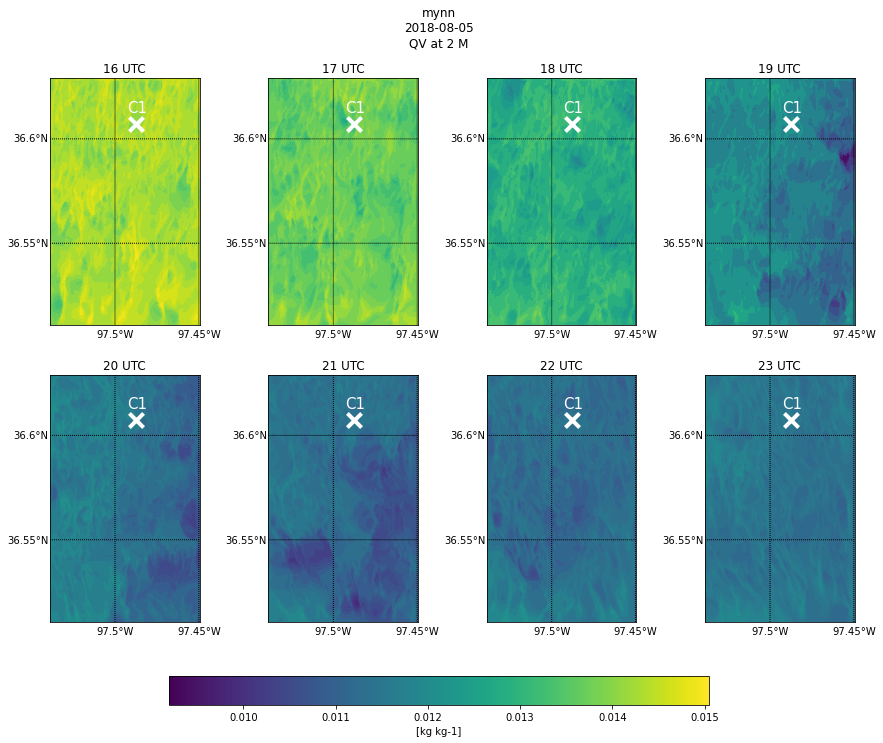

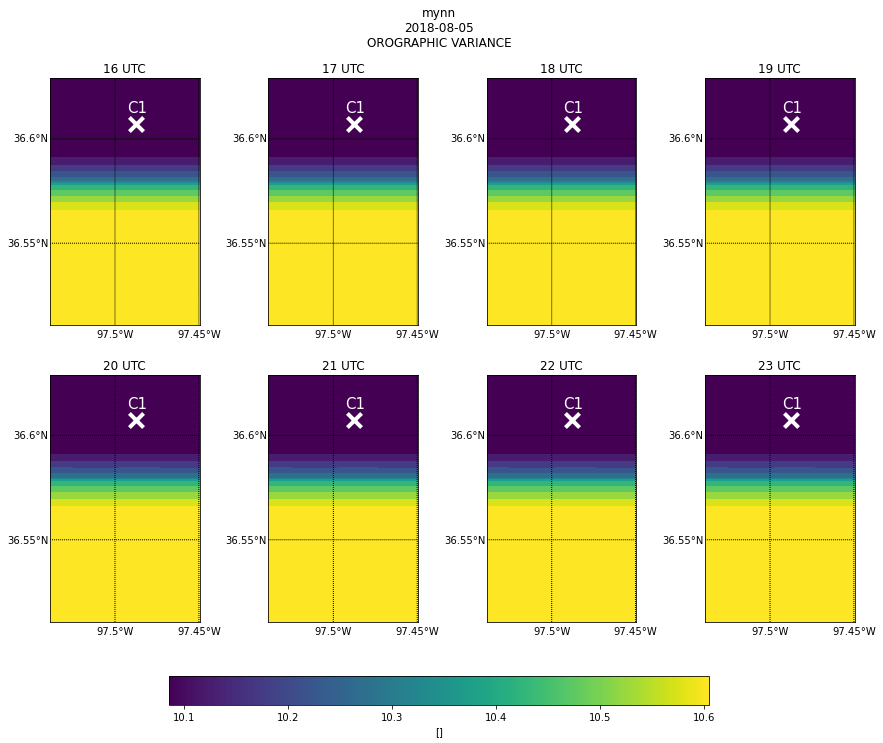

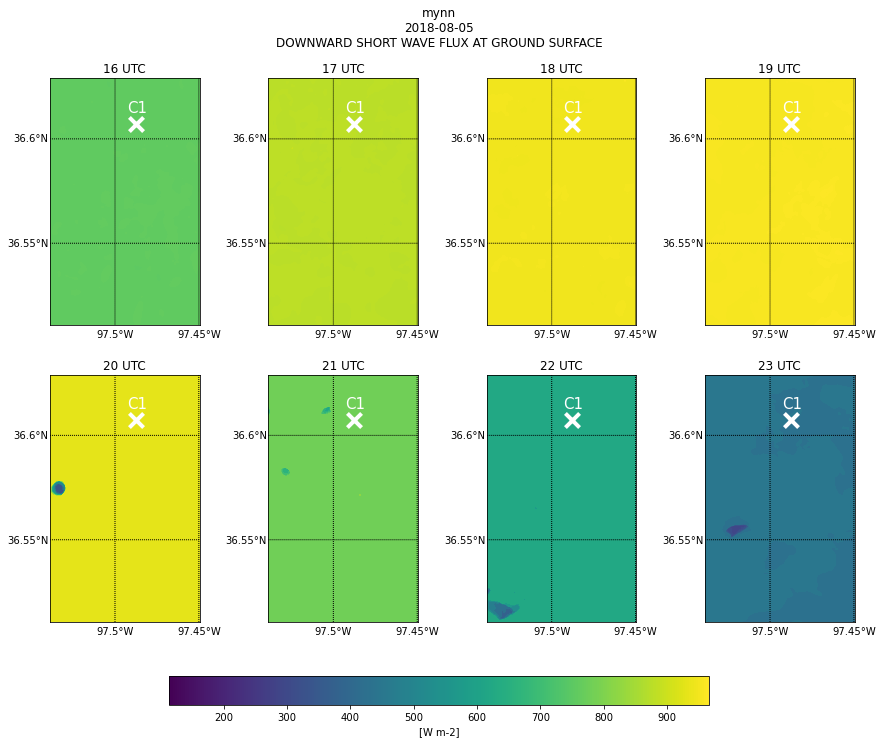

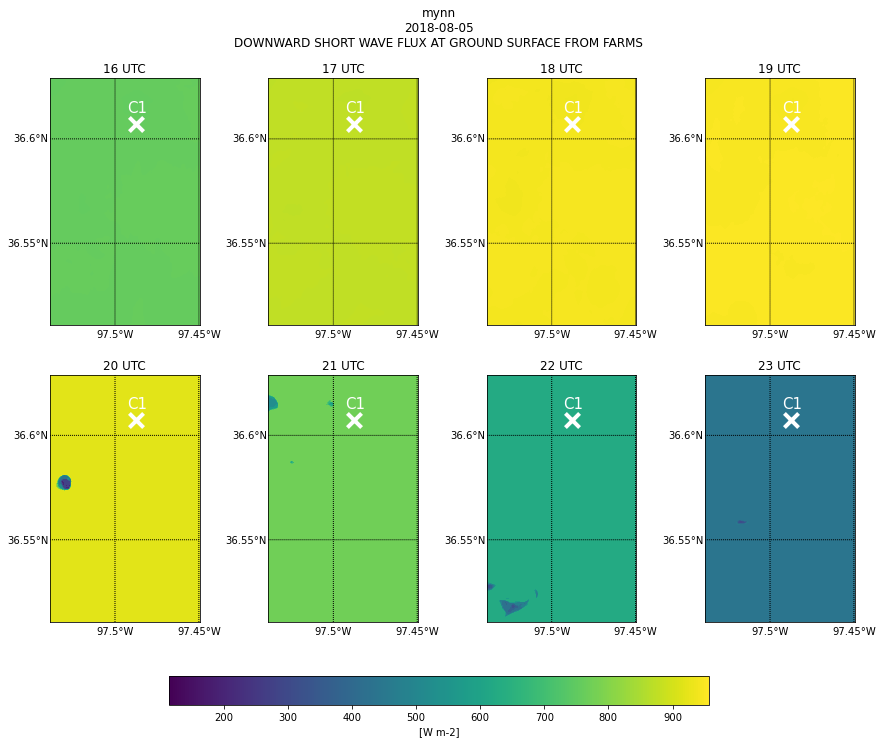

...

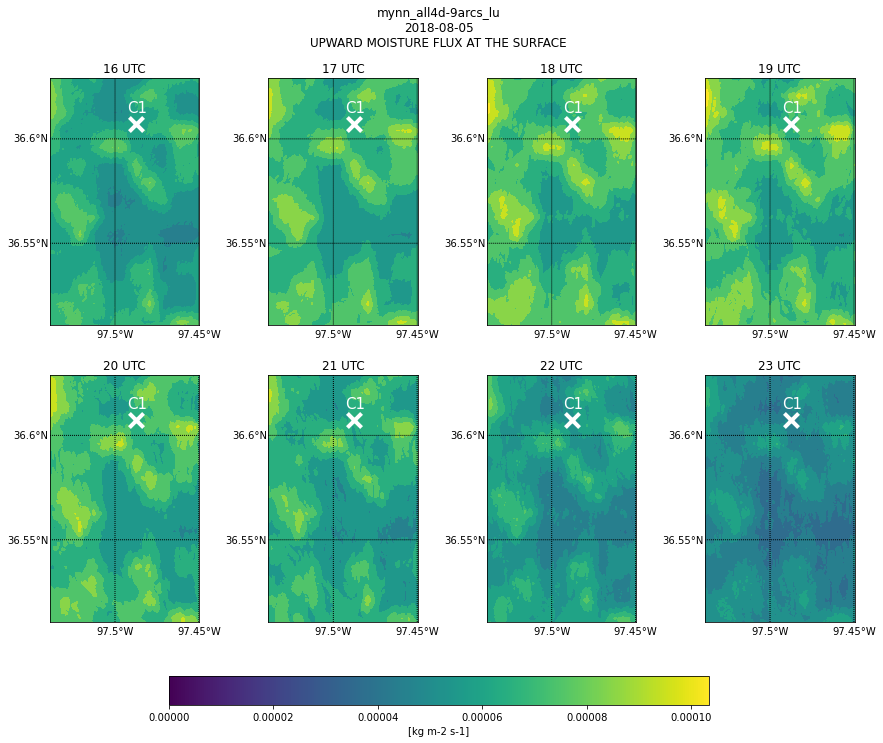

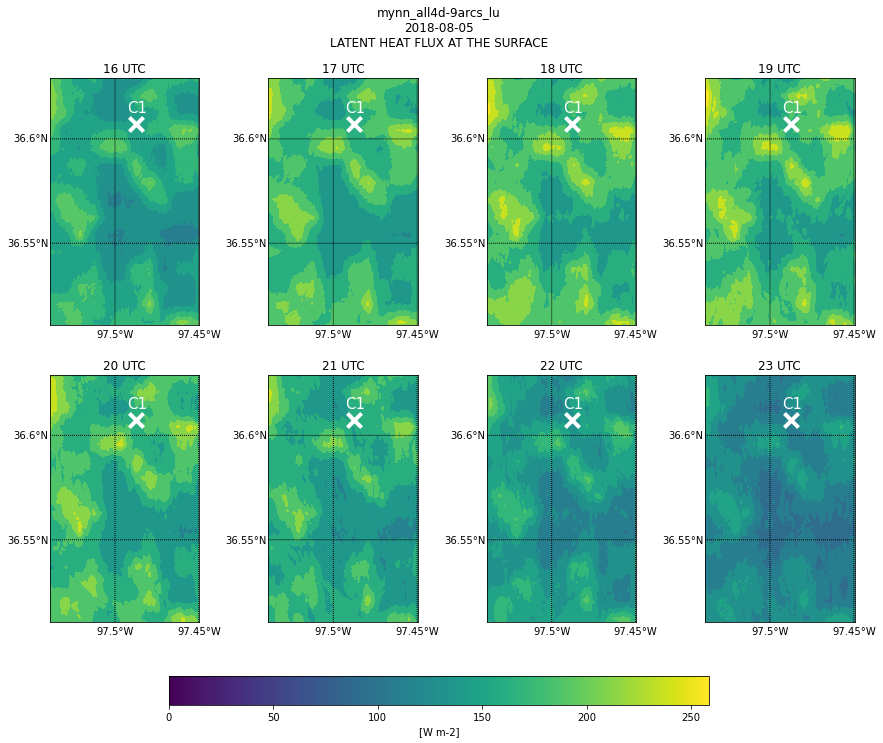

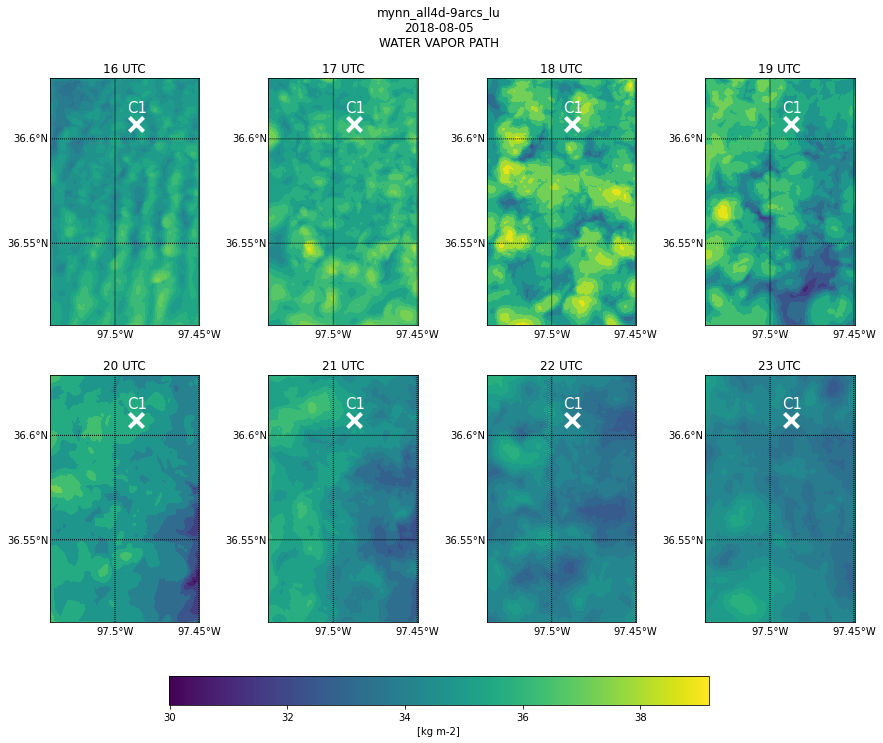

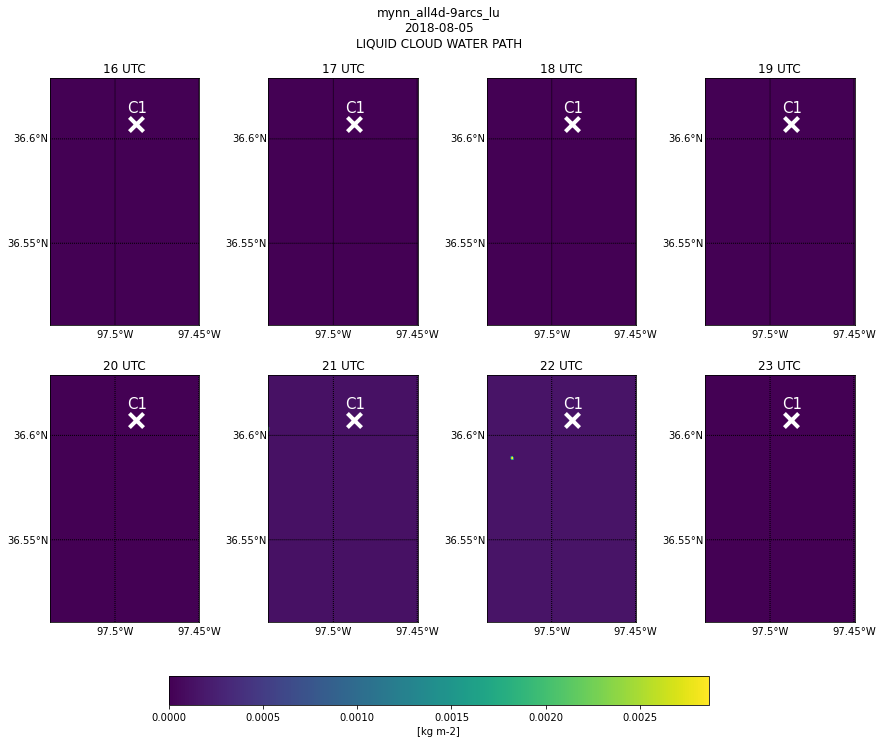

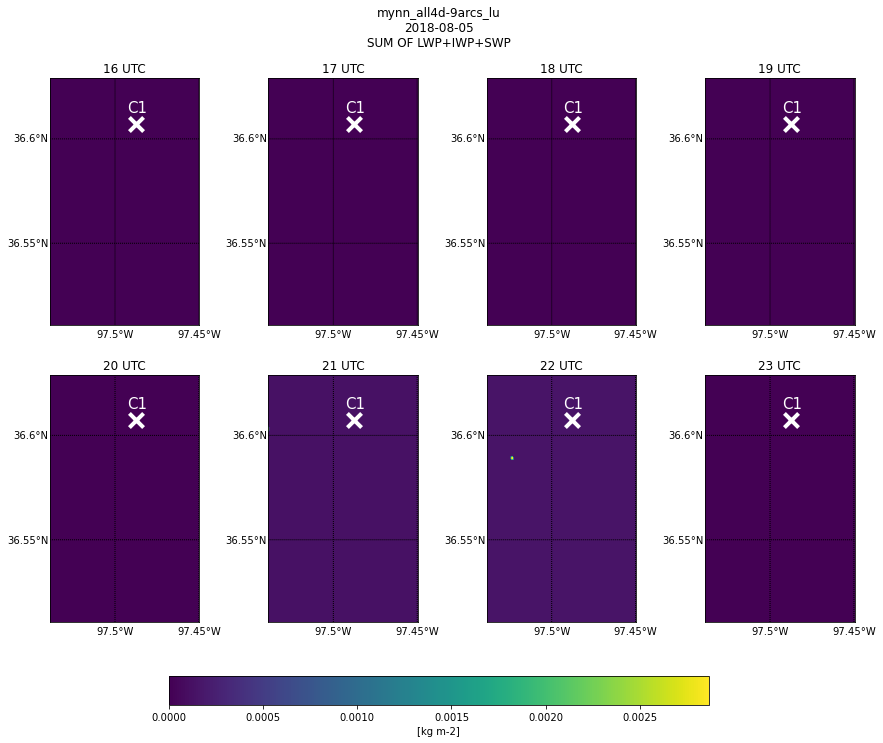

In [6]:
eval_date = '2018-08-05'
# run = 'mynn'
# wrf_var = 'HFX'
# plot_var = 'wspd'
var_list = ['TSK', 'Q2', 'VAR', 'SWDOWN', 'SWDOWN2', 'SWNORM', 'UST', 
            'HFX', 'QFX', 'LH', 'WVP', 'LWP', 'WP_SUM']

for run in runs_list:
    for wrf_var in var_list:
        plot_1lev_contour(run, wrf_var)

In [437]:
eval_date = '2018-08-05'
run = 'mynn'
date_col = data_dir_df[eval_date]
hr = 20
file = wrf_runs_dir+date_col[run]+'/auxout/mmc_d04_'+eval_date+'_'+str(hr)+':00:00'
wrf_var = 'wspd_wdir'

wrf_single = Dataset(file, 'r')

var = wrf.getvar(wrf_single, wrf_var, timeidx=wrf.ALL_TIMES)
# print(np.unique(var.values))
# print(len(np.unique(var.values)))

var_subset = var.sel(wspd_wdir='wspd')[0, 0, :, :]

var_testa = var_subset.copy()

var_testa[:] = np.nan

for i in np.arange(2, len(var_subset['south_north'])-1): 
    for j in np.arange(2, len(var_subset['west_east'])-1): 
        var_testa[i, j] = var_subset[i-2:i+2, j-2:j+2].std()

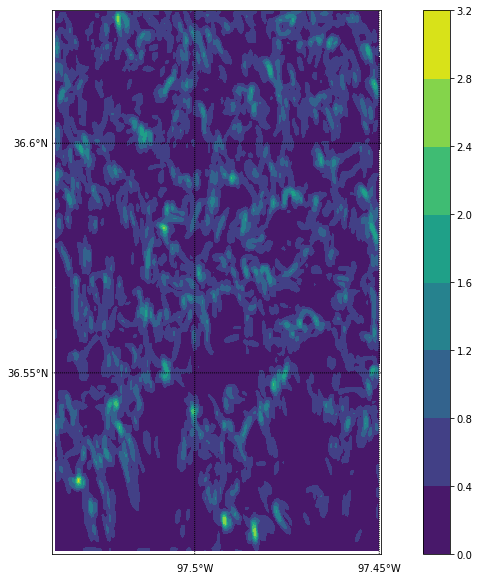

In [438]:
fig, axs = plt.subplots(figsize=(15, 10))

bm = wrf.get_basemap(var_testa, ax=axs)

bm.drawparallels(np.arange(36, 37, 0.05), labels=[1, 0, 0, 0])
bm.drawmeridians(np.arange(-98, -97, 0.05), labels=[0, 0, 0, 1])

x, y = bm(wrf.to_np(lons), wrf.to_np(lats))

p = bm.contourf(x, y, wrf.to_np(var_testa), cmap=get_cmap('viridis'))
cb = plt.colorbar(p, orientation='vertical')

In [435]:
eval_date = '2018-08-05'
run = 'mynn_d12-9s_d34-1s_lu'
date_col = data_dir_df[eval_date]
hr = 20
file = wrf_runs_dir+date_col[run]+'/auxout/mmc_d04_'+eval_date+'_'+str(hr)+':00:00'
wrf_var = 'wspd_wdir'

wrf_single = Dataset(file, 'r')

var = wrf.getvar(wrf_single, wrf_var, timeidx=wrf.ALL_TIMES)
# print(np.unique(var.values))
# print(len(np.unique(var.values)))

var_subset = var.sel(wspd_wdir='wspd')[0, 0, :, :]

var_test = var_subset.copy()

var_test[:] = np.nan

for i in np.arange(2, len(var_subset['south_north'])-1): 
    for j in np.arange(2, len(var_subset['west_east'])-1): 
        var_test[i, j] = var_subset[i-2:i+2, j-2:j+2].std()

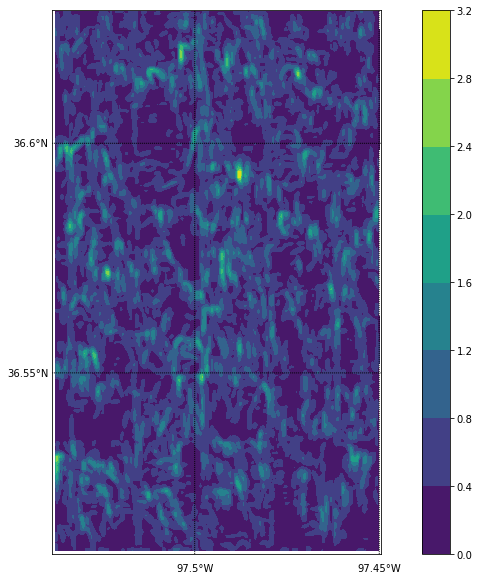

In [439]:
fig, axs = plt.subplots(figsize=(15, 10))

bm = wrf.get_basemap(var_test, ax=axs)

bm.drawparallels(np.arange(36, 37, 0.05), labels=[1, 0, 0, 0])
bm.drawmeridians(np.arange(-98, -97, 0.05), labels=[0, 0, 0, 1])

x, y = bm(wrf.to_np(lons), wrf.to_np(lats))

p = bm.contourf(x, y, wrf.to_np(var_test), cmap=get_cmap('viridis'))
cb = plt.colorbar(p, orientation='vertical')

In [6]:
@njit()
def loop_std(var_arr, std_cellspan, var_std_arr):
    
    for t in range(var_arr.shape[0]): 
        for i in np.arange(std_cellspan, var_arr.shape[1]-(std_cellspan-1)): 
            for j in np.arange(std_cellspan, var_arr.shape[2]-(std_cellspan-1)): 
                var_std_arr[t, i, j] = var_arr[t, i-std_cellspan:i+std_cellspan, 
                                               j-std_cellspan:j+std_cellspan].std()
                
    return var_std_arr

def plot_8stdcontour_wswd(run, eval_date, wrf_var, plot_var, std_cellspan):
    
    date_col = data_dir_df[eval_date]

    for ind, hr in enumerate(np.arange(16, 24, 1)): 

        file = wrf_runs_dir+date_col[run]+'/auxout/mmc_d04_'+eval_date+'_'+str(hr)+':00:00'
        wrf_single = Dataset(file, 'r')

        var = wrf.getvar(wrf_single, wrf_var, timeidx=wrf.ALL_TIMES)

        if wrf_var == 'wspd_wdir':
            # ~ hub height
            height = wrf.getvar(wrf_single, 'height_agl').mean(dim=['south_north', 'west_east'])[16]
            height_str = str(int(height.values))
            var = var.isel(bottom_top=16)
        if wrf_var == 'wspd_wdir10':
            height_str = '10'

        if ind == 0: 
            var_all = var
        else: 
            var_all = xr.concat([var_all, var], dim='Time')

    lats, lons = wrf.latlon_coords(var_all)

    fig, (axs1, axs2) = plt.subplots(2, 4, figsize=(15, 10))

    time_list = pd.date_range(start=eval_date+'-16', end=eval_date+'-23', periods=8)

    var_subset = var_all.sel(Time=time_list, wspd_wdir=plot_var)

    var_std = var_subset.copy()
    var_std[:] = np.nan

    var_arr = var_subset.values
    var_std_arr = var_std.values
    var_std_arr = loop_std(var_arr, std_cellspan, var_std_arr)
    
#     for t, _ in enumerate(time_list): 
#         for i in np.arange(std_cellspan, len(var_subset['south_north'])-(std_cellspan-1)): 
#             for j in np.arange(std_cellspan, len(var_subset['west_east'])-(std_cellspan-1)): 
#                 var_std[t, i, j] = var_subset[t, i-std_cellspan:i+std_cellspan, 
#                                               j-std_cellspan:j+std_cellspan].std()

    #     print(var_subset)
    v_min = var_std.min()
    v_max = var_std.max()

    for ind, time in enumerate(time_list):

    #     print(time)
        var_1time = var_std.sel(Time=time)

        if ind <= 3: 
            axs = axs1
        else: 
            axs = axs2
            ind -= 4

        bm = wrf.get_basemap(var_1time, ax=axs[ind])

        bm.drawparallels(np.arange(36, 37, 0.05), labels=[1, 0, 0, 0])
        bm.drawmeridians(np.arange(-98, -97, 0.05), labels=[0, 0, 0, 1])

        x, y = bm(wrf.to_np(lons), wrf.to_np(lats))

        p = bm.contourf(x, y, wrf.to_np(var_1time), 10, cmap=get_cmap('viridis'), 
                        vmin=v_min, vmax=v_max)

    #         print(time.hour, time.minute)
#         axs[ind].set_title(str(time.hour)+' UTC; median = '+str(np.round(var_1time.median().values, 3))
#                            +'\n mean = '+str(np.round(var_1time.mean().values, 3)))
        axs[ind].set_title(str(time.hour)+' UTC; median = '+str(np.round(var_1time.median().values, 3)))

        c1x, c1y = bm(wrf.to_np(-97.487643), wrf.to_np(36.607322))
        bm.scatter(c1x, c1y, s=200, marker='x', color='white', linewidth=4, ax=axs[ind])

        c1x, c1y = bm(wrf.to_np(-97.493), wrf.to_np(36.613))
        axs[ind].annotate('C1', xy=(c1x, c1y), size=15, color='white')

    if plot_var == 'wspd':
        units = r'[m s$^{-1}$]'
    if plot_var == 'wdir':
        units = '[deg]'

    # plt.subplots_adjust(bottom=0.1)
    cax = plt.axes([0.25, 0.01, 0.5, 0.04])
    sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=v_min, vmax=v_max))
    cb = plt.colorbar(sm, cax=cax, orientation='horizontal', label=units)
    #     cb.title('m/s')

    num_cell = ((std_cellspan*2)+1)**2
    
    plt.suptitle(run+'\n'+eval_date+'\n'+plot_var+' standard deviation in '+str(num_cell)
                 +' grid cells @ '+height_str+' m agl')

    plt.show()

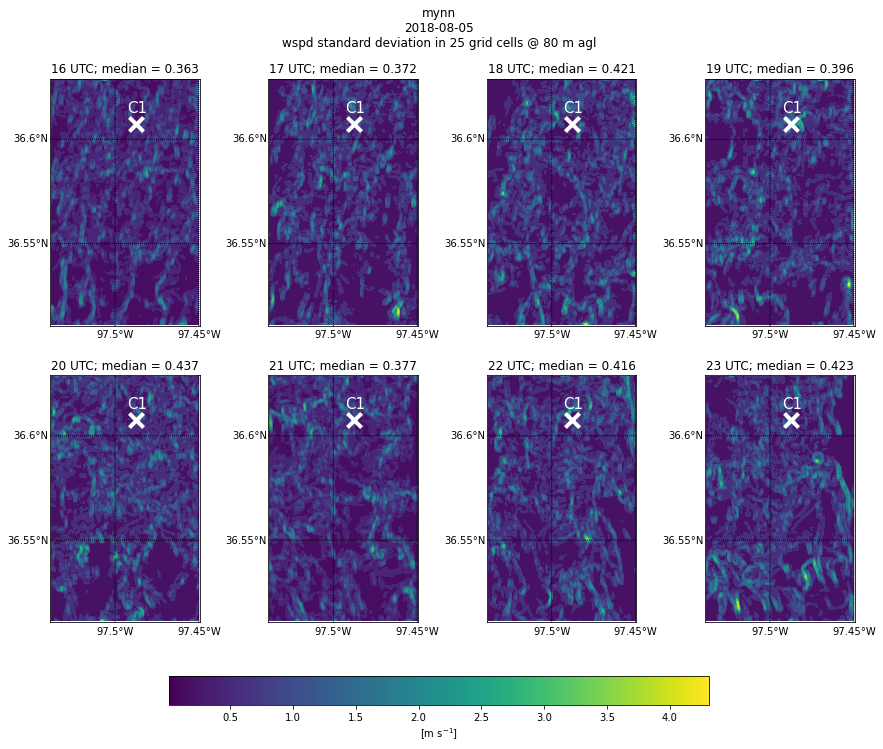

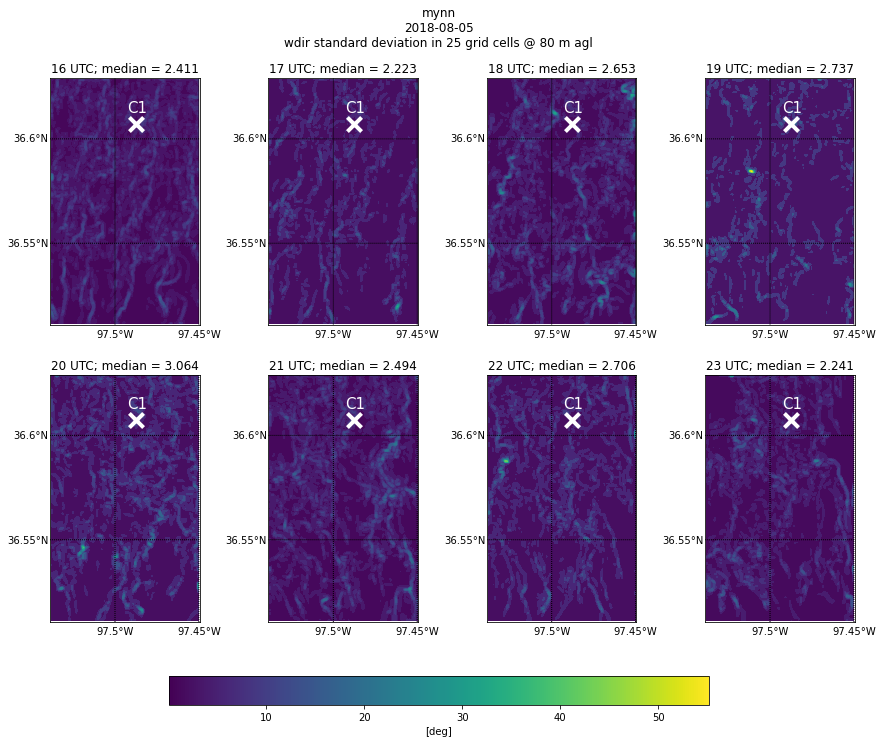

In [7]:
eval_date = '2018-08-05'
# run = 'mynn'
# wrf_var = 'wspd_wdir10'
# plot_var = 'wspd'
std_cellspan = 2
# date_col = data_dir_df[eval_date]

for run in runs_list[:1]:
    for wrf_var in ['wspd_wdir']:
        plot_8stdcontour_wswd(run, eval_date, wrf_var, 'wspd', std_cellspan)
        plot_8stdcontour_wswd(run, eval_date, wrf_var, 'wdir', std_cellspan)
#         plot_8stdcontour_wswd(run, wrf_var, 'wdir')

#         plot_8stdcontour_wswd.parallel_diagnostics(level=4)

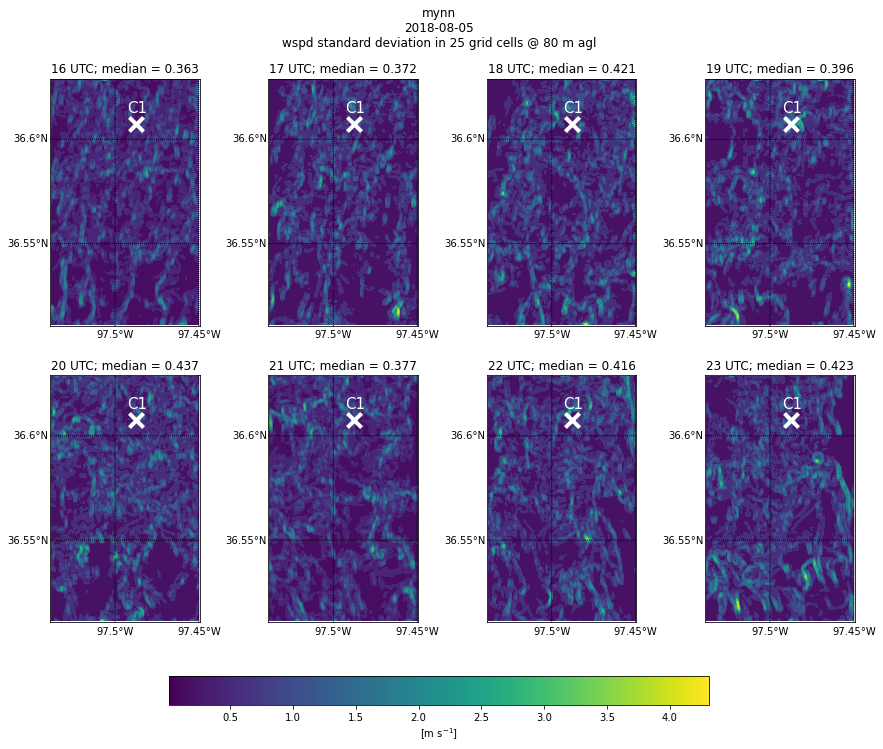

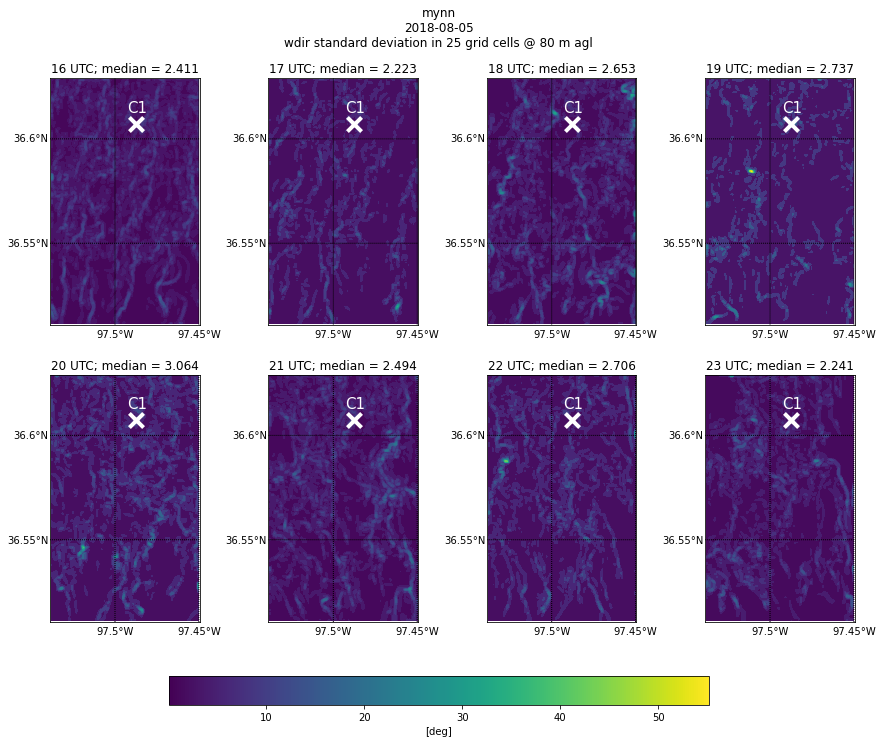

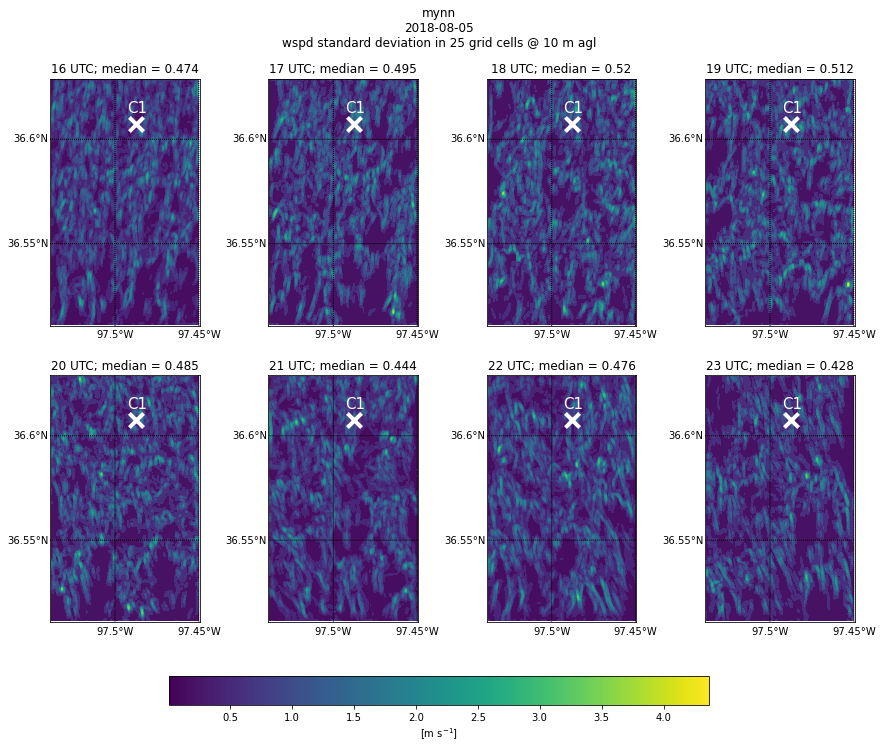

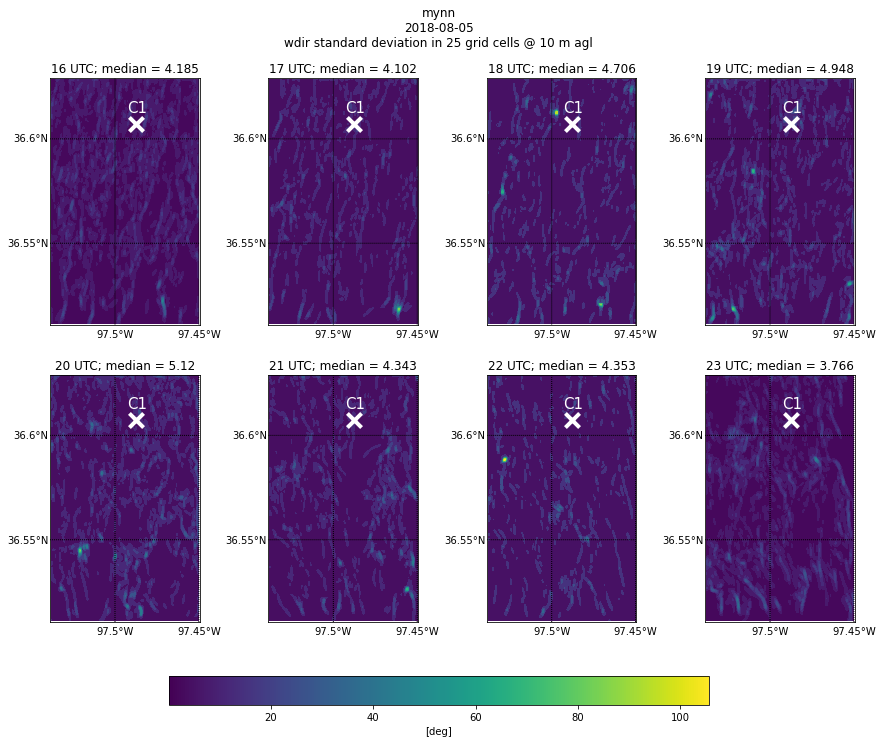

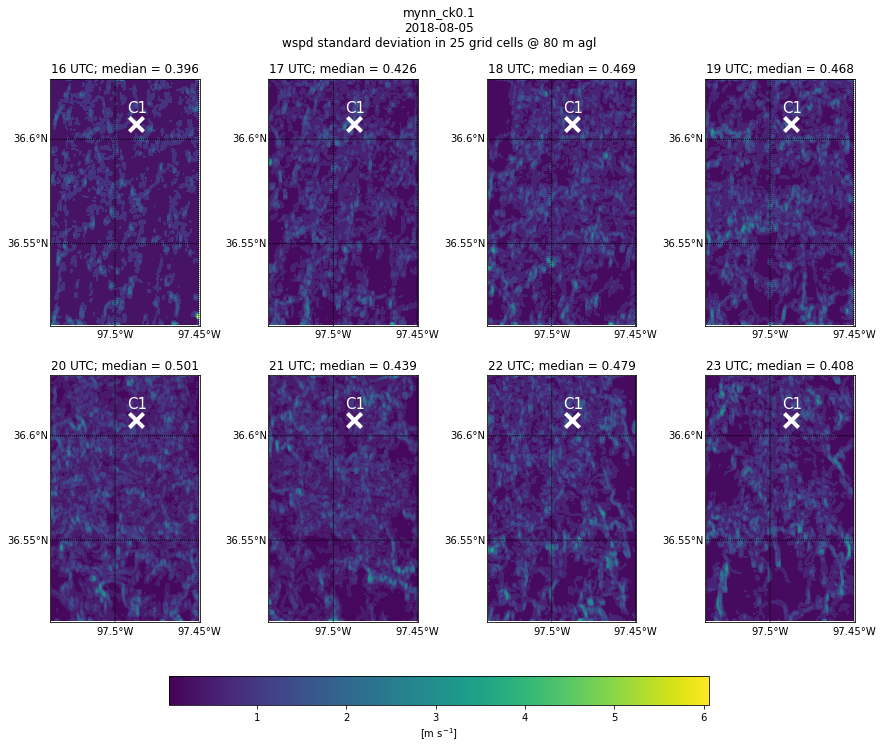

...

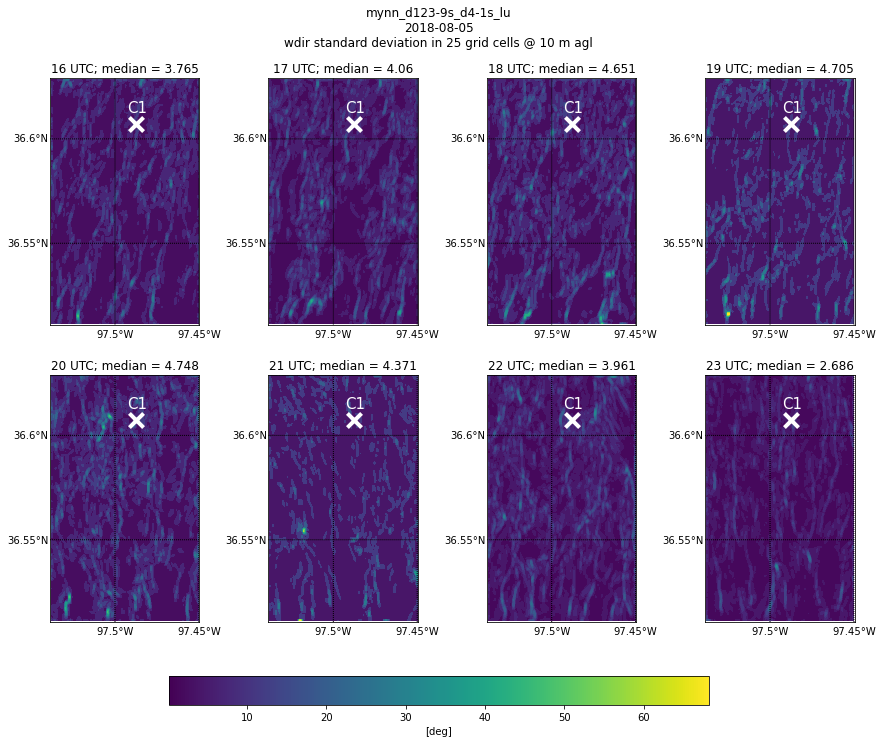

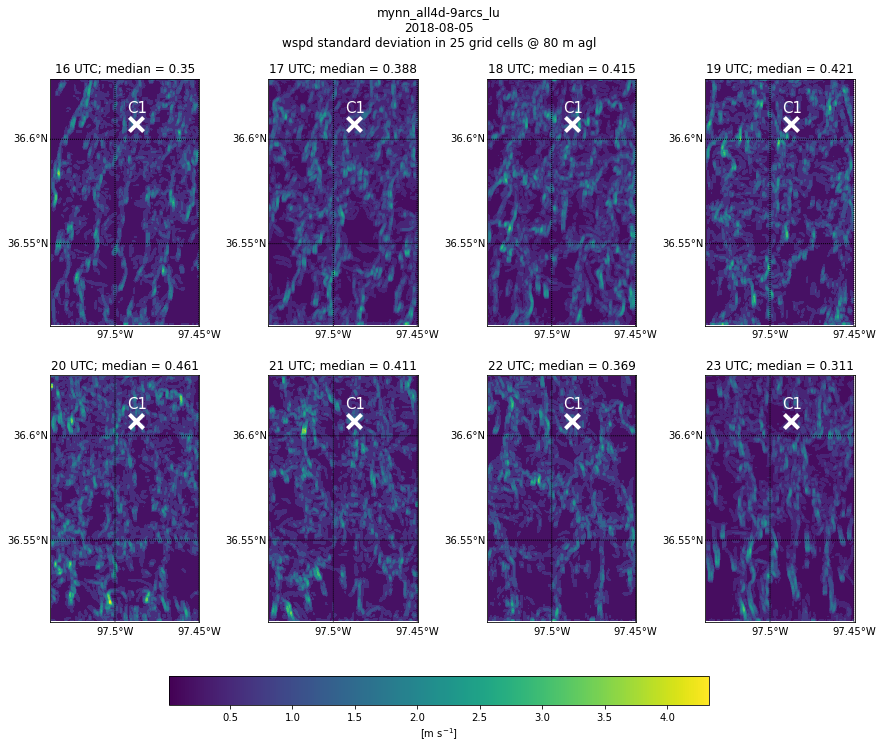

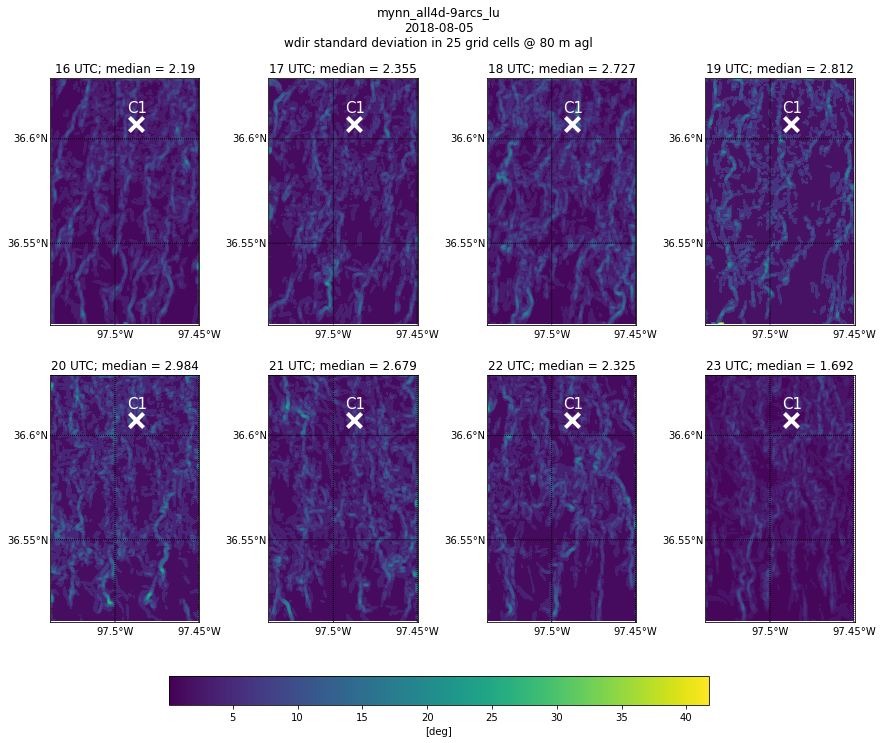

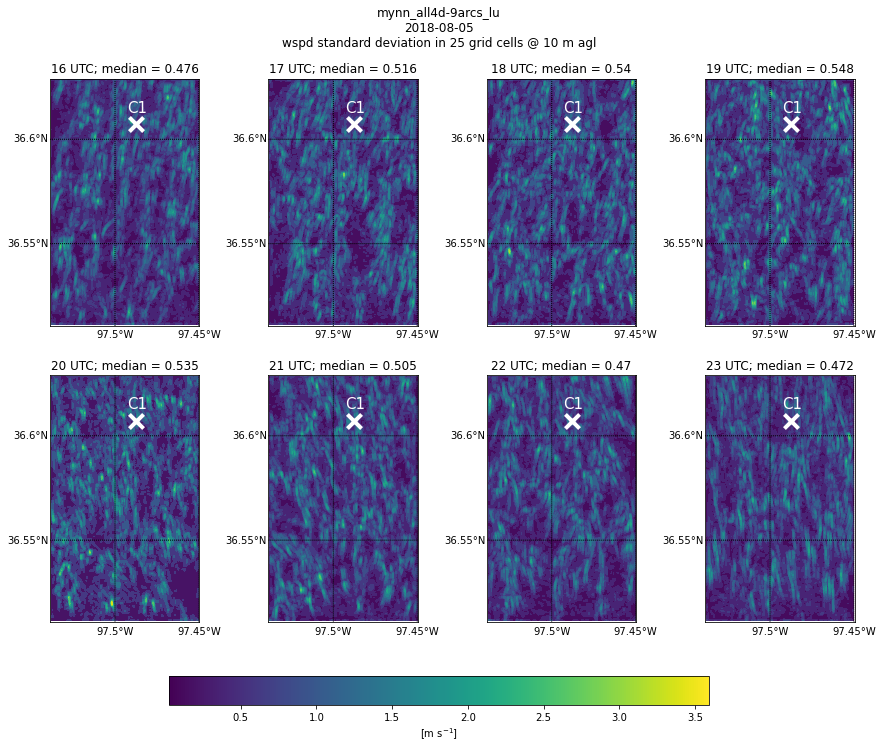

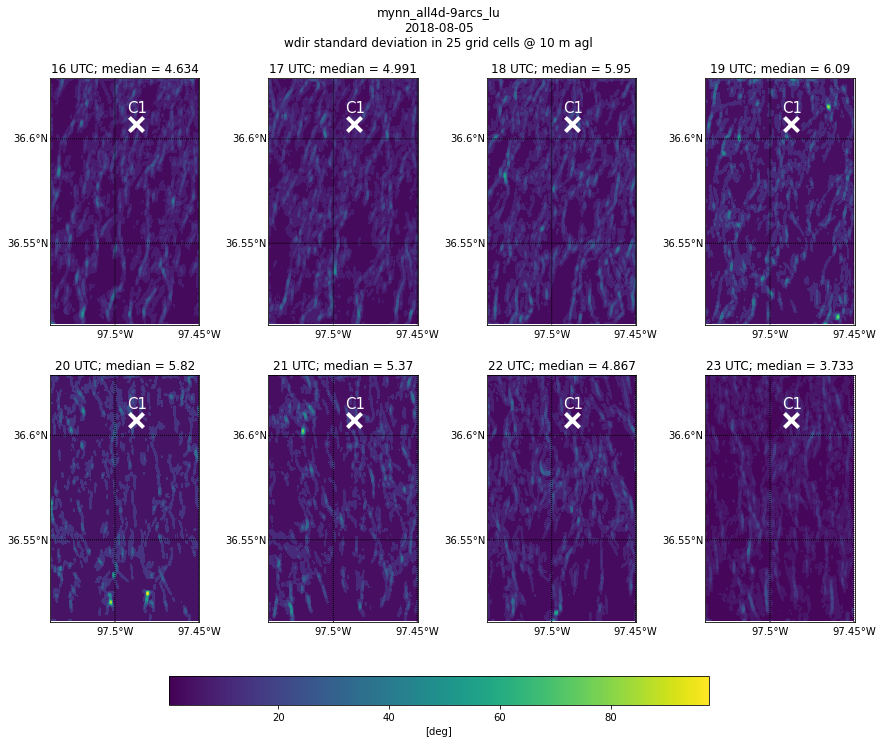

In [8]:
eval_date = '2018-08-05'
# run = 'mynn'
# wrf_var = 'wspd_wdir10'
# plot_var = 'wspd'
std_cellspan = 2

for run in runs_list:
    for wrf_var in ['wspd_wdir', 'wspd_wdir10']:
        plot_8stdcontour_wswd(run, eval_date, wrf_var, 'wspd', std_cellspan)
        plot_8stdcontour_wswd(run, eval_date, wrf_var, 'wdir', std_cellspan)

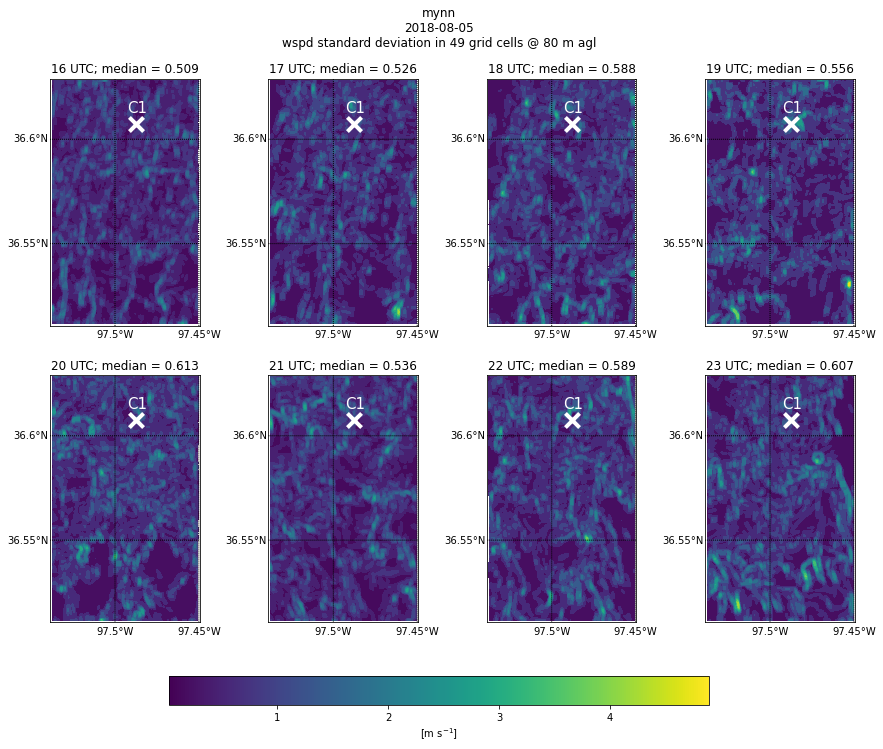

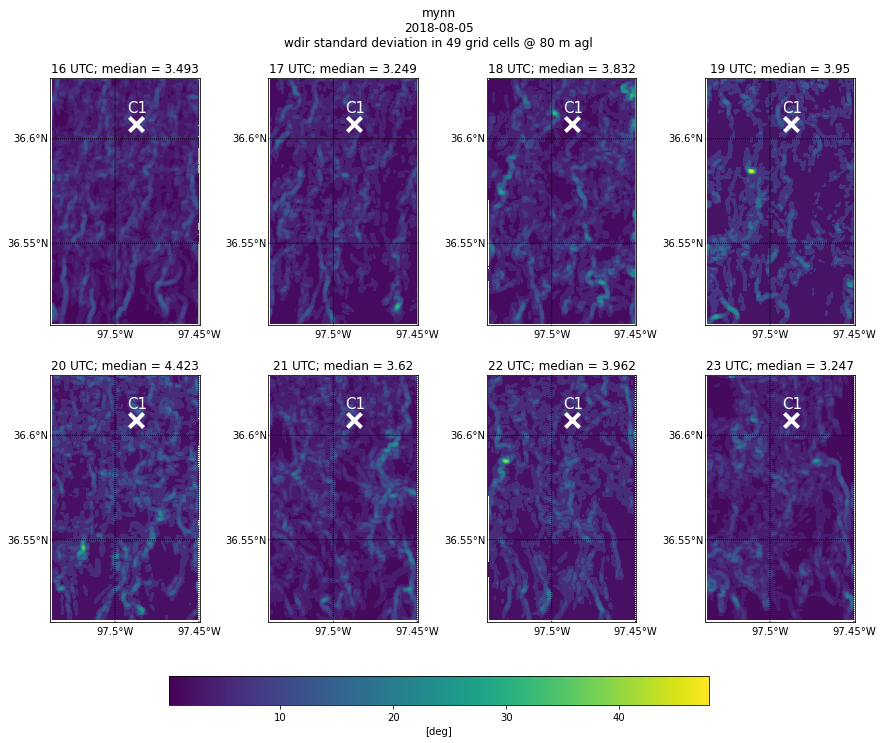

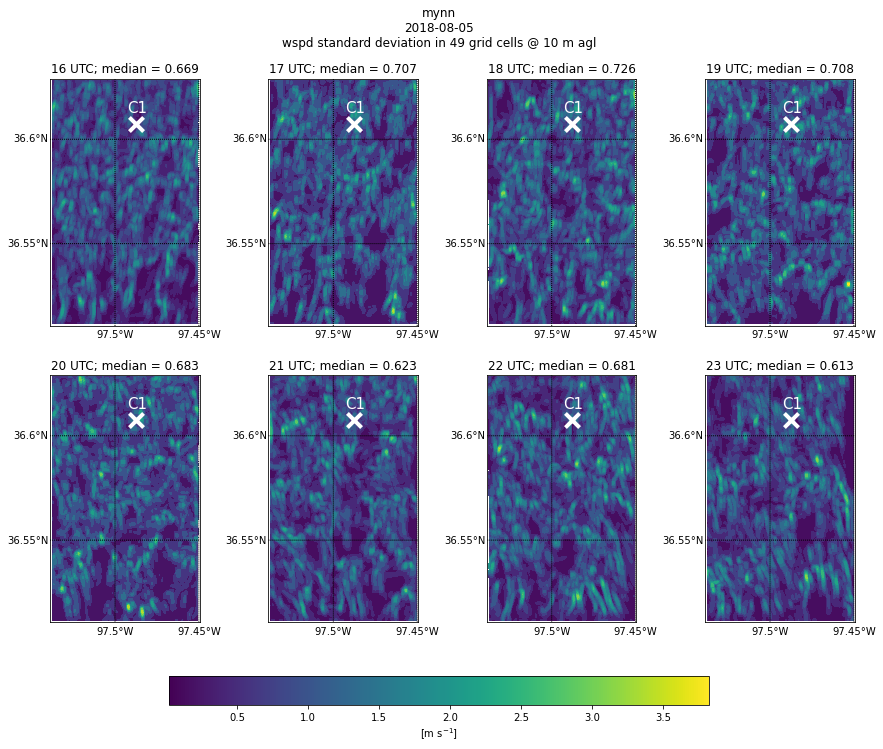

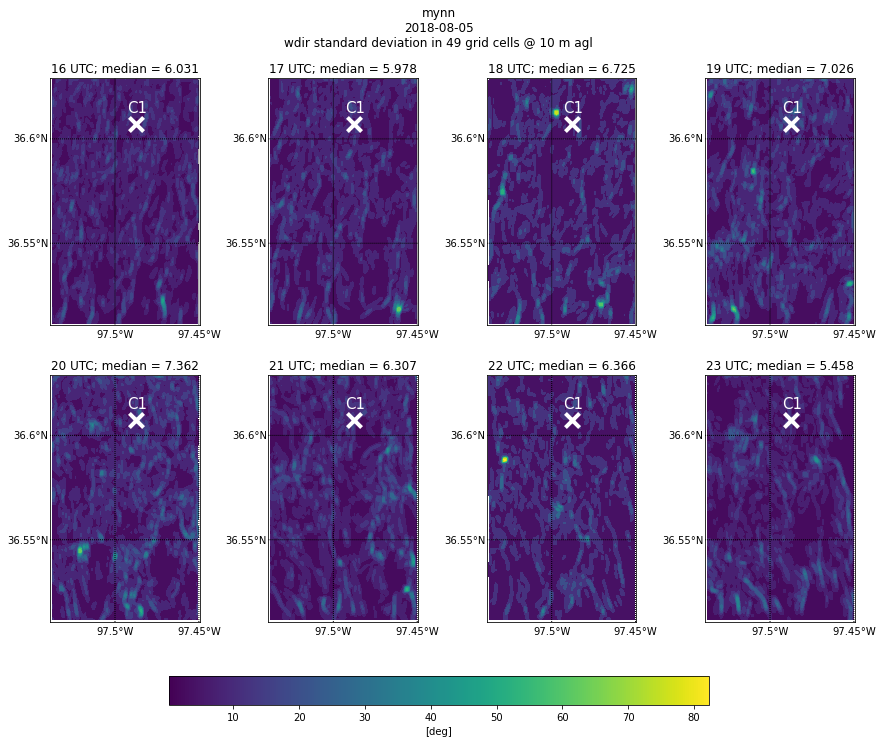

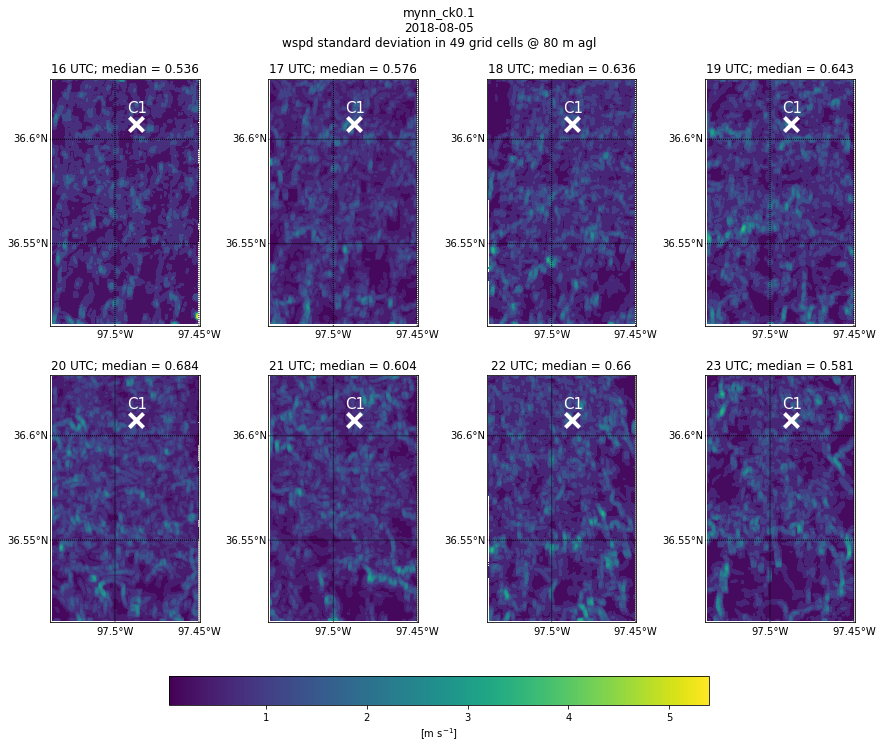

...

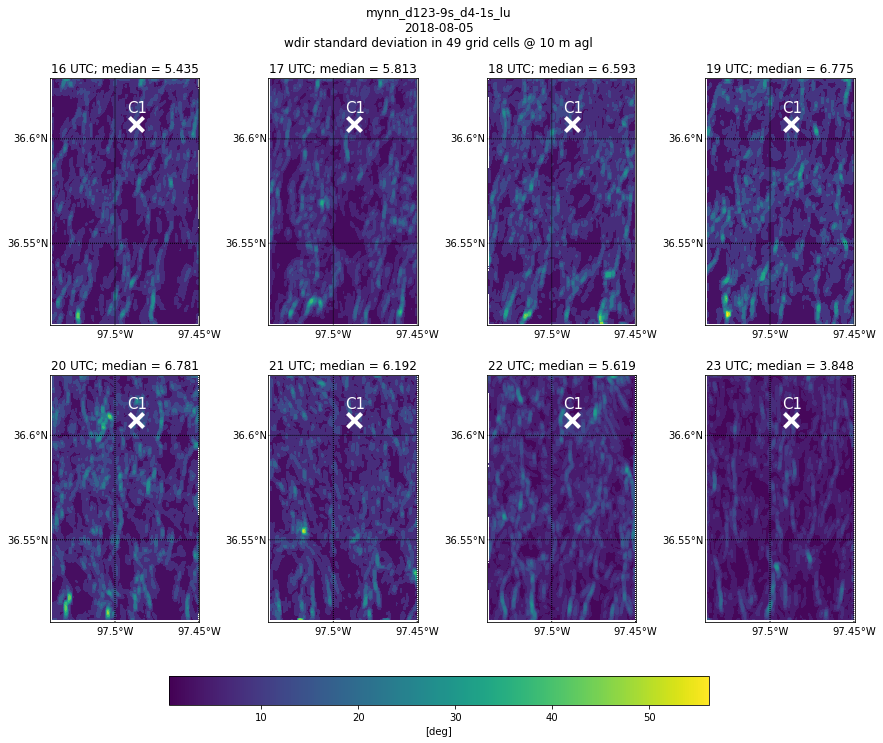

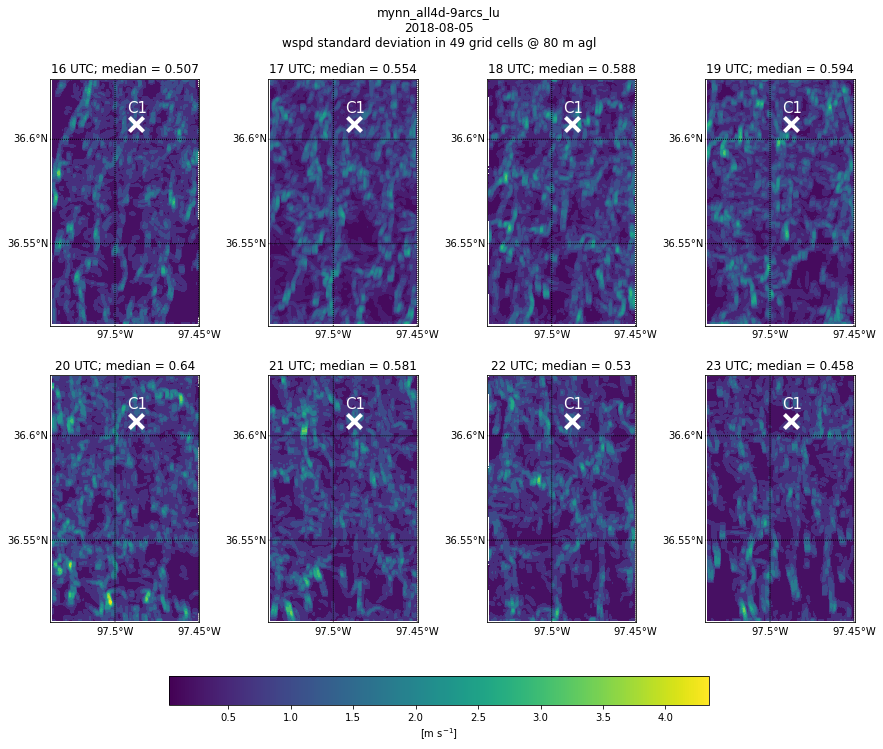

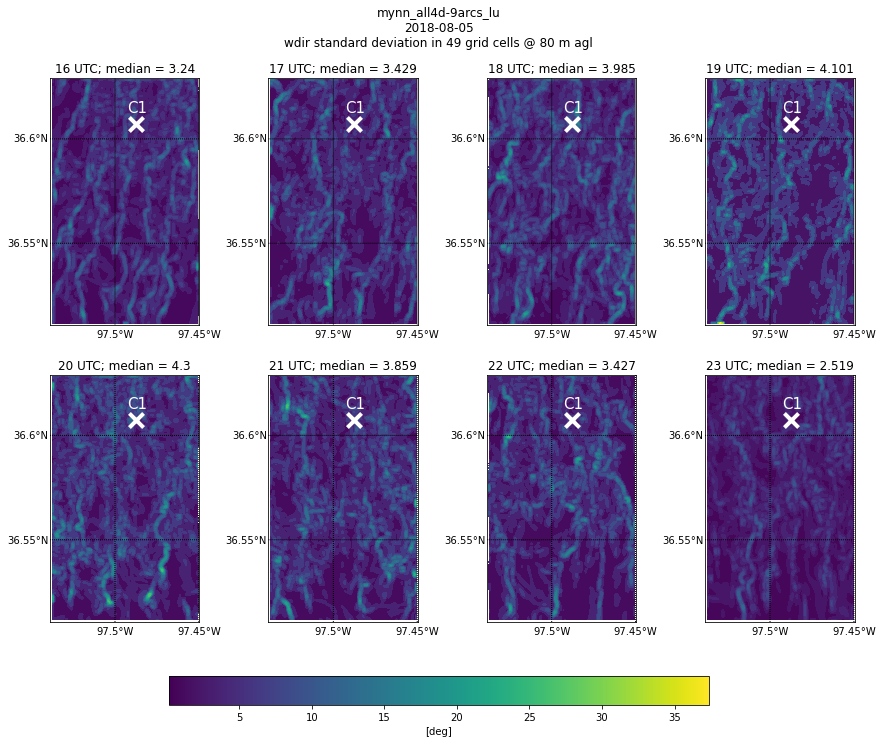

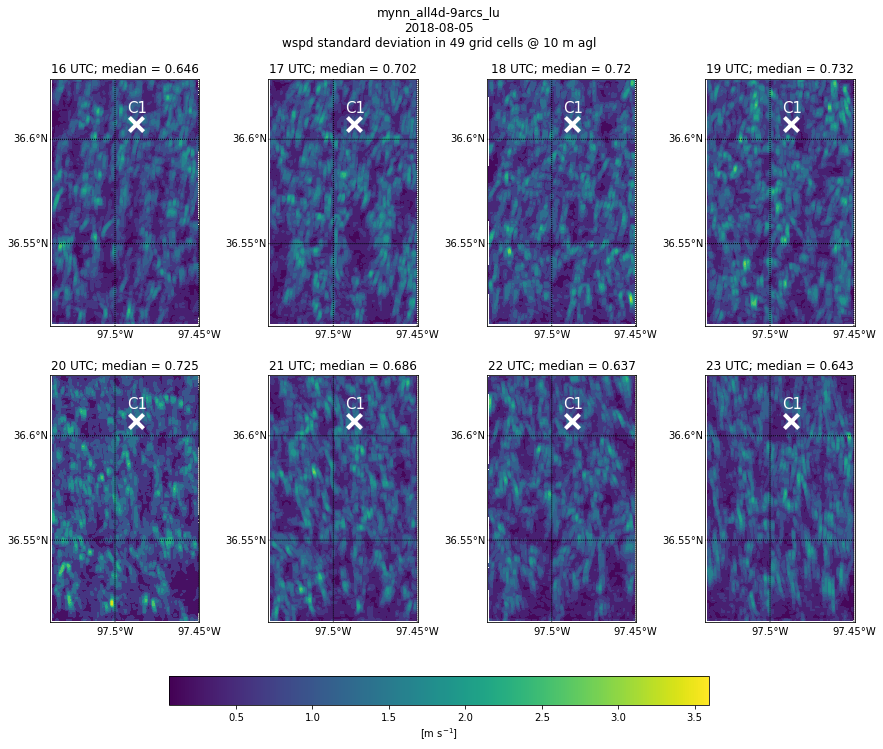

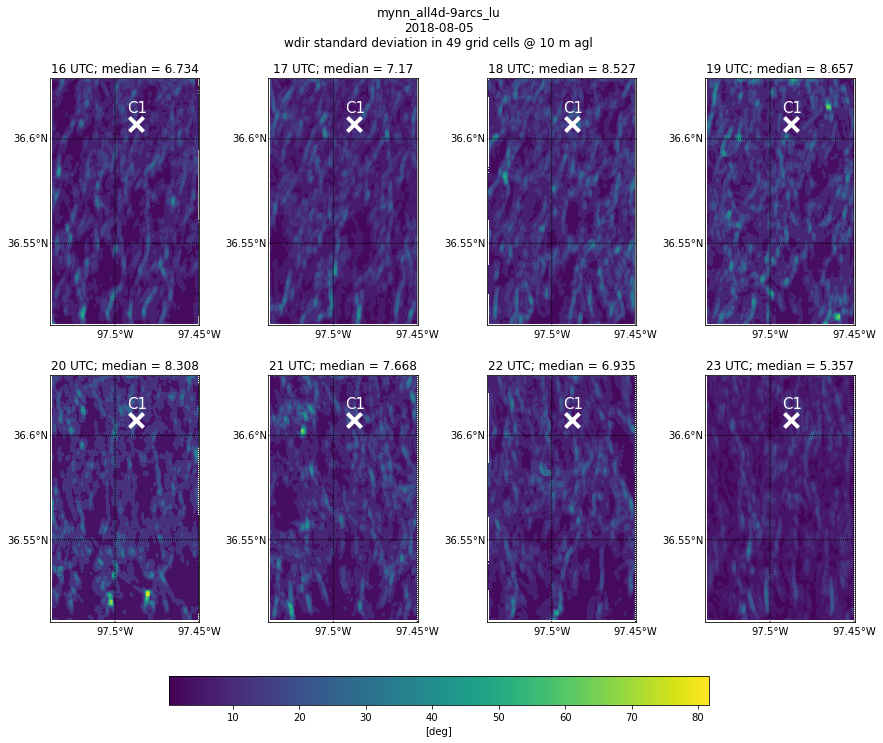

In [9]:
eval_date = '2018-08-05'
# run = 'mynn'
# wrf_var = 'wspd_wdir10'
# plot_var = 'wspd'
std_cellspan = 3

for run in runs_list:
    for wrf_var in ['wspd_wdir', 'wspd_wdir10']:
        plot_8stdcontour_wswd(run, eval_date, wrf_var, 'wspd', std_cellspan)
        plot_8stdcontour_wswd(run, eval_date, wrf_var, 'wdir', std_cellspan)

In [3]:
@njit()
def loop_std(var_arr, std_cellspan, var_std_arr):
    
    for t in range(var_arr.shape[0]): 
        for i in np.arange(std_cellspan, var_arr.shape[1]-(std_cellspan-1)): 
            for j in np.arange(std_cellspan, var_arr.shape[2]-(std_cellspan-1)): 
                var_std_arr[t, i, j] = var_arr[t, i-std_cellspan:i+std_cellspan, 
                                               j-std_cellspan:j+std_cellspan].std()
                
#     return var_std_arr

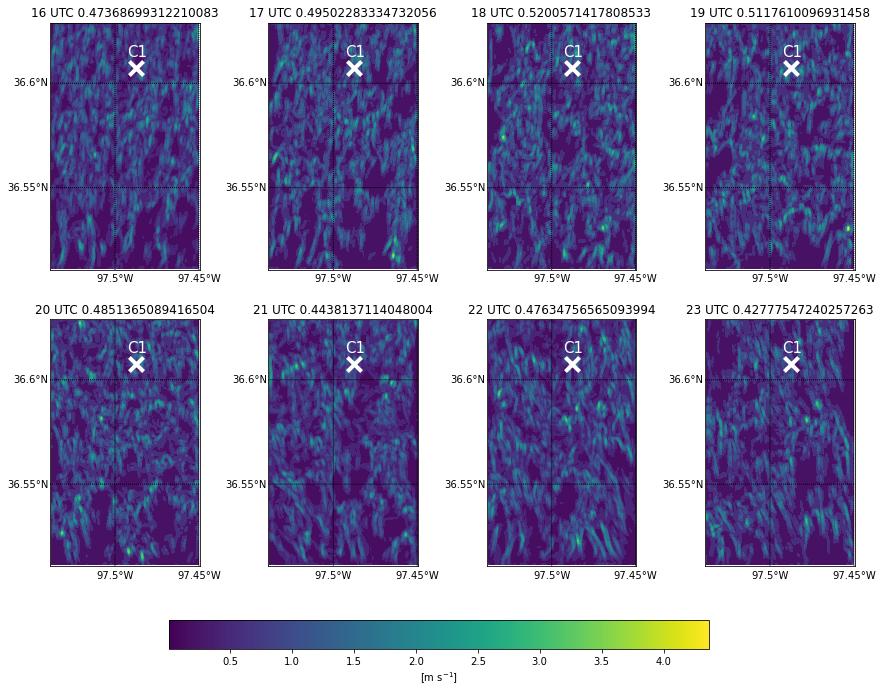

In [5]:
eval_date = '2018-08-05'
run = 'mynn'
wrf_var = 'wspd_wdir10'
plot_var = 'wspd'
std_cellspan = 2

# for run in runs_list[:1]:
#     for wrf_var in ['wspd_wdir']:
# plot_8contour_wswd_std(run, wrf_var, 'wspd')
#         plot_8contour_wswd(run, wrf_var, 'wdir')

date_col = data_dir_df[eval_date]

for ind, hr in enumerate(np.arange(16, 24, 1)): 

    file = wrf_runs_dir+date_col[run]+'/auxout/mmc_d04_'+eval_date+'_'+str(hr)+':00:00'
    wrf_single = Dataset(file, 'r')

    var = wrf.getvar(wrf_single, wrf_var, timeidx=wrf.ALL_TIMES)

    if wrf_var == 'wspd_wdir':
        # ~ hub height
        height = wrf.getvar(wrf_single, 'height_agl').mean(dim=['south_north', 'west_east'])[16]
        # missing QVAPOR -- cannot use this
        # wrf.vinterp(wrf_single, var_u, vert_coord='ght_agl', interp_levels=[80])
        height_str = str(int(height.values))
        var = var.isel(bottom_top=16)
    if wrf_var == 'wspd_wdir10':
        height_str = '10'

    if ind == 0: 
        var_all = var
    else: 
        var_all = xr.concat([var_all, var], dim='Time')

lats, lons = wrf.latlon_coords(var_all)

fig, (axs1, axs2) = plt.subplots(2, 4, figsize=(15, 10))

# time_list = pd.date_range(start=eval_date+'-16', end=eval_date+'-19', periods=4)
time_list = pd.date_range(start=eval_date+'-16', end=eval_date+'-23', periods=8)

var_subset = var_all.sel(Time=time_list, wspd_wdir=plot_var)

var_std = var_subset.copy()
var_std[:] = np.nan

# for t, _ in enumerate(time_list): 
#     for i in np.arange(2, len(var_subset['south_north'])-1): 
#         for j in np.arange(2, len(var_subset['west_east'])-1): 
#             var_std[t, i, j] = var_subset[t, i-2:i+2, j-2:j+2].std()

#     print(var_subset)

var_arr = var_subset.values
var_std_arr = var_std.values
test = loop_std(var_arr, std_cellspan, var_std_arr)

v_min = var_std.min()
v_max = var_std.max()

for ind, time in enumerate(time_list):

#     print(time)
    var_1time = var_std.sel(Time=time)

    if ind <= 3: 
        axs = axs1
    else: 
        axs = axs2
        ind -= 4

#         var_std = var_1time.copy()

#         var_std[:] = np.nan

#         for i in np.arange(2, len(var_1time['south_north'])-1): 
#             for j in np.arange(2, len(var_1time['west_east'])-1): 
#                 var_std[i, j] = var_1time[i-2:i+2, j-2:j+2].std()

    bm = wrf.get_basemap(var_1time, ax=axs[ind])

    bm.drawparallels(np.arange(36, 37, 0.05), labels=[1, 0, 0, 0])
    bm.drawmeridians(np.arange(-98, -97, 0.05), labels=[0, 0, 0, 1])

    x, y = bm(wrf.to_np(lons), wrf.to_np(lats))

    p = bm.contourf(x, y, wrf.to_np(var_1time), 10, cmap=get_cmap('viridis'), 
                    vmin=v_min, vmax=v_max)

#         print(time.hour, time.minute)
    axs[ind].set_title(str(time.hour)+' UTC '+str(var_1time.median().values))

    c1x, c1y = bm(wrf.to_np(-97.487643), wrf.to_np(36.607322))
    bm.scatter(c1x, c1y, s=200, marker='x', color='white', linewidth=4, ax=axs[ind])

    c1x, c1y = bm(wrf.to_np(-97.493), wrf.to_np(36.613))
    axs[ind].annotate('C1', xy=(c1x, c1y), size=15, color='white')

if plot_var == 'wspd':
    units = r'[m s$^{-1}$]'
if plot_var == 'wdir':
    units = '[deg]'

cax = plt.axes([0.25, 0.01, 0.5, 0.04])
sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=v_min, vmax=v_max))
cb = plt.colorbar(sm, cax=cax, orientation='horizontal', label=units)
#     cb.title('m/s')

# plt.suptitle(run+'\n'+eval_date+'\n'+plot_var+' standard deviation in '+str(num_cell)
#              +' grid cells @ '+height_str+' m agl')

plt.show()

In [59]:
var_std = var_subset.copy()
var_std[:] = np.nan

In [61]:
var_arr = var_subset.values
var_std_arr = var_std.values
test = loop_std(var_arr, std_cellspan, var_std_arr)

In [62]:
var_std

<xarray.DataArray 'wspd_wdir10' (Time: 8, south_north: 330, west_east: 200)>
array([[[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan, 0.3088076 , ..., 0.42882207,
         0.4235778 ,        nan],
        ...,
        [       nan,        nan, 0.28226942, ..., 1.2734054 ,
         0.75151354,        nan],
        [       nan,        nan, 0.25784656, ..., 1.0478641 ,
         0.66598827,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan]],

       [[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan, 0.62657994, ..., 0.37080878,
         0.22558804,        nan],
...
        [       nan,        nan, 0.21006627, ..., 0.24986659,
         0.2744753 ,        nan],
        [       nan,        nan, 0.2514448 , ..., 0.26698598,
         0.25742453,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan]],

       [[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan, 0.3397105 , ..., 1.0354611 ,
         0.72160006,        nan],
        ...,
        [       nan,        nan, 0.11128374, ..., 0.13455327,
         0.11014918,        nan],
        [       nan,        nan, 0.11104727, ..., 0.19731273,
         0.1690558 ,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan]]], dtype=float32)
Coordinates:
    wspd_wdir  <U4 'wspd'
    XLONG      (south_north, west_east) float32 -97.54 -97.54 ... -97.45 -97.45
    XLAT       (south_north, west_east) float32 36.51 36.51 ... 36.63 36.63
    XTIME      (Time) float32 1.68e+03 1.74e+03 1.8e+03 ... 2.04e+03 2.1e+03
  * Time       (Time) datetime64[ns] 2018-08-05T16:00:00 ... 2018-08-05T23:00:00
Dimensions without coordinates: south_north, west_east
Attributes:
    FieldType:    104
    MemoryOrder:  XY 
    description:  10m wspd,wdir in projection space
    units:        m s-1
    stagger:      
    coordinates:  XLONG XLAT XTIME
    projection:   LambertConformal(stand_lon=-97.48758697509766, moad_cen_lat...

In [43]:
da = xr.DataArray(data=temperature, dims=["x", "y", "time"])

array([[[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan, 0.3088076 , ..., 0.42882207,
         0.4235778 ,        nan],
        ...,
        [       nan,        nan, 0.28226942, ..., 1.2734054 ,
         0.75151354,        nan],
        [       nan,        nan, 0.25784656, ..., 1.0478641 ,
         0.66598827,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan]],

       [[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan, 0.62657994, ..., 0.37080878,
         0.22558804,        nan],
        ...,
        [       nan,        nan, 0.16842219, ..., 0.24974953,
         0.21139023,        nan],
        [   

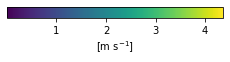

In [51]:
v_min = var_std.min()
v_max = var_std.max()

for ind, time in enumerate(time_list):

#     print(time)
    var_1time = var_std.sel(Time=time)

    if ind <= 3: 
        axs = axs1
    else: 
        axs = axs2
        ind -= 4

#         var_std = var_1time.copy()

#         var_std[:] = np.nan

#         for i in np.arange(2, len(var_1time['south_north'])-1): 
#             for j in np.arange(2, len(var_1time['west_east'])-1): 
#                 var_std[i, j] = var_1time[i-2:i+2, j-2:j+2].std()

    bm = wrf.get_basemap(var_1time, ax=axs[ind])

    bm.drawparallels(np.arange(36, 37, 0.05), labels=[1, 0, 0, 0])
    bm.drawmeridians(np.arange(-98, -97, 0.05), labels=[0, 0, 0, 1])

    x, y = bm(wrf.to_np(lons), wrf.to_np(lats))

    p = bm.contourf(x, y, wrf.to_np(var_1time), 10, cmap=get_cmap('viridis'), 
                    vmin=v_min, vmax=v_max)

#         print(time.hour, time.minute)
    axs[ind].set_title(str(time.hour)+' UTC '+str(var_1time.median().values))

    c1x, c1y = bm(wrf.to_np(-97.487643), wrf.to_np(36.607322))
    bm.scatter(c1x, c1y, s=200, marker='x', color='white', linewidth=4, ax=axs[ind])

    c1x, c1y = bm(wrf.to_np(-97.493), wrf.to_np(36.613))
    axs[ind].annotate('C1', xy=(c1x, c1y), size=15, color='white')

if plot_var == 'wspd':
    units = r'[m s$^{-1}$]'
if plot_var == 'wdir':
    units = '[deg]'

cax = plt.axes([0.25, 0.01, 0.5, 0.04])
sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=v_min, vmax=v_max))
cb = plt.colorbar(sm, cax=cax, orientation='horizontal', label=units)
#     cb.title('m/s')

# plt.suptitle(run+'\n'+eval_date+'\n'+plot_var+' standard deviation in '+str(num_cell)
#              +' grid cells @ '+height_str+' m agl')

plt.show()

In [40]:
var_std.values

array([[[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       ...,

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan

In [31]:
var_std = loop_std(time_list, std_cellspan, var_subset, var_std)

TypingError: Failed in nopython mode pipeline (step: nopython frontend)
non-precise type pyobject
During: typing of argument at <ipython-input-30-7571c006a70d> (4)

File "<ipython-input-30-7571c006a70d>", line 4:
def loop_std(time_list, std_cellspan, var_subset, var_std):
    <source elided>
    
    for t, _ in enumerate(time_list): 
    ^

This error may have been caused by the following argument(s):
- argument 0: Cannot determine Numba type of <class 'pandas.core.indexes.datetimes.DatetimeIndex'>
- argument 2: Cannot determine Numba type of <class 'xarray.core.dataarray.DataArray'>
- argument 3: Cannot determine Numba type of <class 'xarray.core.dataarray.DataArray'>


In [469]:
var_1time.median().values

array(5.2583971)

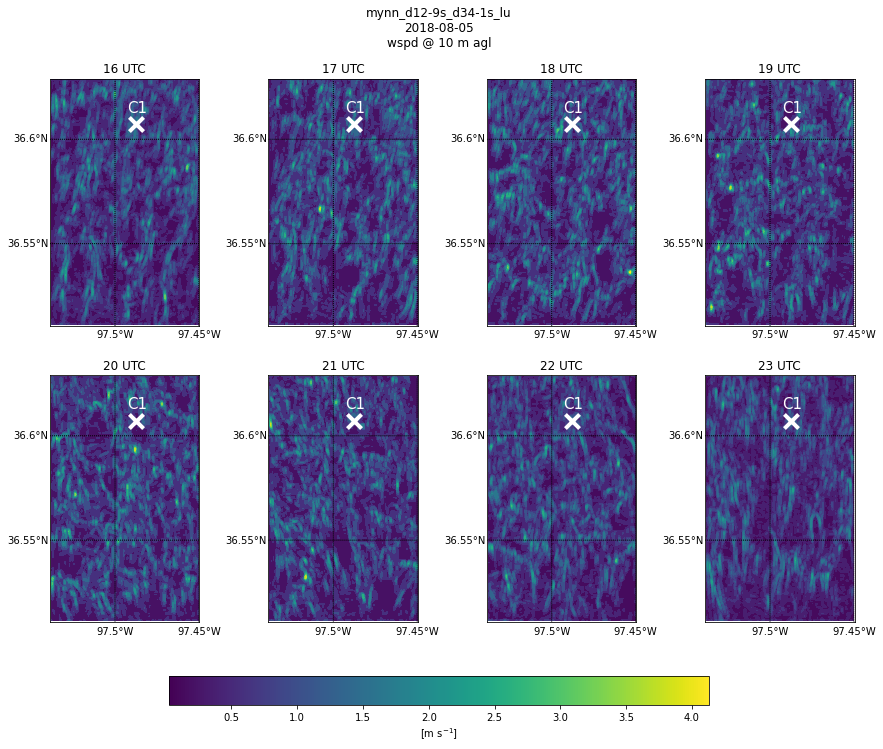

In [451]:
eval_date = '2018-08-05'
run = 'mynn_d12-9s_d34-1s_lu'
wrf_var = 'wspd_wdir10'
plot_var = 'wspd'

# for run in runs_list[:1]:
#     for wrf_var in ['wspd_wdir']:
# plot_8contour_wswd_std(run, wrf_var, 'wspd')
#         plot_8contour_wswd(run, wrf_var, 'wdir')

date_col = data_dir_df[eval_date]

for ind, hr in enumerate(np.arange(16, 24, 1)): 

    file = wrf_runs_dir+date_col[run]+'/auxout/mmc_d04_'+eval_date+'_'+str(hr)+':00:00'
    wrf_single = Dataset(file, 'r')

    var = wrf.getvar(wrf_single, wrf_var, timeidx=wrf.ALL_TIMES)

    if wrf_var == 'wspd_wdir':
        # ~ hub height
        height = wrf.getvar(wrf_single, 'height_agl').mean(dim=['south_north', 'west_east'])[16]
        # missing QVAPOR -- cannot use this
        # wrf.vinterp(wrf_single, var_u, vert_coord='ght_agl', interp_levels=[80])
        height_str = str(int(height.values))
        var = var.isel(bottom_top=16)
    if wrf_var == 'wspd_wdir10':
        height_str = '10'

    if ind == 0: 
        var_all = var
    else: 
        var_all = xr.concat([var_all, var], dim='Time')

lats, lons = wrf.latlon_coords(var_all)

fig, (axs1, axs2) = plt.subplots(2, 4, figsize=(15, 10))

# time_list = pd.date_range(start=eval_date+'-16', end=eval_date+'-19', periods=4)
time_list = pd.date_range(start=eval_date+'-16', end=eval_date+'-23', periods=8)

var_subset = var_all.sel(Time=time_list, wspd_wdir=plot_var)

var_std = var_subset.copy()
var_std[:] = np.nan

for t, _ in enumerate(time_list): 
    for i in np.arange(2, len(var_subset['south_north'])-1): 
        for j in np.arange(2, len(var_subset['west_east'])-1): 
            var_std[t, i, j] = var_subset[t, i-2:i+2, j-2:j+2].std()

#     print(var_subset)
v_min = var_std.min()
v_max = var_std.max()

for ind, time in enumerate(time_list):

#     print(time)
    var_1time = var_std.sel(Time=time)

    if ind <= 3: 
        axs = axs1
    else: 
        axs = axs2
        ind -= 4

#         var_std = var_1time.copy()

#         var_std[:] = np.nan

#         for i in np.arange(2, len(var_1time['south_north'])-1): 
#             for j in np.arange(2, len(var_1time['west_east'])-1): 
#                 var_std[i, j] = var_1time[i-2:i+2, j-2:j+2].std()

    bm = wrf.get_basemap(var_1time, ax=axs[ind])

    bm.drawparallels(np.arange(36, 37, 0.05), labels=[1, 0, 0, 0])
    bm.drawmeridians(np.arange(-98, -97, 0.05), labels=[0, 0, 0, 1])

    x, y = bm(wrf.to_np(lons), wrf.to_np(lats))

    p = bm.contourf(x, y, wrf.to_np(var_1time), 10, cmap=get_cmap('viridis'), 
                    vmin=v_min, vmax=v_max)

#         print(time.hour, time.minute)
    axs[ind].set_title(str(time.hour)+' UTC')

    c1x, c1y = bm(wrf.to_np(-97.487643), wrf.to_np(36.607322))
    bm.scatter(c1x, c1y, s=200, marker='x', color='white', linewidth=4, ax=axs[ind])

    c1x, c1y = bm(wrf.to_np(-97.493), wrf.to_np(36.613))
    axs[ind].annotate('C1', xy=(c1x, c1y), size=15, color='white')

#     if ind == 3:
#         sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=v_min, vmax=v_max))
#         plt.colorbar(sm, ax=axs[0], orientation='horizontal', pad=0.1)

#     fig.colorbar(p, ax=axs[0])

if plot_var == 'wspd':
    units = r'[m s$^{-1}$]'
if plot_var == 'wdir':
    units = '[deg]'

# plt.subplots_adjust(bottom=0.1)
cax = plt.axes([0.25, 0.01, 0.5, 0.04])
sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=v_min, vmax=v_max))
cb = plt.colorbar(sm, cax=cax, orientation='horizontal', label=units)
#     cb.title('m/s')

plt.suptitle(run+'\n'+eval_date+'\n'+plot_var+' @ '+height_str+' m agl')

# plt.tight_layout()

#     plt.savefig(plots_dir+'/'+eval_date+'_'+plot_var+height_str+'_'+run+'.pdf')

plt.show()